## Instalación de herramientas y environments

In [1]:
#!pip install -U oracle-ads
#!pip install oracle-ads[text]
#!pip install  oracle-ads[notebook,viz,text,bds]
#!pip install oracle-ads --upgrade
#!pip install scikit-learn-extra
#!pip install hdbscan
#!pip install shap
#!conda install oci://service-conda-packs@id19sfcrra6z/service_pack/cpu/Oracle_AutoML_and_Model_Explanation_for_Python_3.8/5.0/automlx_p38_cpu_v5
#!pip install automl

## Importación de Módulos

In [1]:
import automl
from automl import init

init(engine='dask')
init(engine='local', check_deprecation_warnings=False)

[2023-11-27 19:47:24,676] [automl.xengine] Using Dask Execution


<automlx-23.2.2>/automl/interface/default.py:87: AutoMLxDeprecationWarning: engine dask is deprecated and will be removed in version 23.3.0.
<automlx-23.2.2>/automl/interface/default.py:90: AutoMLxDeprecationWarning: engine option dask_scheduler is deprecated and will be removed in version 23.3.0
<automlx-23.2.2>/automl/interface/default.py:92: AutoMLxDeprecationWarning: The default logging strategy for AutoMLx has changed. By default, no logs will be written to a file. To enable logging to file, either provide a path or an appropriately configured custom logger to the logger parameter.


[2023-11-27 19:47:25,633] [automl.interface] Execution engine (local) has already been initialized. Reinitializing!
[2023-11-27 19:47:25,633] [automl.xengine] Local ProcessPool execution (n_jobs=3)


In [2]:
import ads
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, confusion_matrix, make_scorer, f1_score
from sklearn.cluster import KMeans, DBSCAN, AffinityPropagation, AgglomerativeClustering
import hdbscan
from sklearn.ensemble import IsolationForest
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from ads.hpo.search_cv import ADSTuner
from ads.dataset.label_encoder import DataFrameLabelEncoder
from scipy import stats


import joblib

pd.set_option('display.max_columns', None)

In [3]:
from ads.dataset.factory import DatasetFactory
from ads.dataset.dataset_browser import DatasetBrowser
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import RobustScaler
from sklearn.compose import ColumnTransformer

## Pipelines de transformación de Datos

Este código define una serie de funciones y una clase llamada `Pipeline` que encapsula un proceso de transformación de datos. La función `find_outliers_IQR` busca y elimina valores atípicos utilizando el método del Rango Intercuartílico (IQR). La función `isolation_forest_outliers` utiliza un modelo de Isolation Forest para identificar y filtrar los valores atípicos en un conjunto de datos.

La clase `Pipeline` tiene varios métodos de transformación de datos, específicamente diseñados para procesar un conjunto de datos relacionado con telecomunicaciones. Estos métodos realizan operaciones como manipulación de fechas, cálculos de columnas, eliminación de duplicados, encoding de variables categóricas, eliminación de columnas no deseadas y tratamiento de valores atípicos mediante el método IQR. Además, algunos métodos aplican un modelo de Isolation Forest para identificar y eliminar valores atípicos. También hay funciones específicas para trabajar con modelos de K-means y LightGBM, que realizan transformaciones adicionales y asignan clusters a los datos.

In [4]:
def find_outliers_IQR(df):
    q1=df.quantile(0.25)
    q3=df.quantile(0.75)
    IQR=q3-q1
    no_outliers = (df>=(q1-1.5*IQR)) & (df<=(q3+1.5*IQR))
    return no_outliers

def isolation_forest_outliers(df_to_transform, clf, fit=True):
    if fit:
        outlier_labels = clf.fit_predict(df_to_transform)
    else:
        outlier_labels = clf.predict(df_to_transform)
    df_to_transform = df_to_transform[outlier_labels == 1]
    return df_to_transform

class Pipeline:
    def __init__(self):
        self.label_encoder = LabelEncoder()
        self.scaler = MinMaxScaler()
        self.cld = IsolationForest(contamination=0.05, random_state=0)
        return

    def transform_kmeans(self, df, use_ads_transform=False, data_telco_only=False, columns_to_encode=['GENDER', 'EMPLYEE_STATUS', 'MANUFACTURER', 'MODEL', 'STORE'], with_iqr=True):
        print(f"Started transform with {len(df)} samples")
        
        df = df.loc[:,~df.columns.duplicated()].copy()
        
        df['FECHA_ALTA'] = pd.to_datetime(df['FECHA_ALTA'])
        
        df = df.sort_values(by='FECHA_ALTA', ascending=False).drop_duplicates("DNI")
        
        # Calculate columns
        df["MONTO_POSTERIOR"] = df["MONTO_RECARGADO_MES"] + df["MONTO_ANTERIOR"]
        df["SUM_SS_TOTAL"] /= 1000000
        
        df["FECHA_ALTA"] = pd.to_datetime(df["FECHA_ALTA"])

        df['YEAR'] = df['FECHA_ALTA'].dt.year
        df['MONTH'] = df['FECHA_ALTA'].dt.month
        df['DAY'] = df['FECHA_ALTA'].dt.day
        
        # Drop unnecesary columns
        df.drop(["FECHA_ALTA", "SALDO_TOTAL", "SUM_SS_ROAMING"], axis=1, inplace=True)
        
        # Drop columns with unique values
        df.drop(["DNI", "IMEI"], axis=1, inplace=True)
        
        if not data_telco_only:
            # Drop multicolineal columns
            df.drop(["MARITAL_STATUS"], axis=1, inplace=True)

            # Define the new values for the rows that match the condition
            new_values = {
                'STORE': '2476 Kalakaua Ave, Honolulu, HI 96815, United States',
                'LATITTUDE': 21.27465651564084,
                'LONGITUDE': -157.8241205791349
            }

            # Replace rows where store address starts with '2476 Kal'
            df.loc[df["STORE"].str.startswith('2476 Kal'), ['STORE', 'LATITTUDE', 'LONGITUDE']] = new_values.values()
        
        # Data encoding
        self.label_encoder_dict = {}
        for col in columns_to_encode:
            le = LabelEncoder()
            df[col] = le.fit_transform(df[col])
            self.label_encoder_dict[col] = le
        
        # Make all columns uppercase
        df.columns = [x.upper() for x in df.columns]
        
        # Use ADS DataFactory to make recommended transforms
        if use_ads_transform:
            """
            ds = DatasetFactory.from_dataframe(df, target='FLAG_CLIENTE_ACTIVO')
            ds = ds.auto_transform()
            df = ds.to_pandas()
            print(df.columns)
            """
            df = df[['MONTO_ANTERIOR', 'MONTO_POSTERIOR', 'FLAG_CLIENTE_ACTIVO',
                    'FLAG_CON_SALDO', 'SUM_CANTIDAD_RECARGAS', 'SUM_MONTO_RECARGAS',
                    'DIAS_FRECUENCIA_RECARGA', 'SUM_SS_TRAFICO_IVR',
                    'SUM_ESC_TRAFICO_LOCAL_VOZ', 'SUM_ESC_TRAFICO_INTERNACIONAL_VOZ',
                    'SUM_ESC_TRAFICO_IVR_VOZ', 'SUM_ESC_ROAMING_ENTRANTE_VOZ',
                    'SUM_ESC_ROAMING_SALIENTE_VOZ', 'SUM_ESC_FAMILIA_Y_AMIGOS_VOZ', 'STORE',
                    'LATITTUDE', 'LONGITUDE', 'AGE', 'GENDER', 'EMPLYEE_STATUS',
                    'MANUFACTURER', 'MODEL', 'YEAR', 'MONTH', 'DAY',
            ]]
        
        df = df[(df["DIAS_FRECUENCIA_RECARGA"] != 9999)]
        
        if with_iqr:
            for col_name in df.columns:
                if df.quantile(0.75)[col_name] > 0 or col_name == "FLAG_CLIENTE_ACTIVO":
                    df = df[find_outliers_IQR(df[col_name])]
        else:
            return df

        X = df.drop(['STORE','LATITTUDE', 'LONGITUDE', 'AGE', 
                      'GENDER', 'EMPLYEE_STATUS', 'MANUFACTURER', 
                      'MODEL', 'YEAR', 'MONTH', 'DAY', 'MONTO_ANTERIOR', 'FLAG_CON_SALDO'], axis=1)
        X = X.drop("FLAG_CLIENTE_ACTIVO", axis=1)
        y = df["FLAG_CLIENTE_ACTIVO"]

        col_names = X.columns
        X = self.scaler.fit_transform(X)
        X = pd.DataFrame(X)
        X.columns = col_names
        
        print(f"Finished transform with {len(df)} samples")
        return df, X, y
    
    def transform_sample_kmeans(self, df, use_ads_transform=False, data_telco_only=False, columns_to_encode=['GENDER', 'EMPLYEE_STATUS', 'MANUFACTURER', 'MODEL', 'STORE'], for_lgbm=False):
        print(f"Started transform with {len(df)} samples")
        
        df = df.loc[:,~df.columns.duplicated()].copy()
        
        df['FECHA_ALTA'] = pd.to_datetime(df['FECHA_ALTA'])
        
        df = df.sort_values(by='FECHA_ALTA', ascending=False).drop_duplicates("DNI")
        
        # Calculate columns
        df["MONTO_POSTERIOR"] = df["MONTO_RECARGADO_MES"] + df["MONTO_ANTERIOR"]
        df["SUM_SS_TOTAL"] /= 1000000
        
        df["FECHA_ALTA"] = pd.to_datetime(df["FECHA_ALTA"])

        df['YEAR'] = df['FECHA_ALTA'].dt.year
        df['MONTH'] = df['FECHA_ALTA'].dt.month
        df['DAY'] = df['FECHA_ALTA'].dt.day
        
        # Drop unnecesary columns
        df.drop(["FECHA_ALTA", "SALDO_TOTAL", "SUM_SS_ROAMING"], axis=1, inplace=True)
        
        # Drop columns with unique values
        df.drop(["DNI", "IMEI"], axis=1, inplace=True)
        
        if not data_telco_only:
            # Drop multicolineal columns
            df.drop(["MARITAL_STATUS"], axis=1, inplace=True)

            # Define the new values for the rows that match the condition
            new_values = {
                'STORE': '2476 Kalakaua Ave, Honolulu, HI 96815, United States',
                'LATITTUDE': 21.27465651564084,
                'LONGITUDE': -157.8241205791349
            }

            # Replace rows where store address starts with '2476 Kal'
            df.loc[df["STORE"].str.startswith('2476 Kal'), ['STORE', 'LATITTUDE', 'LONGITUDE']] = new_values.values()
        # Data encoding
        # print("OVER HERE")
        for col in columns_to_encode:
            df[col] = self.label_encoder_dict[col].transform(df[col])
        # print("IN HERE")
            
        # Make all columns uppercase
        df.columns = [x.upper() for x in df.columns]
        
        # Use ADS DataFactory to make recommended transforms
        if use_ads_transform:
            df = df[['MONTO_ANTERIOR', 'MONTO_POSTERIOR', 'FLAG_CLIENTE_ACTIVO',
                    'FLAG_CON_SALDO', 'SUM_CANTIDAD_RECARGAS', 'SUM_MONTO_RECARGAS',
                    'DIAS_FRECUENCIA_RECARGA', 'SUM_SS_TRAFICO_IVR',
                    'SUM_ESC_TRAFICO_LOCAL_VOZ', 'SUM_ESC_TRAFICO_INTERNACIONAL_VOZ',
                    'SUM_ESC_TRAFICO_IVR_VOZ', 'SUM_ESC_ROAMING_ENTRANTE_VOZ',
                    'SUM_ESC_ROAMING_SALIENTE_VOZ', 'SUM_ESC_FAMILIA_Y_AMIGOS_VOZ', 'STORE',
                    'LATITTUDE', 'LONGITUDE', 'AGE', 'GENDER', 'EMPLYEE_STATUS',
                    'MANUFACTURER', 'MODEL', 'YEAR', 'MONTH', 'DAY',
            ]]
        
        df = df[(df["DIAS_FRECUENCIA_RECARGA"] != 9999)]
        
        if for_lgbm:
            return df

        X = df.drop(['STORE','LATITTUDE', 'LONGITUDE', 'AGE', 
                      'GENDER', 'EMPLYEE_STATUS', 'MANUFACTURER', 
                      'MODEL', 'YEAR', 'MONTH', 'DAY', 'MONTO_ANTERIOR', 'FLAG_CON_SALDO'], axis=1)
        
        X = X.drop("FLAG_CLIENTE_ACTIVO", axis=1)
        y = df["FLAG_CLIENTE_ACTIVO"]
        
        col_names = X.columns
        X = self.scaler.transform(X)
        X = pd.DataFrame(X)
        X.columns = col_names
        
        print(f"Finished transform with {len(df)} samples")
        return df, X, y
    
    def transform_lgbm(self, df, kmeans):
        df = self.transform_sample_kmeans(df, use_ads_transform=True, for_lgbm=True)

        df = isolation_forest_outliers(df, self.cld)

        df_kmeans = df.drop(["FLAG_CLIENTE_ACTIVO", 'STORE','LATITTUDE', 'LONGITUDE', 'AGE', 'GENDER', 'EMPLYEE_STATUS', 'MANUFACTURER','MODEL', 'YEAR', 'MONTH', 'DAY', 'MONTO_ANTERIOR', 'FLAG_CON_SALDO'], axis=1)
        col_names = df_kmeans.columns
        df_kmeans = self.scaler.transform(df_kmeans)
        df_kmeans = pd.DataFrame(df_kmeans)
        df_kmeans.columns = col_names
        
        kmeans_clusters = kmeans.predict(df_kmeans)
        df["KMEANS_CLUSTERS"] = kmeans_clusters
        
        X = df.drop("FLAG_CLIENTE_ACTIVO", axis=1)
        y = df["FLAG_CLIENTE_ACTIVO"]

        self.Rscaler = RobustScaler()
        col_names = X.columns
        indexes = X.index
        X = self.Rscaler.fit_transform(X)
        X = pd.DataFrame(X, index=indexes, columns=col_names)
        
        print(f"Finished transform with {len(df)} samples")
        return df, X, y, df_kmeans
    
    def transform_sample_lgbm(self, df, kmeans):
        df = self.transform_sample_kmeans(df, use_ads_transform=True, for_lgbm=True)

        df_kmeans = df.drop(["FLAG_CLIENTE_ACTIVO", 'STORE','LATITTUDE', 'LONGITUDE', 'AGE', 'GENDER', 'EMPLYEE_STATUS', 'MANUFACTURER','MODEL', 'YEAR', 'MONTH', 'DAY', 'MONTO_ANTERIOR', 'FLAG_CON_SALDO'], axis=1)
        col_names = df_kmeans.columns
        print(df_kmeans)
        df_kmeans = self.scaler.transform(df_kmeans)
        df_kmeans = pd.DataFrame(df_kmeans)
        df_kmeans.columns = col_names
        
        kmeans_clusters = kmeans.predict(df_kmeans)
        df["KMEANS_CLUSTERS"] = kmeans_clusters
        
        X = df.drop("FLAG_CLIENTE_ACTIVO", axis=1)
        y = df["FLAG_CLIENTE_ACTIVO"]

        col_names = X.columns
        indexes = X.index
        X = self.Rscaler.transform(X)
        X = pd.DataFrame(X, index=indexes, columns=col_names)
        
        print(f"Finished transform with {len(df)} samples")
        return df, X, y, df_kmeans

## Conexión a Base de Datos

Se establece una conexión a la base de datos mediante el uso de parámetros de conexión, donde se especifican el nombre de usuario, la contraseña, el nombre del servicio y la ubicación del archivo de billetera. Posteriormente, se realiza una consulta SQL utilizando la biblioteca pandas, que combina datos de varias tablas, incluyendo DATA_TELCO, STORES, DATA_CLIENTES y DATA_IMEI, mediante operaciones LEFT JOIN utilizando la columna DNI como clave. La consulta selecciona todas las columnas de las tablas involucradas y ordena los resultados según la columna FECHA_ALTA. Los resultados de la consulta se almacenan en un DataFrame llamado `raw_df` y posteriormente se crea otro DataFrame llamado `df` que contiene los mismos datos que `raw_df`.

In [5]:
connection_parameters = {
    "user_name": "ADMIN",
    "password": "AndromedaRocks23",
    "service_name": "churntelcodb_medium",
    "wallet_location": "wallet.zip",
}

raw_df = pd.DataFrame.ads.read_sql(
    """SELECT *
        FROM DATA_TELCO DT
        LEFT JOIN STORES ST
        ON DT.DNI = ST.DNI
        LEFT JOIN DATA_CLIENTES DC
        ON DT.DNI = DC.DNI
        LEFT JOIN DATA_IMEI DI
        ON DT.DNI = DI.DNI
        ORDER BY FECHA_ALTA """,
    connection_parameters=connection_parameters,
)
df = raw_df

In [6]:
raw_df.head()

,FECHA_ALTA,CANTIDAD_RECARGAS_MES,MONTO_RECARGADO_MES,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,SALDO_TOTAL,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,AVG_CANTIDAD_RECARGAS,AVG_MONTO_RECARGAS,MIN_CANTIDAD_RECARGAS,MIN_MONTO_RECARGAS,MAX_CANTIDAD_RECARGAS,MAX_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_LOCAL_ONNET,SUM_SS_TRAFICO_LOCAL_OFFNET,SUM_SS_TRAFICO_LOCAL,SUM_SS_TRAFICO_INTERNACIONAL,SUM_SS_TRAFICO_IVR,SUM_SE_ROAMING,SUM_SS_ROAMING,SUM_SS_TOTAL,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,DNI,DNI,STORE,LATITTUDE,LONGITUDE,DNI,AGE,GENDER,EMPLYEE_STATUS,MARITAL_STATUS,DNI,IMEI,MANUFACTURER,MODEL
0,2011-09-27 16:39:00,1,37,19,0,1,0,1,4,82,1.00,21,1,7,1,37,42.000000,74,3879,3953,252,62,0,0,4267,69,8,9,0,0,0,GM89521685,GM89521685,"1540 2nd St, Santa Monica, CA 90405, United States",34.012219,-118.494540,GM89521685,32,FEMALE,employee,Widow,GM89521685,116595400,Nec America,USB316
1,2011-10-17 10:04:00,8,41,71,0,1,23,1,33,188,8.25,47,6,35,10,71,5.825000,0,5402,5402,0,61,0,0,5463,51,0,38,0,0,0,SZ22334694,SZ22334694,"210 5th S, Salt Lake City, UT 84106, United States",40.759057,-111.897383,SZ22334694,70,MALE,self-employed,Married,SZ22334694,110791900,Sharp,Wireless CPU Q2687
2,2011-11-05 11:50:00,1,7,0,0,0,6,1,3,17,1.50,8,1,7,2,9,24.500000,0,325,325,0,0,0,0,325,6,0,6,0,0,0,MP85582568,MP85582568,"72-69 Kissena Blvd, Queens, NY 11367, United States",40.727401,-73.812460,MP85582568,37,FEMALE,employee,Widow,MP85582568,35242705,Mitsubishi,G410
3,2011-11-07 21:44:00,1,2,0,0,0,0,1,3,7,1.00,2,1,2,1,4,16.714286,18,381,399,0,36,0,0,435,46,0,21,0,0,0,YV81359217,YV81359217,"5920 Balboa Ave, San Diego, CA 92111, United States",32.820654,-117.178011,YV81359217,53,FEMALE,employee,Widow,YV81359217,125549800,Wavecom,Ovation MC547
4,2011-11-07 21:47:00,1,4,4,0,1,7,1,9,22,2.25,6,1,4,6,11,15.600000,329,4348,4677,0,0,0,0,4677,110,0,24,0,0,0,WF45775407,WF45775407,"429 7th Ave, New York, NY 10001, United States",40.750506,-73.990583,WF45775407,27,MALE,self-employed,Married,WF45775407,122005600,Casio Hitachi Mobile,GX


## Preprocesamiento de los Datos

Para garantizar la integridad de los datos y evitar redundancias, se procede a eliminar las columnas duplicadas de DNI provenientes de la base de datos. Utilizando la función `loc` de pandas, se seleccionan todas las columnas del DataFrame `df` que no están duplicadas y se crea una copia del DataFrame resultante. Esto asegura que cada entrada única de DNI se mantenga una sola vez en el conjunto de datos, proporcionando así un marco de trabajo más limpio y eficiente para el análisis subsiguiente.

In [7]:
df = df.loc[:,~df.columns.duplicated()].copy()

In [8]:
# Convert the date column to a datetime type
df['FECHA_ALTA'] = pd.to_datetime(df['FECHA_ALTA'])

Se identificó una minoría de datos duplicados, por lo que se procedió a eliminar las repeticiones.

In [9]:
len(df)

383099

In [10]:
# Drop older values
df = df.sort_values(by='FECHA_ALTA', ascending=False).drop_duplicates("DNI")
len(df)

371589

Se ha calculado una característica (*feature*) sugerida por los socios, denominada "MONTO POSTERIOR", la cual se determina mediante el siguiente cálculo:

In [11]:
# Calculate monto_posterior (monto_recargado_mes + monto_anterior)
df["MONTO_POSTERIOR"] = df["MONTO_RECARGADO_MES"] + df["MONTO_ANTERIOR"]

Se ha resuelto un problema de codificación en el conjunto de datos y se realizaron correcciones manuales.

Además, se definieron nuevos valores para las filas que cumplen con cierta condición. Estos valores, especificados en el diccionario `new_values`, incluyen una dirección de tienda, una latitud y una longitud. Luego, se reemplazaron las filas cuya dirección de tienda comienza con '2476 Kal' por estos nuevos valores en las columnas correspondientes ("STORE", "LATITTUDE", "LONGITUDE") del DataFrame `df`.

In [12]:
# Define the new values for the rows that match the condition
new_values = {
    'STORE': '2476 Kalakaua Ave, Honolulu, HI 96815, United States',
    'LATITTUDE': 21.27465651564084,
    'LONGITUDE': -157.8241205791349
}

# Replace rows where store address starts with '2476 Kal'
df.loc[df["STORE"].str.startswith('2476 Kal'), ['STORE', 'LATITTUDE', 'LONGITUDE']] = new_values.values()

Se realizó la conversión de esta columna, de kilobytes a gigabytes.

In [13]:
df["SUM_SS_TOTAL"] /= 1000000

Se utilizó el módulo de ciencia de datos de Oracle llamado "Oracle Accelerated Data Science" para realizar una revisión inicial de nuestro conjunto de datos y explorar posibles enfoques para su procesamiento.

Mediante las funciones proporcionadas por el módulo, se creó un objeto `Dataset` a partir del DataFrame existente (`df`), estableciendo la variable objetivo como "FLAG_CLIENTE_ACTIVO". Posteriormente, se visualizó la información del conjunto de datos en un entorno de cuaderno (*notebook*) mediante `ads_ds.show_in_notebook()`. Además, se accedió a las recomendaciones generadas por el módulo a través de `ads_ds.get_recommendations()`, lo que proporciona orientación sobre posibles transformaciones y mejoras para optimizar el análisis y modelado de los datos.

In [14]:
from ads.dataset.factory import DatasetFactory
from ads.dataset.dataset_browser import DatasetBrowser

ads_ds = DatasetFactory.from_dataframe(df, target='FLAG_CLIENTE_ACTIVO')
ads_ds.show_in_notebook()
ads_ds.get_recommendations()

loop1:   0%|          | 0/4 [00:00<?, ?it/s]

Accordion(children=(HTML(value='<h1>Name: User Provided DataFrame</h1><h3>Type: BinaryClassificationDataset</h…

Output()

Se observa una significativa multicolinealidad entre varios de nuestros atributos. Este fenómeno puede impactar el rendimiento de nuestras predicciones. Hemos implementado una selección de atributos, tomando como referencia el reporte generado por ADS y considerando la mencionada multicolinealidad. Este proceso busca mejorar la calidad de nuestro conjunto de datos, optimizando así el desempeño de las predicciones.

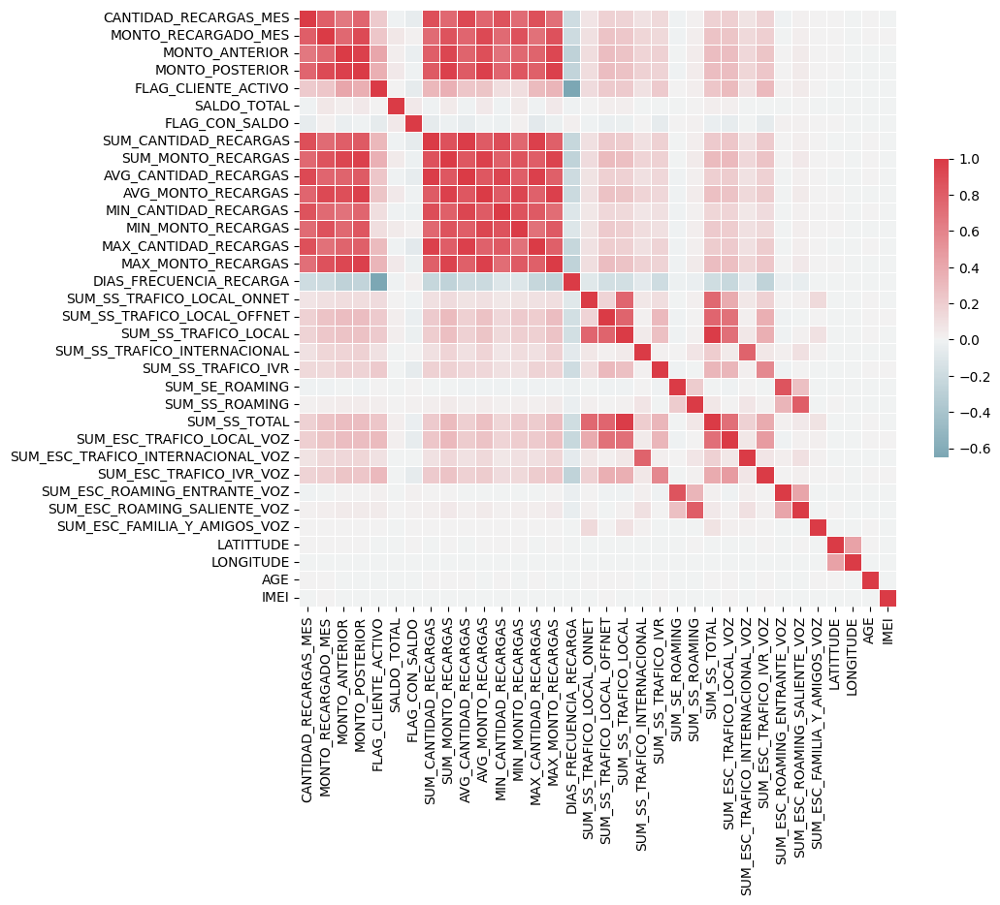

In [15]:
corr_matrix = df.corr()
f, ax = plt.subplots(figsize=(10, 8))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(corr_matrix, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.show()

La línea de código `corr_matrix["FLAG_CLIENTE_ACTIVO"].sort_values(ascending=False)` se utiliza para obtener la correlación de la variable objetivo "FLAG_CLIENTE_ACTIVO" con todas las demás variables del conjunto de datos, y luego ordenar estos resultados en orden descendente. En este contexto, `corr_matrix` probablemente es una matriz de correlación previamente calculada para todas las variables del conjunto de datos. La expresión entre corchetes `["FLAG_CLIENTE_ACTIVO"]` selecciona la columna que corresponde a la variable objetivo, y `sort_values(ascending=False)` ordena los valores de correlación de mayor a menor. Esto proporciona una visión rápida de la fuerza y dirección de la relación lineal entre la variable objetivo y las demás variables, siendo útil para identificar posibles predictores importantes en un análisis de regresión o clasificación.


In [16]:
corr_matrix["FLAG_CLIENTE_ACTIVO"].sort_values(ascending=False)  

FLAG_CLIENTE_ACTIVO                  1.000000
MONTO_ANTERIOR                       0.413802
MONTO_POSTERIOR                      0.364679
SUM_MONTO_RECARGAS                   0.354289
MAX_MONTO_RECARGAS                   0.334064
SUM_CANTIDAD_RECARGAS                0.312291
SUM_ESC_TRAFICO_IVR_VOZ              0.307958
MAX_CANTIDAD_RECARGAS                0.304010
SUM_ESC_TRAFICO_LOCAL_VOZ            0.297920
AVG_MONTO_RECARGAS                   0.252587
SUM_SS_TOTAL                         0.239266
MONTO_RECARGADO_MES                  0.236776
AVG_CANTIDAD_RECARGAS                0.233960
SUM_SS_TRAFICO_LOCAL                 0.220251
CANTIDAD_RECARGAS_MES                0.218890
SUM_SS_TRAFICO_LOCAL_OFFNET          0.216771
SUM_SS_TRAFICO_IVR                   0.213160
SUM_SS_TRAFICO_LOCAL_ONNET           0.117928
MIN_MONTO_RECARGAS                   0.108551
MIN_CANTIDAD_RECARGAS                0.107225
SUM_SS_TRAFICO_INTERNACIONAL         0.090423
SUM_ESC_TRAFICO_INTERNACIONAL_VOZ 

Utilizamos la funcionalidad de "auto transform" de Oracle para llevar a cabo la selección automática de características.

Mediante la llamada `ads_ds.auto_transform()`, el conjunto de datos original representado por `ads_ds` experimenta una serie de transformaciones automáticas recomendadas por la herramienta Oracle Accelerated Data Science. Estas transformaciones pueden incluir la eliminación de características redundantes, la imputación de valores faltantes, la codificación de variables categóricas, entre otros procesos.

Posteriormente, se invoca `transformed_ds.visualize_transforms()` para visualizar las transformaciones realizadas en el conjunto de datos transformado. Esto proporciona una comprensión visual de cómo se han modificado las características y cómo estas modificaciones pueden afectar el conjunto de datos en términos de calidad y relevancia para el análisis predictivo.

In [17]:
transformed_ds = ads_ds.auto_transform()

loop1:   0%|          | 0/7 [00:00<?, ?it/s]

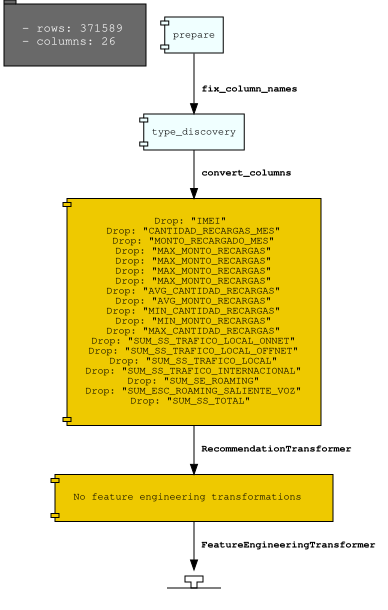

In [18]:
transformed_ds.visualize_transforms()

## Encoding
En la sección de "Encoding", se implementa el proceso de codificación de etiquetas (*label encoding*) para permitir el manejo de atributos categóricos en el conjunto de datos. Después de aplicar transformaciones automáticas con Oracle, el DataFrame resultante (`transformed_ds`) se convierte a un formato de pandas (`df`). Luego, se utiliza la clase `LabelEncoder` para codificar de manera numérica las columnas categóricas relevantes, como "GENDER", "EMPLYEE_STATUS", "MARITAL_STATUS", "MANUFACTURER", "MODEL", y "STORE". Cada columna se transforma individualmente y se asignan los resultados a sus respectivas columnas en el conjunto de datos `ds`. Finalmente, se eliminan algunas columnas, como "MARITAL_STATUS" y "DNI", para simplificar el conjunto de datos resultante.

In [19]:
df = transformed_ds.to_pandas()

label_encoder = LabelEncoder()
ds_encoded = DataFrameLabelEncoder().fit_transform(pd.DataFrame(transformed_ds["GENDER"]))
ds = transformed_ds.assign_column("GENDER", ds_encoded["GENDER"])
ds_encoded = DataFrameLabelEncoder().fit_transform(pd.DataFrame(ds["EMPLYEE_STATUS"]))
ds = ds.assign_column("EMPLYEE_STATUS", ds_encoded["EMPLYEE_STATUS"])
ds_encoded = DataFrameLabelEncoder().fit_transform(pd.DataFrame(ds["MARITAL_STATUS"]))
ds = ds.assign_column("MARITAL_STATUS", ds_encoded["MARITAL_STATUS"])
ds_encoded = DataFrameLabelEncoder().fit_transform(pd.DataFrame(ds["MANUFACTURER"]))
ds = ds.assign_column("MANUFACTURER", ds_encoded["MANUFACTURER"])
ds_encoded = DataFrameLabelEncoder().fit_transform(pd.DataFrame(ds["MODEL"]))
ds = ds.assign_column("MODEL", ds_encoded["MODEL"])
ds_encoded = DataFrameLabelEncoder().fit_transform(pd.DataFrame(ds["STORE"]))
ds = ds.assign_column("STORE", ds_encoded["STORE"])

ds = ds.drop(["MARITAL_STATUS", "DNI"], axis=1)
# ds = ds.drop(["EMPLYEE_STATUS", "MARITAL_STATUS", "GENDER", "MALE", "DNI"], axis=1)

In [20]:
ds

FLAG_CLIENTE_ACTIVO,FECHA_ALTA,MONTO_ANTERIOR,MONTO_POSTERIOR,SALDO_TOTAL,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_SS_ROAMING,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,STORE
0,2023-03-31 23:39:00,0,7,15,1,1,7,9999.000000,0,0,0,0,0,0,0,40.727401,-73.812460,76,1,1,29,39,35
0,2023-03-31 23:17:00,0,4,5,1,1,4,9999.000000,0,0,0,0,0,0,0,32.744596,-96.812286,51,0,1,4,11,30
0,2023-03-31 23:09:00,0,2,2,1,1,2,9999.000000,0,0,0,0,0,0,0,28.333508,-81.513738,43,0,1,31,35,27
0,2023-03-31 23:05:00,0,4,10,1,1,4,9999.000000,0,0,0,0,1,0,0,28.333508,-81.513738,30,0,2,5,31,27
0,2023-03-31 23:05:00,0,7,17,1,1,7,9999.000000,0,0,0,0,0,0,0,39.852059,-74.981099,38,0,1,25,33,34


BinaryClassificationDataset(target: FLAG_CLIENTE_ACTIVO) 371,589 rows, 24 columns

Se realiza la descomposición de la columna de fechas ("FECHA_ALTA") en componentes individuales (año, mes y día) con el objetivo de tratar las fechas como atributos adicionales y explorar patrones específicos de comportamiento. Primero, el DataFrame `ds` se convierte a un formato de pandas (`df`). Luego, la columna de fechas se convierte al formato de fecha con `pd.to_datetime(df["FECHA_ALTA"])`. Posteriormente, se crean tres nuevas columnas, "YEAR", "MONTH" y "DAY", en las cuales se almacenan respectivamente el año, el mes y el día extraídos de la columna "FECHA_ALTA". Esta descomposición facilita el análisis de tendencias y comportamientos a lo largo del tiempo en el conjunto de datos.

In [21]:
df = ds.to_pandas()
df["FECHA_ALTA"] = pd.to_datetime(df["FECHA_ALTA"])

df['YEAR'] = df['FECHA_ALTA'].dt.year
df['MONTH'] = df['FECHA_ALTA'].dt.month
df['DAY'] = df['FECHA_ALTA'].dt.day

Siguiendo las indicaciones de los socios formadores, se procedió a eliminar las columnas especificadas del DataFrame `df`. Las columnas descartadas son "FECHA_ALTA", "SALDO_TOTAL" y "SUM_SS_ROAMING". Además, se estandarizaron los nombres de las columnas convirtiéndolos a mayúsculas mediante la expresión `df.columns = [x.upper() for x in df.columns]`. Este proceso de eliminación y estandarización busca simplificar y preparar el conjunto de datos para análisis posterior.

In [22]:
df = df.drop(["FECHA_ALTA", "SALDO_TOTAL", "SUM_SS_ROAMING"], axis=1)

In [23]:
df.columns = [x.upper() for x in df.columns]

Detectamos un comportamiento inusual en el atributo "DIAS_FRECUENCIA_RECARGA". Al explorar su distribución, observamos la siguiente representación visual mediante un gráfico de densidad kernel (KDE) utilizando la biblioteca Seaborn: `sns.displot(data=df, x="DIAS_FRECUENCIA_RECARGA", kind="kde")`. Este análisis permite visualizar la forma y la densidad de la distribución de valores del atributo, identificando posibles patrones o anomalías en la variable "DIAS_FRECUENCIA_RECARGA".

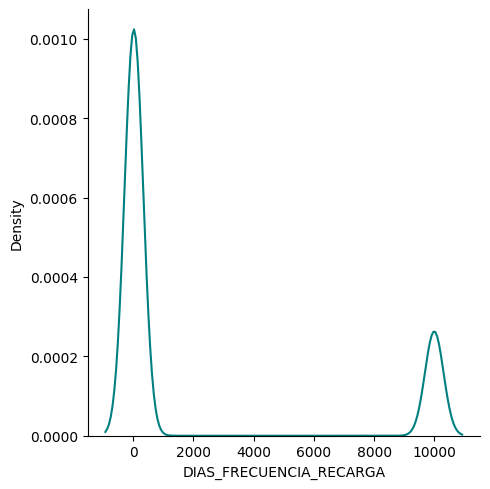

In [24]:
sns.displot(data=df, x="DIAS_FRECUENCIA_RECARGA", kind="kde")

In [25]:
df[(df["DIAS_FRECUENCIA_RECARGA"] < 300)].describe()

,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,STORE,YEAR,MONTH,DAY
count,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.00000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000
mean,20.253956,37.867216,0.779399,0.933669,13.513137,64.624893,20.539939,551.262737,103.639432,3.684884,67.319628,1.508429,0.004708,35.125952,-92.423026,49.963884,0.500804,0.99881,19.479502,19.502481,19.490807,2020.690761,6.373130,15.823647
std,32.903282,51.911833,0.414653,0.248861,23.013570,94.810055,24.978525,1245.245275,194.348574,23.484045,107.012599,18.524252,0.577007,5.612598,20.345766,17.604501,0.500000,0.81610,11.550312,11.556754,11.539640,2.261968,3.808303,8.752161
min,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,21.274657,-157.824121,20.000000,0.000000,0.00000,0.000000,0.000000,0.000000,2011.000000,1.000000,1.000000
25%,4.000000,11.000000,1.000000,1.000000,5.000000,22.000000,7.483871,42.000000,9.000000,0.000000,12.000000,0.000000,0.000000,30.460718,-115.175822,35.000000,0.000000,0.00000,9.000000,9.000000,9.000000,2020.000000,3.000000,8.000000
50%,13.000000,26.000000,1.000000,1.000000,10.000000,46.000000,12.210526,202.000000,39.000000,0.000000,38.000000,0.000000,0.000000,34.152507,-81.471414,50.000000,1.000000,1.00000,19.000000,19.000000,19.000000,2022.000000,6.000000,16.000000
75%,30.000000,52.000000,1.000000,1.000000,17.000000,87.000000,23.000000,594.000000,116.000000,0.000000,84.000000,0.000000,0.000000,40.727401,-74.161475,65.000000,1.000000,2.00000,29.000000,30.000000,29.000000,2022.000000,10.000000,23.000000
max,11371.000000,18765.000000,1.000000,1.000000,8930.000000,37573.000000,242.000000,153270.000000,9478.000000,2434.000000,10536.000000,2144.000000,121.000000,44.981410,-73.459820,80.000000,1.000000,2.00000,39.000000,39.000000,39.000000,2023.000000,12.000000,31.000000


In [26]:
df[(df["DIAS_FRECUENCIA_RECARGA"] > 300)].describe()

,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,STORE,YEAR,MONTH,DAY
count,75711.0,75711.000000,75711.0,75711.000000,75711.000000,75711.000000,75711.0,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000,75711.000000
mean,0.0,7.242316,0.0,0.943152,1.399334,7.242316,9999.0,21.890346,2.371597,0.116852,2.084096,0.067956,0.000145,35.140240,-92.401331,49.922600,0.500654,0.999141,19.507443,19.491791,19.551915,2022.981192,3.022850,16.833327
std,0.0,9.855531,0.0,0.231553,1.287589,9.855531,0.0,152.419422,8.764564,1.159133,8.001084,4.352970,0.014075,5.601935,20.302811,17.575598,0.500003,0.816413,11.529572,11.545396,11.538412,0.228738,0.706747,9.112879
min,0.0,0.000000,0.0,0.000000,1.000000,0.000000,9999.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,21.274657,-157.824121,20.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2012.000000,1.000000,1.000000
25%,0.0,4.000000,0.0,1.000000,1.000000,4.000000,9999.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,30.460718,-115.175822,35.000000,0.000000,0.000000,9.000000,10.000000,10.000000,2023.000000,3.000000,9.000000
50%,0.0,4.000000,0.0,1.000000,1.000000,4.000000,9999.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,34.152507,-81.471414,50.000000,1.000000,1.000000,20.000000,19.000000,20.000000,2023.000000,3.000000,17.000000
75%,0.0,4.000000,0.0,1.000000,1.000000,4.000000,9999.0,4.000000,1.000000,0.000000,1.000000,0.000000,0.000000,40.718838,-74.161475,65.000000,1.000000,2.000000,29.000000,29.000000,30.000000,2023.000000,3.000000,25.000000
max,0.0,299.000000,0.0,1.000000,40.000000,299.000000,9999.0,28285.000000,355.000000,65.000000,839.000000,771.000000,2.000000,44.981410,-73.459820,80.000000,1.000000,2.000000,39.000000,39.000000,39.000000,2023.000000,12.000000,31.000000


Al comparar las métricas de ambos segmentos, identificamos que el segmento de datos más grande, compuesto por valores de 9999 en el atributo "DIAS_FRECUENCIA_RECARGA", afecta negativamente tanto al modelo de predicción como al modelo de clasificación. Esto se debe a una correlación notable entre el objetivo y el atributo cuando tiene este valor, y tenemos motivos para creer que esta correlación es resultado de un defecto en nuestro conjunto de datos. Estas razones incluyen la fecha en la que estos datos se encuentran, siendo en su mayoría del mes más reciente. Con base en esto, hemos decidido eliminar este subconjunto de datos durante el entrenamiento de nuestros modelos, como se representa en el gráfico de densidad kernel (KDE) utilizando Seaborn: `sns.displot(data=df[(df["DIAS_FRECUENCIA_RECARGA"] < 300)], x="DIAS_FRECUENCIA_RECARGA", kind="kde")`.

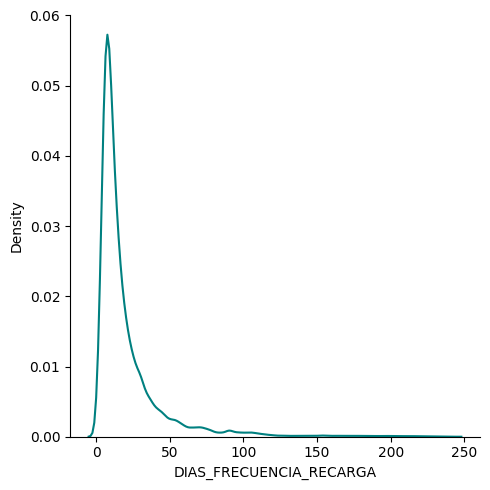

In [27]:
sns.displot(data=df[(df["DIAS_FRECUENCIA_RECARGA"] < 300)], x="DIAS_FRECUENCIA_RECARGA", kind="kde")

Se crea un nuevo DataFrame llamado `df_outliers` que contiene la columna específica "DIAS_FRECUENCIA_RECARGA" para realizar operaciones sobre esa columna en particular. Luego, se identifican los índices de las filas que tienen el valor 9999 en la columna "DIAS_FRECUENCIA_RECARGA" y se almacenan en la variable `index_to_drop`. Posteriormente, se procede a eliminar las filas correspondientes a estos índices del DataFrame original `df` mediante `df.drop(index_to_drop, inplace=True)`. Este proceso tiene como objetivo eliminar las instancias que contienen el valor 9999 en la columna mencionada, como parte del tratamiento de datos para mejorar la calidad del conjunto de datos.


In [28]:
df_outliers = df['DIAS_FRECUENCIA_RECARGA']
index_to_drop = df[(df['DIAS_FRECUENCIA_RECARGA'] == 9999)].index
df.drop(index_to_drop, inplace=True)

In [29]:
df.describe()

,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,STORE,YEAR,MONTH,DAY
count,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.00000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000,295878.000000
mean,20.253956,37.867216,0.779399,0.933669,13.513137,64.624893,20.539939,551.262737,103.639432,3.684884,67.319628,1.508429,0.004708,35.125952,-92.423026,49.963884,0.500804,0.99881,19.479502,19.502481,19.490807,2020.690761,6.373130,15.823647
std,32.903282,51.911833,0.414653,0.248861,23.013570,94.810055,24.978525,1245.245275,194.348574,23.484045,107.012599,18.524252,0.577007,5.612598,20.345766,17.604501,0.500000,0.81610,11.550312,11.556754,11.539640,2.261968,3.808303,8.752161
min,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,21.274657,-157.824121,20.000000,0.000000,0.00000,0.000000,0.000000,0.000000,2011.000000,1.000000,1.000000
25%,4.000000,11.000000,1.000000,1.000000,5.000000,22.000000,7.483871,42.000000,9.000000,0.000000,12.000000,0.000000,0.000000,30.460718,-115.175822,35.000000,0.000000,0.00000,9.000000,9.000000,9.000000,2020.000000,3.000000,8.000000
50%,13.000000,26.000000,1.000000,1.000000,10.000000,46.000000,12.210526,202.000000,39.000000,0.000000,38.000000,0.000000,0.000000,34.152507,-81.471414,50.000000,1.000000,1.00000,19.000000,19.000000,19.000000,2022.000000,6.000000,16.000000
75%,30.000000,52.000000,1.000000,1.000000,17.000000,87.000000,23.000000,594.000000,116.000000,0.000000,84.000000,0.000000,0.000000,40.727401,-74.161475,65.000000,1.000000,2.00000,29.000000,30.000000,29.000000,2022.000000,10.000000,23.000000
max,11371.000000,18765.000000,1.000000,1.000000,8930.000000,37573.000000,242.000000,153270.000000,9478.000000,2434.000000,10536.000000,2144.000000,121.000000,44.981410,-73.459820,80.000000,1.000000,2.00000,39.000000,39.000000,39.000000,2023.000000,12.000000,31.000000


Basándonos en el análisis de las características, especialmente en el comportamiento sintético de las características categóricas, hemos seleccionado un conjunto de características numéricas para utilizar en nuestro modelo de K-means. Este conjunto de características se representa en la lista `k_means_cols` e incluye:

In [30]:
k_means_cols = ['MONTO_ANTERIOR', 'MONTO_POSTERIOR', 'FLAG_CLIENTE_ACTIVO', 'SUM_CANTIDAD_RECARGAS', 'SUM_MONTO_RECARGAS',
                'DIAS_FRECUENCIA_RECARGA', 'SUM_SS_TRAFICO_IVR', 'SUM_ESC_TRAFICO_LOCAL_VOZ', 'SUM_ESC_TRAFICO_INTERNACIONAL_VOZ',
                'SUM_ESC_TRAFICO_IVR_VOZ', 'SUM_ESC_ROAMING_ENTRANTE_VOZ', 'SUM_ESC_FAMILIA_Y_AMIGOS_VOZ']

### Pipeline en Funcionamiento

De esta manera, todo el procesamiento anterior se ha implementado en la clase "Pipeline" con el objetivo de automatizar el procesamiento de los datos. Se instancia la clase con `pipeline = Pipeline()`, y luego se aplica la transformación específica para el modelo de K-means utilizando la función `transform_kmeans` sobre el DataFrame original `raw_df`. La opción `use_ads_transform=True` indica la utilización de transformaciones recomendadas por Oracle Accelerated Data Science. Posteriormente, se filtran las filas donde la columna "DIAS_FRECUENCIA_RECARGA" tiene el valor 9999 mediante `df = df[(df["DIAS_FRECUENCIA_RECARGA"] != 9999)]`.

In [31]:
pipeline = Pipeline()

In [32]:
df, _, _ = pipeline.transform_kmeans(raw_df, use_ads_transform=True)

Started transform with 383099 samples
Finished transform with 135856 samples


In [33]:
df = df[(df["DIAS_FRECUENCIA_RECARGA"] != 9999)]

In [34]:
df.describe()

,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,STORE,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,YEAR,MONTH,DAY
count,135856.000000,135856.000000,135856.0,135856.0,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000,135856.000000
mean,19.306251,34.744001,1.0,1.0,11.850430,58.016657,14.041086,277.317181,59.393623,3.351799,44.639751,1.520426,0.732835,0.002046,19.478249,35.127878,-92.418035,49.929801,0.502002,1.000184,19.495363,19.506514,2020.788283,6.268402,15.996931
std,14.087503,21.108139,0.0,0.0,6.669915,35.279455,7.501686,310.624108,63.279182,16.214384,37.015655,19.139960,7.425369,0.275126,11.539098,5.615922,20.360071,17.615868,0.499998,0.815752,11.555727,11.535020,1.981942,3.881744,8.726757
min,0.000000,0.000000,1.0,1.0,2.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,21.274657,-157.824121,20.000000,0.000000,0.000000,0.000000,0.000000,2015.000000,1.000000,1.000000
25%,7.000000,18.000000,1.0,1.0,7.000000,30.000000,8.222222,47.000000,11.000000,0.000000,15.000000,0.000000,0.000000,0.000000,9.000000,30.460718,-115.175822,35.000000,0.000000,0.000000,9.000000,10.000000,2020.000000,2.000000,8.000000
50%,15.000000,30.000000,1.0,1.0,10.000000,50.000000,12.000000,165.000000,36.000000,0.000000,36.000000,0.000000,0.000000,0.000000,19.000000,34.152507,-81.471414,50.000000,1.000000,1.000000,19.000000,19.000000,2021.000000,6.000000,16.000000
75%,28.000000,48.000000,1.0,1.0,16.000000,78.000000,18.307692,400.000000,87.000000,0.000000,66.000000,0.000000,0.000000,0.000000,29.000000,40.727401,-74.981099,65.000000,1.000000,2.000000,30.000000,30.000000,2022.000000,10.000000,23.000000
max,69.000000,101.000000,1.0,1.0,34.000000,170.000000,35.500000,1507.000000,276.000000,1442.000000,158.000000,2144.000000,405.000000,78.000000,39.000000,44.981410,-73.459820,80.000000,1.000000,2.000000,39.000000,39.000000,2023.000000,12.000000,31.000000


In [35]:
df.columns

Index(['MONTO_ANTERIOR', 'MONTO_POSTERIOR', 'FLAG_CLIENTE_ACTIVO',
       'FLAG_CON_SALDO', 'SUM_CANTIDAD_RECARGAS', 'SUM_MONTO_RECARGAS',
       'DIAS_FRECUENCIA_RECARGA', 'SUM_SS_TRAFICO_IVR',
       'SUM_ESC_TRAFICO_LOCAL_VOZ', 'SUM_ESC_TRAFICO_INTERNACIONAL_VOZ',
       'SUM_ESC_TRAFICO_IVR_VOZ', 'SUM_ESC_ROAMING_ENTRANTE_VOZ',
       'SUM_ESC_ROAMING_SALIENTE_VOZ', 'SUM_ESC_FAMILIA_Y_AMIGOS_VOZ', 'STORE',
       'LATITTUDE', 'LONGITUDE', 'AGE', 'GENDER', 'EMPLYEE_STATUS',
       'MANUFACTURER', 'MODEL', 'YEAR', 'MONTH', 'DAY'],
      dtype='object')

In [36]:
raw_df["FECHA_ALTA"] = pd.to_datetime(raw_df["FECHA_ALTA"])

Este grafico muestra una distribución muy parecida a "dias frecuencia recarga", poro no muestra el comportamiento anomalo de "dias frequencia recarga".

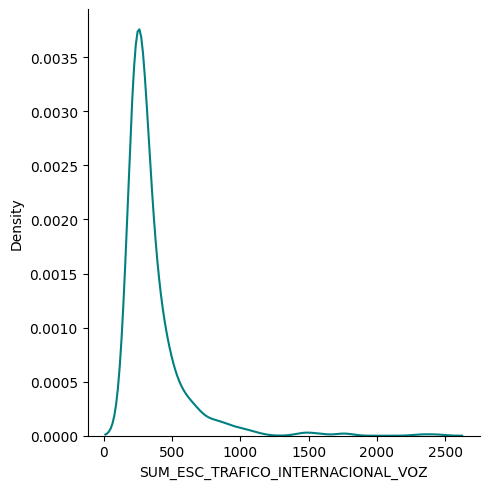

In [37]:
sns.displot(data=raw_df[(raw_df["SUM_ESC_TRAFICO_INTERNACIONAL_VOZ"] > 200)], x="SUM_ESC_TRAFICO_INTERNACIONAL_VOZ", kind="kde")

### Outliers

Al trabajar en la clusterización de usuarios, nos enfrentamos a la dificultad de interpretar distribuciones debido a la presencia de outliers que trivializaban la clusterización. Para abordar este problema, implementamos un método más robusto para eliminar estas trivializaciones. Decidimos descartar aquellas muestras que estuvieran fuera del rango definido por el método del rango intercuartílico (IQR), el cual se encuentra en la siguiente función:

```python
def find_outliers_IQR(df):
    q1=df.quantile(0.25)
    q3=df.quantile(0.75)
    IQR=q3-q1
    no_outliers = (df>=(q1-1.5*IQR)) & (df<=(q3+1.5*IQR))
    return no_outliers
```
Se aplicó este método a cada columna del conjunto de datos, eliminando así aquellos samples que se encontraban fuera de los límites establecidos por el IQR. Aunque esto resultó en la disminución significativa de muestras, permitió identificar rangos más claros que facilitaron la interpretación de distribuciones en el proceso de clusterización.

In [38]:
for col_name in df.columns:
    if df.quantile(0.75)[col_name] > 0 or col_name == "FLAG_CLIENTE_ACTIVO":
        df = df[find_outliers_IQR(df[col_name])]
len(df)

106051

In [39]:
df.describe()

,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,STORE,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,YEAR,MONTH,DAY
count,106051.000000,106051.000000,106051.0,106051.0,106051.000000,106051.000000,106051.000000,106051.000000,106051.000000,106051.000000,106051.00000,106051.000000,106051.000000,106051.000000,106051.000000,106051.000000,106051.000000,106051.000000,106051.000000,106051.000000,106051.000000,106051.000000,106051.00000,106051.000000,106051.000000
mean,17.804255,32.369153,1.0,1.0,10.939124,52.944593,14.365277,207.321129,45.606199,3.119386,37.56932,1.602427,0.715675,0.001480,19.481646,35.119187,-92.490233,49.926648,0.502041,1.001688,19.488765,19.484408,2021.10940,6.154690,16.039085
std,12.698098,18.961805,0.0,0.0,5.922002,31.039925,7.292048,215.619962,46.690599,15.183928,30.79255,20.616882,7.451580,0.196738,11.550816,5.610288,20.381979,17.624734,0.499998,0.815345,11.555932,11.534095,1.64766,3.923348,8.694903
min,0.000000,0.000000,1.0,1.0,2.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,21.274657,-157.824121,20.000000,0.000000,0.000000,0.000000,0.000000,2017.00000,1.000000,1.000000
25%,7.000000,17.000000,1.0,1.0,6.000000,28.000000,8.607143,37.000000,9.000000,0.000000,12.00000,0.000000,0.000000,0.000000,9.000000,30.460718,-115.175822,35.000000,0.000000,0.000000,9.000000,9.000000,2020.00000,2.000000,9.000000
50%,15.000000,29.000000,1.0,1.0,10.000000,47.000000,12.500000,130.000000,29.000000,0.000000,30.00000,0.000000,0.000000,0.000000,19.000000,34.056593,-81.471414,50.000000,1.000000,1.000000,19.000000,19.000000,2022.00000,6.000000,16.000000
75%,26.000000,45.000000,1.0,1.0,15.000000,73.000000,18.875000,314.000000,69.000000,0.000000,56.00000,0.000000,0.000000,0.000000,29.000000,40.718838,-74.981099,65.000000,1.000000,2.000000,30.000000,30.000000,2022.00000,10.000000,23.000000
max,59.000000,90.000000,1.0,1.0,29.000000,142.000000,33.833333,926.000000,192.000000,1442.000000,128.00000,2144.000000,405.000000,42.000000,39.000000,44.981410,-73.459820,80.000000,1.000000,2.000000,39.000000,39.000000,2023.00000,12.000000,31.000000


### Eliminación de Atributos Categóricos con Comportamiento Sintético

Con el objetivo de simplificar el conjunto de datos y eliminar atributos categóricos que presentaban comportamientos sintéticos o no aportaban significativamente al análisis, se eliminaron las siguientes columnas del DataFrame `df`: 'STORE', 'LATITTUDE', 'LONGITUDE', 'AGE', 'GENDER', 'EMPLYEE_STATUS', 'MANUFACTURER', 'MODEL', 'YEAR', 'MONTH', 'DAY', 'MONTO_ANTERIOR', y 'FLAG_CON_SALDO'. Esta acción busca mejorar la calidad y la interpretación de los datos para procesos posteriores.


In [40]:
df = df.drop(['STORE','LATITTUDE', 'LONGITUDE', 'AGE', 
              'GENDER', 'EMPLYEE_STATUS', 'MANUFACTURER', 
              'MODEL', 'YEAR', 'MONTH', 'DAY', 'MONTO_ANTERIOR', 'FLAG_CON_SALDO'], axis=1)

Nos quedamos con las siguientes features.

In [41]:
df.columns

Index(['MONTO_POSTERIOR', 'FLAG_CLIENTE_ACTIVO', 'SUM_CANTIDAD_RECARGAS',
       'SUM_MONTO_RECARGAS', 'DIAS_FRECUENCIA_RECARGA', 'SUM_SS_TRAFICO_IVR',
       'SUM_ESC_TRAFICO_LOCAL_VOZ', 'SUM_ESC_TRAFICO_INTERNACIONAL_VOZ',
       'SUM_ESC_TRAFICO_IVR_VOZ', 'SUM_ESC_ROAMING_ENTRANTE_VOZ',
       'SUM_ESC_ROAMING_SALIENTE_VOZ', 'SUM_ESC_FAMILIA_Y_AMIGOS_VOZ'],
      dtype='object')

### Escalamiento

Optamos por aplicar el escalado a las características utilizando el escalador "Min-Max" (MinMaxScaler). Esta elección se fundamenta en el hecho de que previamente utilizamos el método de IQR para tratar outliers, y de esta manera, los valores mínimos y máximos resultantes se encuentran dentro de una distribución más aceptable. Se realiza el escalado de las características del conjunto de datos, representadas por la matriz `X`, excluyendo la columna objetivo "FLAG_CLIENTE_ACTIVO". Posteriormente, se divide el conjunto de datos escalado en conjuntos de entrenamiento (`X_train`, `y_train`) y prueba (`X_test`, `y_test`) utilizando la función `train_test_split` con una proporción del 70% para entrenamiento.


In [42]:
X = df.drop("FLAG_CLIENTE_ACTIVO", axis=1)
y = df["FLAG_CLIENTE_ACTIVO"]

In [43]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
col_names = X.columns
X = scaler.fit_transform(X)
X = pd.DataFrame(X)
X.columns = col_names

In [44]:
X_train, X_test, y_train, y_test = train_test_split(X, y,train_size=0.7,random_state=0)

In [45]:
X.describe()["SUM_SS_TRAFICO_IVR"]

count    106051.000000
mean          0.223889
std           0.232851
min           0.000000
25%           0.039957
50%           0.140389
75%           0.339093
max           1.000000
Name: SUM_SS_TRAFICO_IVR, dtype: float64

## Aplicación Final de Preprocesamiento

En esta etapa, se utiliza el pipeline para iniciar la implementación del modelo de clustering. Se instancia la clase `Pipeline()` y se aplica la función `transform_kmeans` sobre el DataFrame original `raw_df` con la opción `use_ads_transform=True`, indicando la utilización de transformaciones recomendadas por Oracle Accelerated Data Science.

Este proceso inicia con 383099 muestras y finaliza con 135856 muestras después de aplicar las transformaciones y el tratamiento de datos definidos en el pipeline.

In [46]:
pipeline = Pipeline()
df, X, y = pipeline.transform_kmeans(raw_df, use_ads_transform=True)

Started transform with 383099 samples
Finished transform with 135856 samples


In [47]:
label_encoders = pipeline.label_encoder_dict

In [48]:
label_encoder_info = {}

for label, encoder in label_encoders.items():
    label_encoder_info[label] = {
        'labels': encoder.classes_.tolist(),
        'numbers': encoder.transform(encoder.classes_).tolist()
    }

print(label_encoder_info)

{'GENDER': {'labels': ['FEMALE', 'MALE'], 'numbers': [0, 1]}, 'EMPLYEE_STATUS': {'labels': ['Unemployment', 'employee', 'self-employed'], 'numbers': [0, 1, 2]}, 'MANUFACTURER': {'labels': ['Accetioinc', 'Benefon Oyj', 'Casio Hitachi Mobile', 'Compal Com Inc', 'Danger Inc', 'Enfora', 'Intel', 'Intermec Technologies Corp', 'Lg', 'Matsushita', 'Mirae Comm Co', 'Mitsubishi', 'Motorola', 'Nec America', 'Nokia', 'Nortel', 'Novatel Wireless Inc', 'Option International', 'Panasonic', 'Philips', 'Powerloc Technologies Inc', 'Psion Teklogix Inc', 'Quanta Computerinc', 'Research In Motion', 'Sagem', 'Samsung', 'Sanyo', 'Sendo Ltd', 'Sharp', 'Shintom Coltd', 'Siemens', 'Sierra Wireless', 'Sony', 'Sony Ericsson', 'Tct Mobile Suzhou', 'Telular Corp', 'Thales E-Transactions Gmbh', 'Toshiba', 'Trimble', 'Wavecom'], 'numbers': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39]}, 'MODEL': {'labels': ['100

In [49]:
X.columns

Index(['MONTO_POSTERIOR', 'SUM_CANTIDAD_RECARGAS', 'SUM_MONTO_RECARGAS',
       'DIAS_FRECUENCIA_RECARGA', 'SUM_SS_TRAFICO_IVR',
       'SUM_ESC_TRAFICO_LOCAL_VOZ', 'SUM_ESC_TRAFICO_INTERNACIONAL_VOZ',
       'SUM_ESC_TRAFICO_IVR_VOZ', 'SUM_ESC_ROAMING_ENTRANTE_VOZ',
       'SUM_ESC_ROAMING_SALIENTE_VOZ', 'SUM_ESC_FAMILIA_Y_AMIGOS_VOZ'],
      dtype='object')

## Clustering

### Multicolinealidad de Características

Con las características seleccionadas después del preprocesamiento, se realiza un análisis de multicolinealidad utilizando el método de Análisis de Componentes Principales (PCA). En el siguiente gráfico, representado por la matriz `PCA_X`, se puede observar cómo hemos logrado captar características representativas y optimizar los modelos. Se excluyen las características "MONTO_POSTERIOR", "SUM_CANTIDAD_RECARGAS", y "SUM_MONTO_RECARGAS" del análisis para centrarnos en otras variables clave.


In [50]:
PCA_X = X.drop(["MONTO_POSTERIOR", "SUM_CANTIDAD_RECARGAS", "SUM_MONTO_RECARGAS"], axis=1)

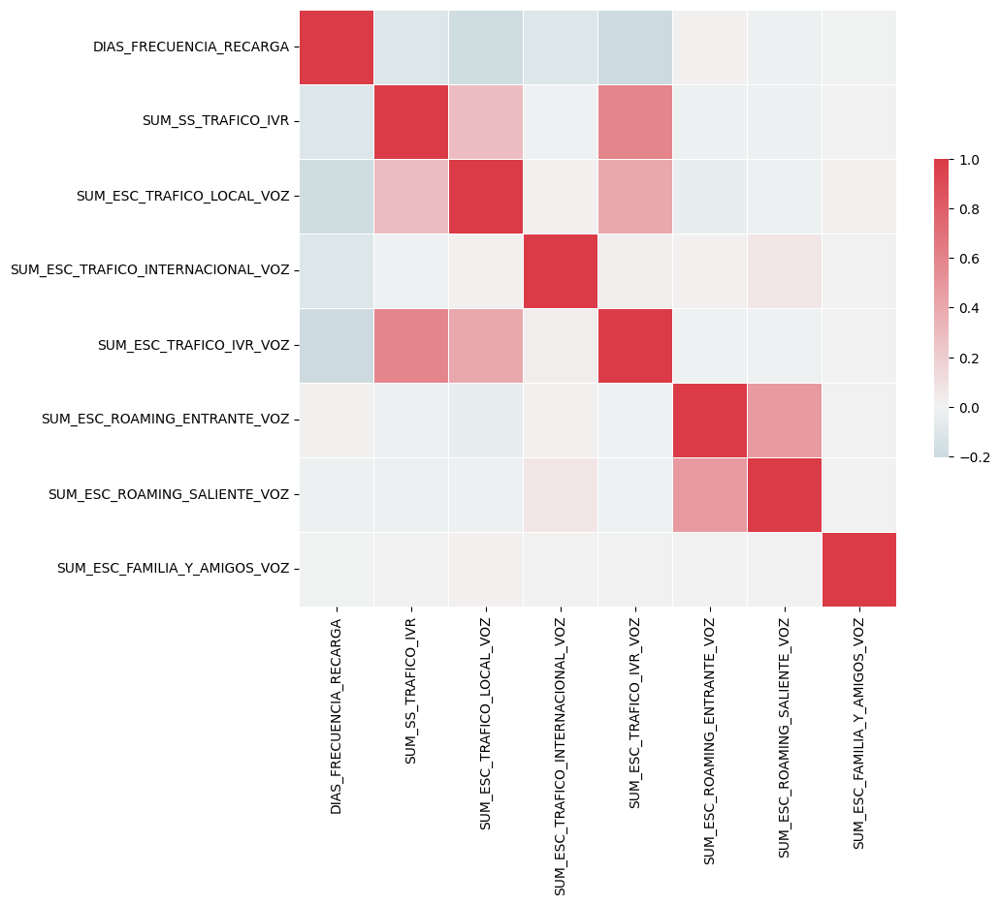

In [51]:
corr_matrix = PCA_X.corr()
f, ax = plt.subplots(figsize=(10, 8))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(corr_matrix, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.show()

### KMeans

En la implementación del algoritmo KMeans, hemos utilizado el método del codo para seleccionar la cantidad óptima de clusters. Específicamente, evaluamos el "Within-Cluster Sum of Squares" (WCSS) para diferentes valores de k en el rango de 1 a 10. El gráfico resultante muestra la relación entre el número de clusters y la suma de cuadrados dentro de los clusters.

Este método nos permite identificar el "codo" en la curva, que representa el punto donde la adición de más clusters no aporta una mejora significativa en la reducción de la suma de cuadrados dentro de los clusters. Este punto es crucial para determinar el número óptimo de clusters a utilizar en el modelo KMeans.

In [52]:
wcss = []
k_range = range(1, 11)
for k in k_range:
    kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=10000, n_init=10, random_state=0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)

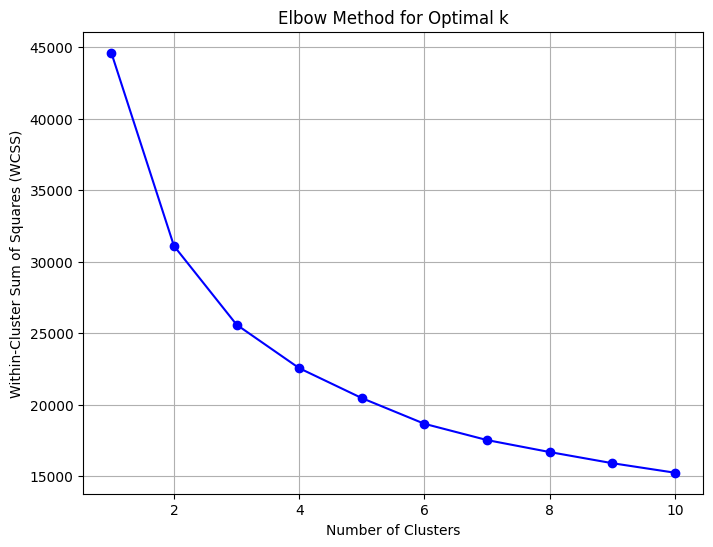

In [53]:
# Plot the WCSS values against the number of clusters
plt.figure(figsize=(8, 6))
plt.plot(k_range, wcss, marker='o', linestyle='-', color='b')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters')
plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
plt.grid(True)
plt.show()

En el análisis del método del codo, identificamos que en el rango de 3 a 5 clusters era la cantidad más óptima. Por lo tanto, decidimos seleccionar 4 clusters para nuestro modelo KMeans. A continuación, se entrena el modelo utilizando esta cantidad de clusters.

Este proceso asigna a cada muestra en el conjunto de datos un cluster correspondiente, permitiendo la segmentación y análisis de patrones dentro de los datos.

In [54]:
kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)
kmeans_clusters = kmeans.fit_predict(X)

In [55]:

single_sample_old = X.iloc[[3442]]

single_sample = raw_df.iloc[[99093]]


In [56]:
rr_def = raw_df.loc[:,~raw_df.columns.duplicated()].copy()
single_sample = rr_def[(rr_def["DNI"] == "CP10809468")]

A continuación se realiza una prueba de pipeline, para calcular la clase a la que pertenece un usuario en especifico.

In [57]:
sample_transform, Xx, Yy = pipeline.transform_sample_kmeans(single_sample, use_ads_transform=True)

kmeans.predict(Xx)

Started transform with 1 samples
Finished transform with 1 samples


array([3], dtype=int32)

Para facilitar la implementación de nuestros modelos en un servidor Flask, exportamos los binarios de los modelos entrenados. En este caso, exportamos el modelo KMeans.

Este archivo binario (kmeans_model.pkl) puede ser utilizado para cargar el modelo entrenado en un entorno de servidor Flask para realizar inferencias sobre nuevos datos.

In [58]:
# Export kmeans cluster
import pickle

with open("output_models/kmeans_model.pkl", "wb") as kmeans_file:
    pickle.dump(kmeans, kmeans_file)

In [59]:
cluster_centers = kmeans.cluster_centers_
cluster_centers

array([[6.27106701e-01, 5.73766226e-01, 6.37385411e-01, 2.02545201e-01,
        1.89576502e-01, 2.68887332e-01, 5.16014029e-03, 3.23341744e-01,
        6.85176250e-04, 2.64243577e-03, 6.45937457e-05],
       [1.69733580e-01, 1.14386334e-01, 1.48930006e-01, 6.55114412e-01,
        1.06776379e-01, 1.14028539e-01, 6.47488735e-04, 1.60557997e-01,
        8.51098566e-04, 1.25347378e-03, 5.16658548e-06],
       [3.05892125e-01, 3.15602128e-01, 3.25305592e-01, 3.42581547e-01,
        4.26217246e-01, 4.26192311e-01, 1.67826601e-03, 5.76466143e-01,
        4.13289944e-04, 1.15787567e-03, 3.06496500e-05],
       [3.21917769e-01, 2.83740572e-01, 2.99893495e-01, 2.97530924e-01,
        9.44739688e-02, 1.32344016e-01, 2.20921180e-03, 1.74009877e-01,
        7.92918676e-04, 2.10110138e-03, 1.55499538e-05]])

## Búsqueda Manual de Importancias de los Clusters

En este paso, asignamos los clusters obtenidos mediante el modelo KMeans a nuestro conjunto de datos. La columna "CLUSTER_KMEANS" se añade tanto al DataFrame original `df` como a la matriz de características escaladas `X`. Esta información de clusterización será crucial para analizar y comprender la distribución de los datos en relación con los clusters generados por el modelo.


In [60]:
X["CLUSTER_KMEANS"] = kmeans_clusters
df["CLUSTER_KMEANS"]= kmeans_clusters

De esta forma, podriamos evaluar cada feature con respecto a la clases de clusterización, pero encontrar diferencias y poder realizar un analisis más global no resulta muy viable.

In [61]:
X[(X["CLUSTER_KMEANS"] == 0)].describe()

,MONTO_POSTERIOR,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,CLUSTER_KMEANS
count,28596.000000,28596.000000,28596.000000,28596.000000,28596.000000,28596.000000,28596.000000,28596.000000,28596.000000,28596.000000,28596.000000,28596.0
mean,0.627019,0.573628,0.637276,0.202636,0.189275,0.268554,0.005159,0.322836,0.000685,0.002645,0.000065,0.0
std,0.161476,0.179579,0.148447,0.098138,0.181061,0.233676,0.018184,0.216758,0.006814,0.024255,0.006753,0.0
min,0.059406,0.031250,0.230769,0.002415,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
25%,0.514851,0.437500,0.526627,0.142698,0.053086,0.083333,0.000000,0.151899,0.000000,0.000000,0.000000,0.0
50%,0.623762,0.562500,0.621302,0.183877,0.136695,0.199275,0.000000,0.291139,0.000000,0.000000,0.000000,0.0
75%,0.742574,0.687500,0.745562,0.235362,0.271400,0.394928,0.000693,0.455696,0.000000,0.000000,0.000000,0.0
max,1.000000,1.000000,1.000000,1.000000,0.998673,1.000000,0.416089,1.000000,0.333489,1.000000,1.000000,0.0


De esta manera, decidimos implementar un método más moderno para analizar las importancias de cada característica para el modelo de clusterización. Este método se llama "SHapley Additive exPlanation" (SHAP). Para esto, fue necesario implementar un modelo supervisado con el cual se pueden obtener las importancias que se le da a cada característica para predecir su clase.

Con este modelo supervisado entrenado, utilizamos la biblioteca SHAP para analizar las importancias de las características y entender cómo cada característica contribuye a la asignación de clusters en el modelo KMeans.

In [62]:
import lightgbm as lgb

In [63]:
X_kmeans = X.drop(["CLUSTER_KMEANS"], axis=1)
y_kmeans = X["CLUSTER_KMEANS"]
X_train_kmeans, X_test_kmeans, y_train_kmeans, y_test_kmeans = train_test_split(X_kmeans, y_kmeans,train_size=0.7,random_state=0)

In [64]:
clf = lgb.LGBMClassifier()
clf.fit(X_train_kmeans, y_train_kmeans)

LGBMClassifier()

In [65]:
y_pred=clf.predict(X_test_kmeans)

In [66]:
# save model for later usage
clf_kmeans = clf

In [67]:
from sklearn.metrics import accuracy_score
accuracy=accuracy_score(y_pred, y_test_kmeans)
print('LightGBM Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test_kmeans, y_pred)))

LightGBM Model accuracy score: 0.9825


In [68]:
clf.booster_.save_model('output_models/explainer_kmeans_model.txt')

In [69]:
import shap
shap.initjs()

In [70]:
with open("saved_samples/sample_kmeans_explainer.pkl", "rb")  as X_sample_file: 
    X_sample = pd.read_pickle(X_sample_file)
with open("saved_samples/shap_values.pkl", "rb")  as X_sample_file: 
    shap_values = pd.read_pickle(X_sample_file)

In [71]:
explainer = shap.Explainer(clf)
#X_sample = X_train_kmeans.sample(10000, random_state=34)
#shap_values = explainer.shap_values(X_sample)

In [72]:
import dill

serialized = dill.dumps(X_sample)
with open("output_models/sample_kmeans_explainer.pkl", "wb") as explainer_sample_file:
    explainer_sample_file.write(serialized)

serialized = dill.dumps(shap_values)
with open("output_models/shap_values.pkl", "wb") as shap_values_file:
    shap_values_file.write(serialized)

Con este modulo, podemos obtener un grafico como el siguiente, en el cual podemos observar las features especificas que permiten predecir si un usuarios pertenece a una clase o no. Esto nos da indicios del comportamiento de los clientes.

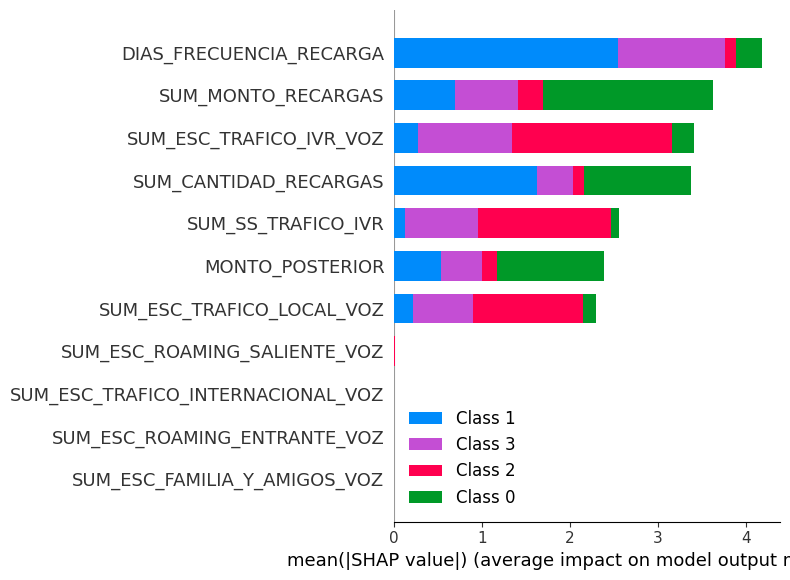

In [73]:
shap.summary_plot(shap_values, X_sample, plot_type="bar", show=False)
plt.savefig("shap_plot.png")
plt.show()

Posteriormente, para cada cluster, podemos obtener si cierta feature necesita ser un valor alto o chicho, para predecir si pertenece a la clase o no.

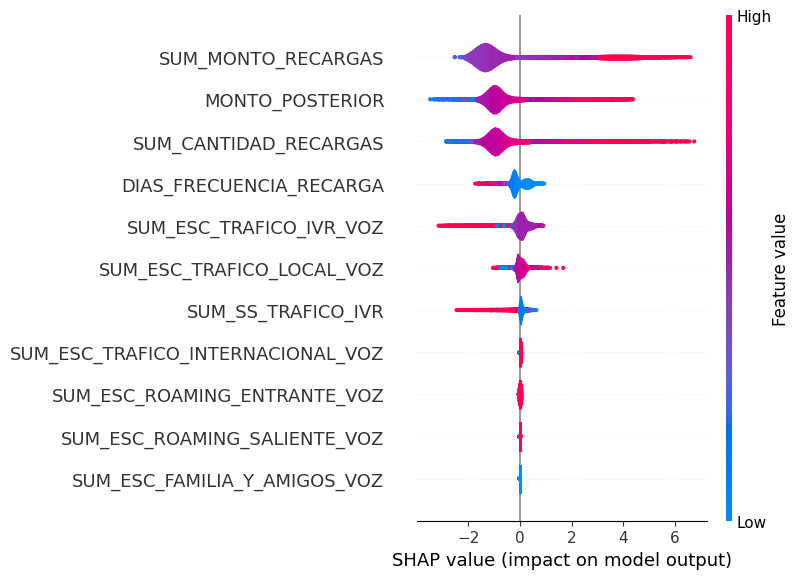

In [74]:
shap.summary_plot(shap_values[0], X_sample, plot_type="violin")

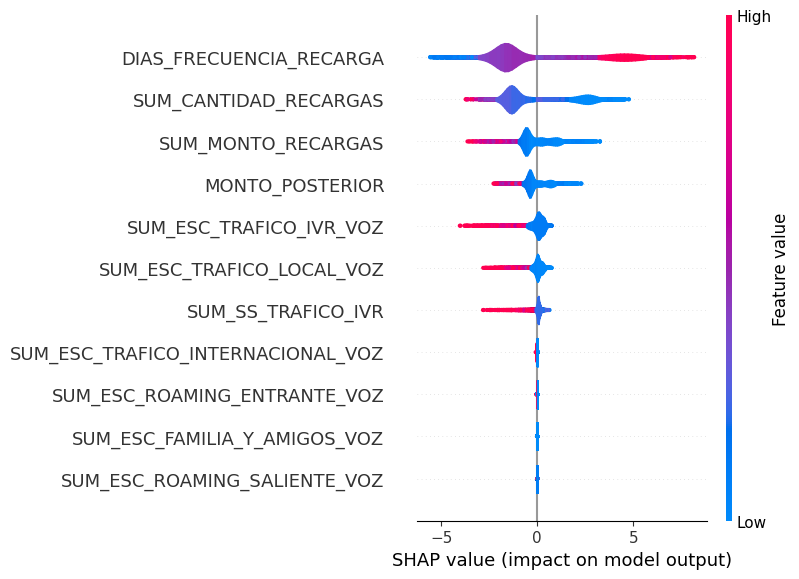

In [75]:
shap.summary_plot(shap_values[1], X_sample, plot_type="violin")

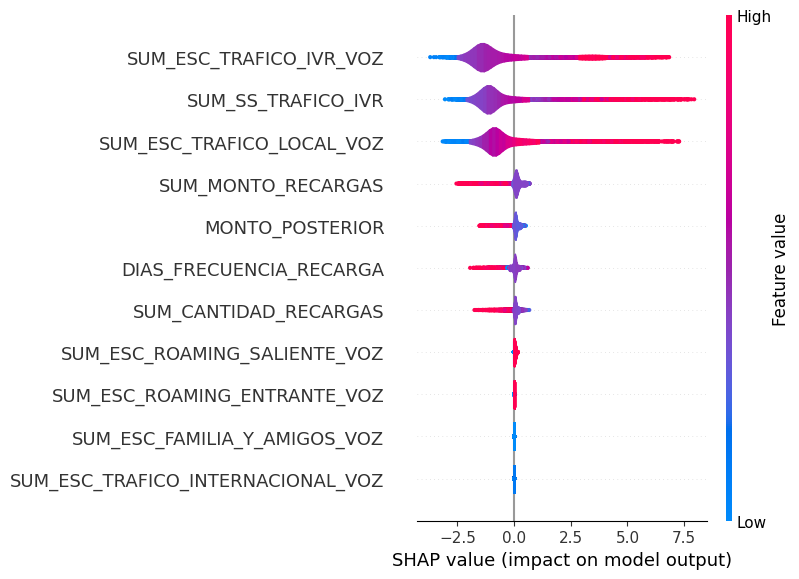

In [76]:
shap.summary_plot(shap_values[2], X_sample, plot_type="violin")

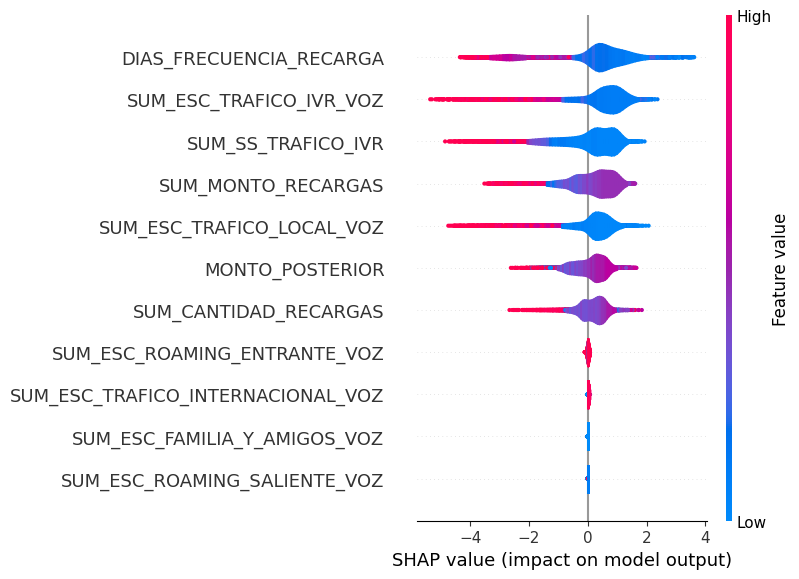

In [77]:
shap.summary_plot(shap_values[3], X_sample, plot_type="violin")

In [78]:
#cluster_class = 2
#shap.force_plot(explainer.expected_value[cluster_class],
#shap_values[cluster_class][0,:], X_sample.iloc[0,:])

Asimismo, en el siguiente gráfico se muestran las distribuciones de los clusters. Como se puede observar, cada clase se separa de manera distinta de las demás distribuciones para cada característica.

Este par de gráficos nos proporciona una visión visual de cómo se distribuyen los clusters en relación con las características seleccionadas, lo que puede ser útil para comprender mejor la segmentación de los datos.

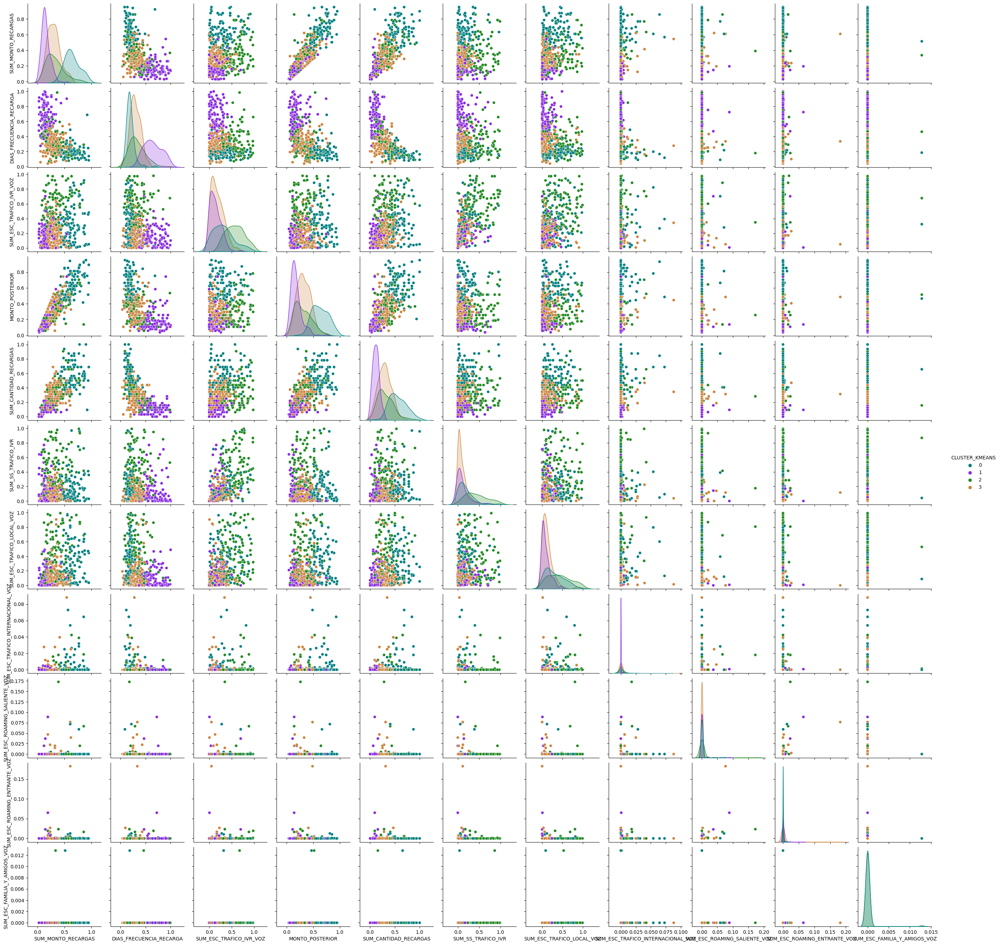

In [79]:
top_columns = pd.DataFrame(cluster_centers, columns=col_names).describe().loc["std"].sort_values(ascending=False).index[:11]
top_columns = [x for x in top_columns]
top_columns.append("CLUSTER_KMEANS")

serialized = dill.dumps(X[top_columns].sample(500))
with open("output_models/kmeans_pairplot_data.pkl", "wb") as pairplot_data_file:
    pairplot_data_file.write(serialized)

sns.pairplot(X[top_columns].sample(500), hue="CLUSTER_KMEANS", diag_kind='kde', palette=sns.color_palette())

In [80]:
X[(X['CLUSTER_KMEANS'] == 3)].describe()

,MONTO_POSTERIOR,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,CLUSTER_KMEANS
count,45368.000000,45368.000000,45368.000000,45368.000000,45368.000000,45368.000000,45368.000000,45368.000000,45368.000000,45368.000000,45368.000000,45368.0
mean,0.321561,0.283476,0.299535,0.297627,0.094521,0.132366,0.002209,0.174138,0.000793,0.002099,0.000016,3.0
std,0.138729,0.135334,0.118894,0.113630,0.104785,0.144379,0.010557,0.131956,0.009289,0.021284,0.001392,0.0
min,0.009901,0.000000,0.017751,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.0
25%,0.217822,0.187500,0.213018,0.216074,0.017916,0.028986,0.000000,0.063291,0.000000,0.000000,0.000000,3.0
50%,0.297030,0.281250,0.289941,0.288475,0.058394,0.083333,0.000000,0.151899,0.000000,0.000000,0.000000,3.0
75%,0.405941,0.375000,0.378698,0.370370,0.136695,0.188406,0.000000,0.259494,0.000000,0.000000,0.000000,3.0
max,0.990099,1.000000,0.988166,0.927536,0.859987,0.996377,1.000000,0.778481,0.500000,0.817284,0.256410,3.0


Aquí se presentan varias funciones útiles para visualizar la distribución de datos por clusters. La función `plot_clusters` muestra un histograma de una columna numérica específica dividida por clusters. `plot_clusters_categorical` se utiliza para columnas categóricas, mostrando histogramas para cada categoría dentro de cada cluster. `plot_clusters_numeric_features`, `plot_clusters_numeric_features_hist` y `plot_clusters_numeric_features_pie` se utilizan para columnas numéricas, mostrando la distribución, histograma y gráfico circular respectivamente. Estas funciones son útiles para explorar y comprender la segmentación realizada por el modelo de clustering.

In [81]:
import matplotlib.pyplot as plt

def plot_clusters(df_t, value_column = "DIAS_FRECUENCIA_RECARGA", save=False, xlimit=None):
    num_clusters = len(df_t['CLUSTER_KMEANS'].unique())

    fig, ax = plt.subplots(1, 1, figsize=(10, 5))
    for cluster in range(num_clusters):
        data_for_cluster = df_t[df_t['CLUSTER_KMEANS'] == cluster]
        ax.hist(data_for_cluster[value_column], bins=20, alpha=0.5, label=f'Cluster {cluster}')
    if xlimit:
        ax.set_xlim(xlimit)

    ax.set_title(f'Distribution of {value_column} per Cluster')
    ax.set_xlabel(f'{value_column}')
    ax.set_ylabel('Frequency')
    ax.legend()
    plt.tight_layout()
    if save:
        plt.savefig(f"static/images/plot_cluster/{value_column}.png")
        plt.close()
    else:
        plt.show()

def plot_clusters_categorical(df_t, value_column="DIAS_FRECUENCIA_RECARGA", categorical_col="GENDER", cluster_col="CLUSTER_KMEANS", save=False):
    unique_clusters = df_t[cluster_col].unique()
    num_clusters = len(unique_clusters)
    
    fig, ax = plt.subplots(num_clusters//2, 2,figsize=(10, 5))
    fig.suptitle(f'Categorical Columns Disitributions per Cluster', fontsize=12)
    clusters_it = 0
    for row in range(num_clusters//2):
        for col in range(2):
            unique_categories = df_t[categorical_col].unique()
            num_categories = len(unique_categories)
            for category in unique_categories:
                data_for_cluster = df_t[(df_t[categorical_col] == category) & (df_t["CLUSTER_KMEANS"] == clusters_it)]
                ax[row, col].hist(data_for_cluster[value_column], bins=20, alpha=0.5, label=f'{categorical_col} {category}')
            ax[row, col].set_title(f'Histograms for Cluster {clusters_it}')
            ax[row, col].set_xlabel(f'X-Axis Label for {value_column}')
            ax[row, col].set_ylabel('Frequency')
            ax[row, col].legend()
            clusters_it += 1
    plt.tight_layout()
    if save:
        plt.savefig(f"static/images/plot_cluster/{value_column}_{categorical_col}.png")
        plt.close()
    else:
        plt.show()

def plot_clusters_numeric_features(df_t, numeric_col="YEAR", cluster_col="CLUSTER_KMEANS", show_freq=True, save=False):
    unique_clusters = df_t[cluster_col].unique()
    num_clusters = len(unique_clusters)
    
    fig, ax = plt.subplots(num_clusters//2, 2,figsize=(10, 5))
    fig.suptitle(f'Frequency {numeric_col} per cluster', fontsize=12)
    clusters_it = 0
    for row in range(num_clusters//2):
        for col in range(2):
            data_for_cluster = df_t[(df_t["CLUSTER_KMEANS"] == clusters_it)]
            bars = ax[row, col].bar(data_for_cluster[numeric_col].value_counts().index, data_for_cluster[numeric_col].value_counts().values)
            ax[row, col].set_title(f'Histograms for Cluster {clusters_it}')
            ax[row, col].set_xlabel(f'X-Axis Label for {numeric_col}')
            ax[row, col].set_ylabel('Frequency')
            if show_freq:
                for bar in bars:
                    yval = bar.get_height()
                    ax[row, col].text(bar.get_x() + bar.get_width() / 2, yval, round(yval, 2), ha='center', va='bottom')
            clusters_it += 1
    plt.tight_layout()
    if save:
        plt.savefig(f"static/images/plot_cluster/{numeric_col}.png")
        plt.close()
    else:
        plt.show()

def plot_clusters_numeric_features_hist(df_t, numeric_col="YEAR", cluster_col="CLUSTER_KMEANS", show_freq=True, save=False):
    unique_clusters = df_t[cluster_col].unique()
    num_clusters = len(unique_clusters)

    fig, ax = plt.subplots(num_clusters // 2, 2, figsize=(10, 5))
    fig.suptitle(f'Frequency {numeric_col} per cluster', fontsize=12)
    clusters_it = 0

    max_frequency = 0 

    for row in range(num_clusters // 2):
        for col in range(2):
            if clusters_it >= num_clusters:
                break

            data_for_cluster = df_t[df_t["CLUSTER_KMEANS"] == clusters_it]
            
            bars = ax[row, col].bar(data_for_cluster[numeric_col].value_counts().index,
                                    data_for_cluster[numeric_col].value_counts().values)
            
            
            ax[row, col].set_title(f'Histograms for Cluster {clusters_it}')
            
            ax[row, col].set_xlabel(f'X-Axis Label for {numeric_col}')
            ax[row, col].set_ylabel('Frequency')
            
            
            max_frequency = max(max_frequency, data_for_cluster[numeric_col].value_counts().max())
            
            if show_freq:
                for bar in bars:
                    yval = bar.get_height()
                    ax[row, col].text(bar.get_x() + bar.get_width() / 2, yval, round(yval, 2), ha='center', va='bottom')

            clusters_it += 1

    for row in ax:
        for col in row:
            col.set_ylim(0, max_frequency + (max_frequency*0.2))

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    if save:
        plt.savefig(f"static/images/plot_cluster/{numeric_col}.png")
        plt.close()
    else:
        plt.show()

def plot_clusters_numeric_features_pie(df_t, numeric_col="YEAR", cluster_col="CLUSTER_KMEANS", show_freq=True, save=False, labels=None):
    unique_clusters = df_t[cluster_col].unique()
    num_clusters = len(unique_clusters)

    fig, ax = plt.subplots(num_clusters // 2, 2, figsize=(10, 5))
    fig.suptitle(f'Pie Chart {numeric_col} per cluster', fontsize=12)
    clusters_it = 0

    max_frequency = 0 

    for row in range(num_clusters // 2):
        for col in range(2):
            if clusters_it >= num_clusters:
                break

            data_for_cluster = df_t[df_t["CLUSTER_KMEANS"] == clusters_it]
            values = data_for_cluster[numeric_col].value_counts().sort_index()
            wedges, texts, autotexts = ax[row, col].pie(values, labels=values.index, autopct='%1.1f%%', startangle=90)
            """
            bars = ax[row, col].pie(data_for_cluster[numeric_col].value_counts().index,
                                    data_for_cluster[numeric_col].value_counts().values)
            """
            ax[row, col].set_title(f'Histograms for Cluster {clusters_it}')
            if labels:
                ax[row, col].legend(wedges, labels, title=f'Cluster {clusters_it}', loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
            else:
                legend_labels = [f"{index} ({count})" for index, count in zip(values.index, values)]
                ax[row, col].legend(wedges, legend_labels, title=f'Cluster {clusters_it}', loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
            
            max_frequency = max(max_frequency, data_for_cluster[numeric_col].value_counts().max())

            clusters_it += 1


    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    if save:
        plt.savefig(f"static/images/plot_cluster/{numeric_col}.png")
        plt.close()
    else:
        plt.show()

In [82]:
serialized = dill.dumps(df)
with open("output_models/dataframe_kmeans_plots.pkl", "wb") as df_kmeans_plots_file:
    df_kmeans_plots_file.write(serialized)

In [83]:
with open("saved_samples/dataframe_kmeans_plots.pkl", "rb")  as df_k_plots_file: 
    df = pd.read_pickle(df_k_plots_file)

En las gráficas siguientes se presenta la distribución de algunas variables por cluster. Se observa que las distribuciones están bastante balanceadas, lo que sugiere que el dataset puede ser sintético. Este equilibrio en las distribuciones es un indicador que respalda la sospecha de la naturaleza artificial del conjunto de datos.

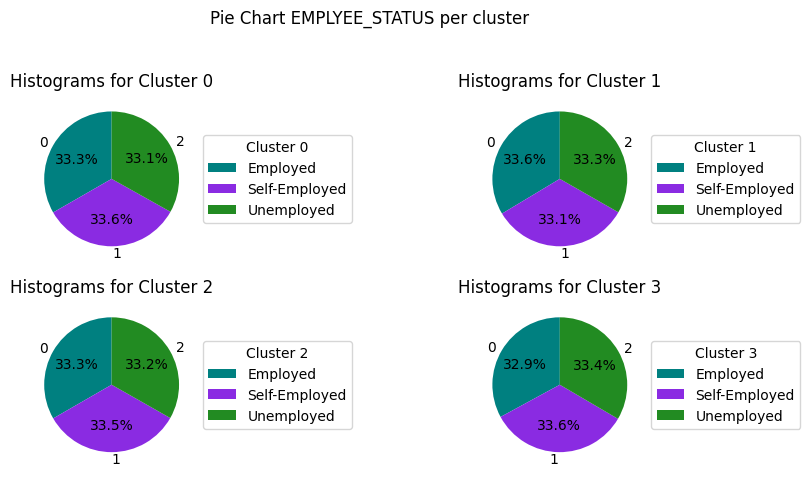

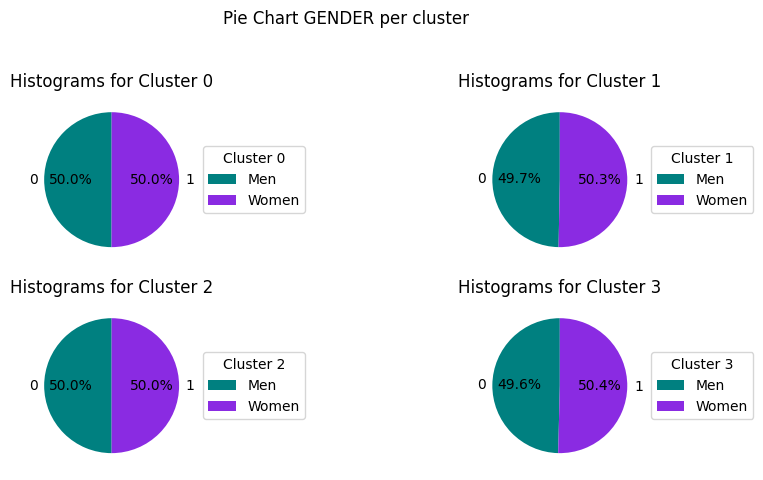

In [84]:
plot_clusters_numeric_features_pie(df, numeric_col='EMPLYEE_STATUS', save=False, labels=['Employed', 'Self-Employed', 'Unemployed'])
plot_clusters_numeric_features_pie(df, numeric_col='GENDER', save=False, labels=['Men', 'Women'])

Asimismo, en el caso de los años, se puede observar una distribución o comportamiento bastante similar entre los diferentes clusters. Esto refuerza la impresión de que la variabilidad en esta variable es limitada entre los distintos grupos identificados por el algoritmo de clustering.

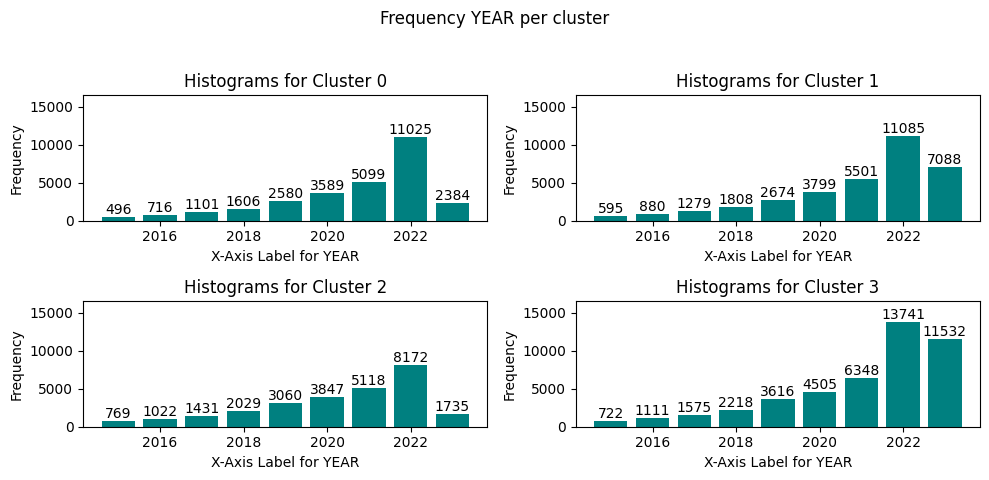

In [85]:
categorical_columns_hist = [
    'YEAR'
]
for column in categorical_columns_hist:
    plot_clusters_numeric_features_hist(df, numeric_col=column, save=False)

## Dias Frecuencia Recarga

Podemos observar una diferencia marcada entre las diferentes distribuciones de cada cluster. En el caso de `DIAS_FRECUENCIA_RECARGA`, podemos observar el cluster 0 teniendo una distribución muy a la izquierda, los clusters 2 y 3 teniendo una distribución muy similar, y el cluster 1 teniendo una distribución con valores más altos.

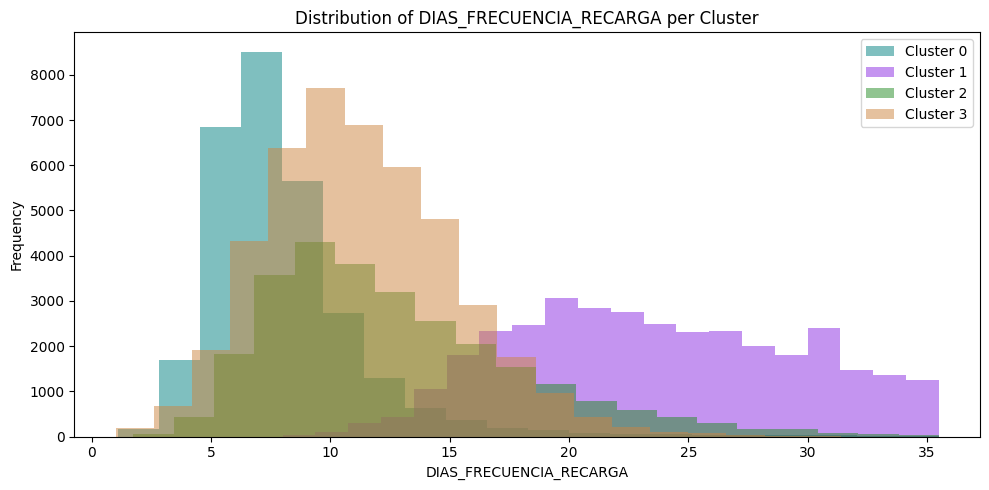

In [86]:
plot_clusters(df, value_column="DIAS_FRECUENCIA_RECARGA")

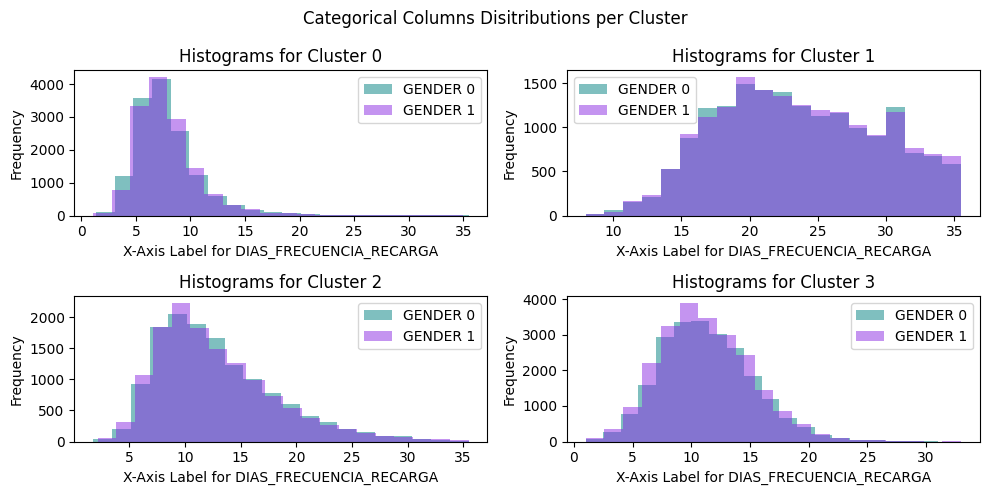

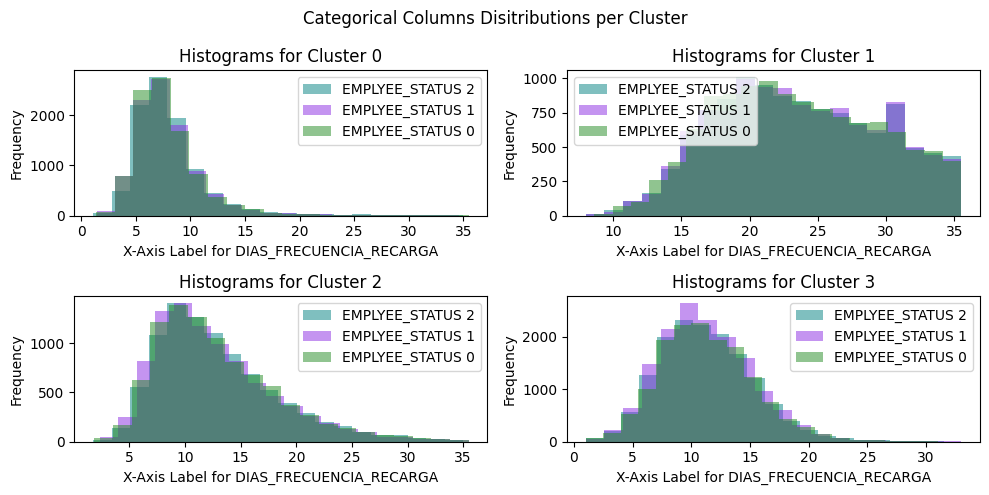

In [87]:
plot_clusters_categorical(df, value_column="DIAS_FRECUENCIA_RECARGA", categorical_col="GENDER")
plot_clusters_categorical(df, value_column="DIAS_FRECUENCIA_RECARGA", categorical_col="EMPLYEE_STATUS")

El atributo de `SUM_ESC_TRAFICO_IVR_VOZ` muestra unas distribuciones diferentes que las que ya hemos visto para cada cluster. Esta sdistribuciones logran justificar la separación del cluster 2 del 3, pues podemos observar que son los usuarios de este cluster los que cuentan con minutos guardados en buzon de voz.

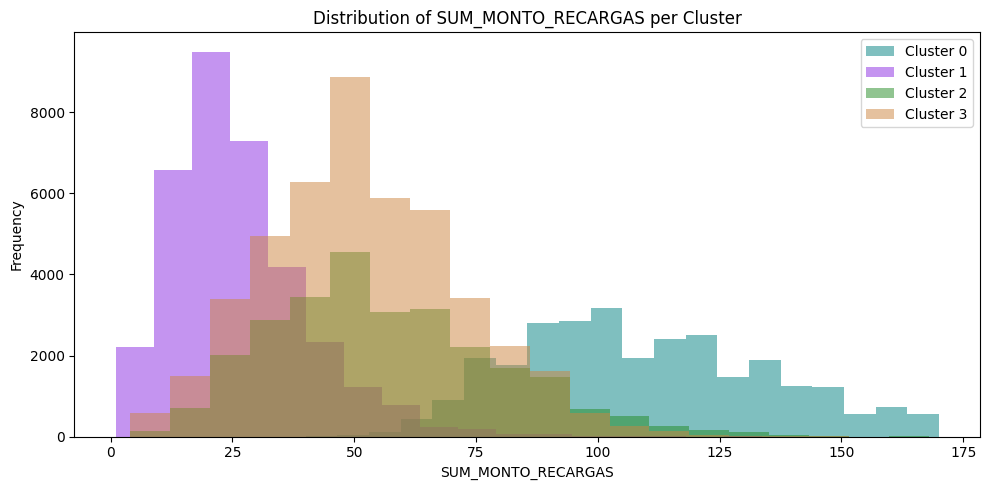

In [88]:
plot_clusters(df, value_column="SUM_MONTO_RECARGAS")

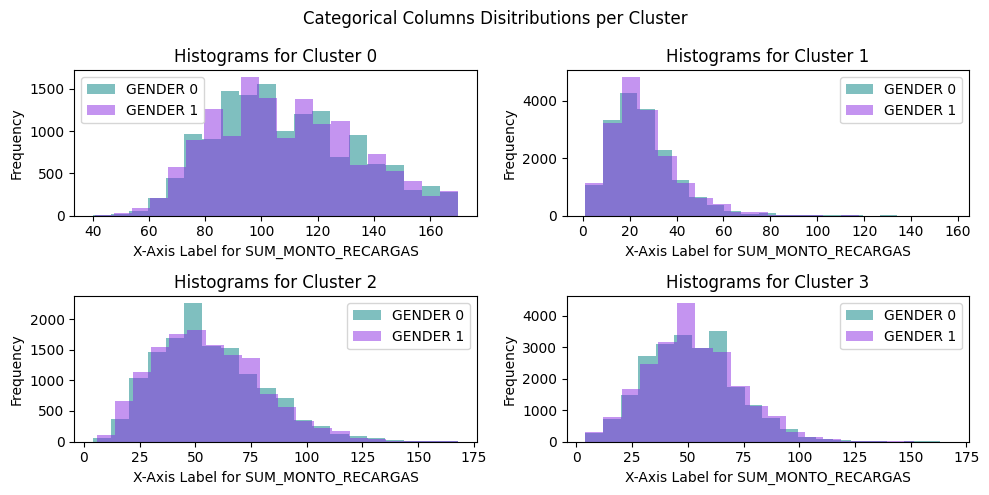

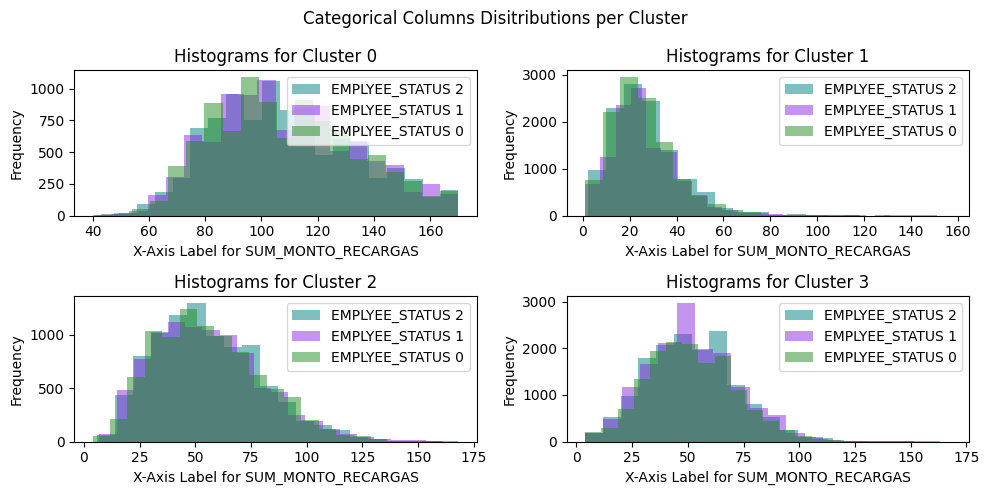

In [89]:
plot_clusters_categorical(df, value_column="SUM_MONTO_RECARGAS", categorical_col="GENDER")
plot_clusters_categorical(df, value_column="SUM_MONTO_RECARGAS", categorical_col="EMPLYEE_STATUS")

La distribución del atributo `SUM_CANTIDAD_RECARGAS` muestra una distribución algo diferente, pero mantiene las mismas bases.

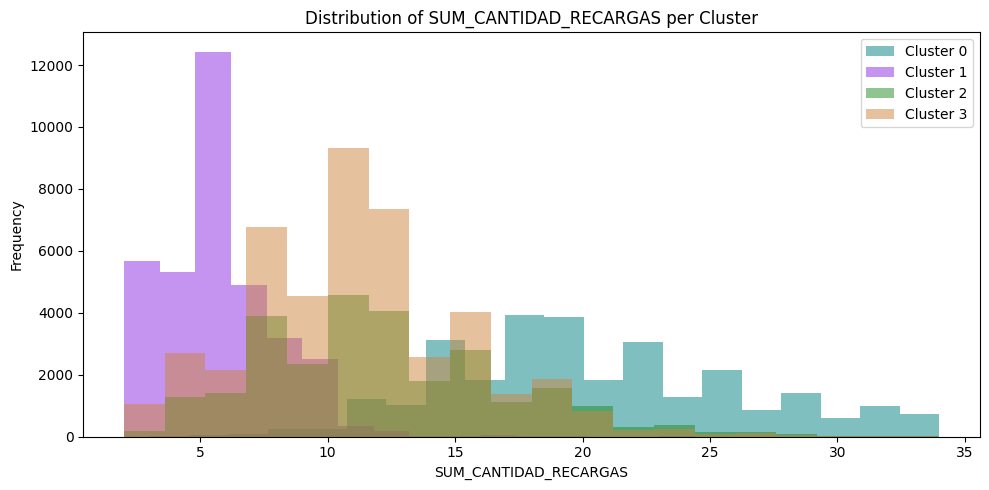

In [90]:
plot_clusters(df, value_column="SUM_CANTIDAD_RECARGAS")

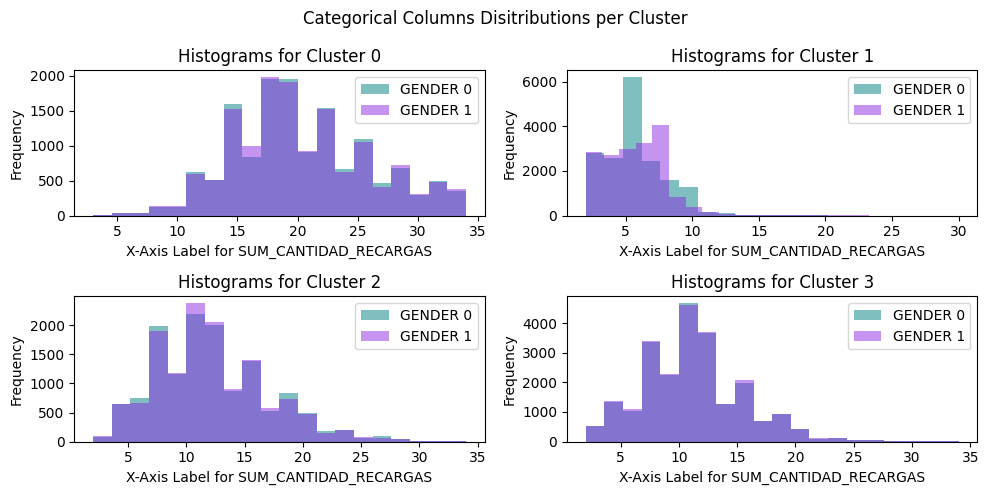

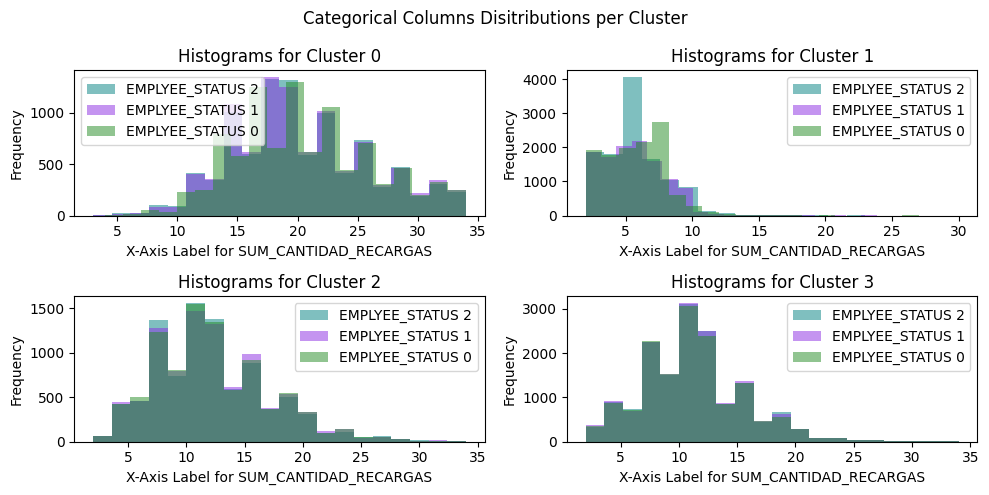

In [91]:
plot_clusters_categorical(df, value_column="SUM_CANTIDAD_RECARGAS", categorical_col="GENDER")
plot_clusters_categorical(df, value_column="SUM_CANTIDAD_RECARGAS", categorical_col="EMPLYEE_STATUS")

El atributo de `SUM_ESC_TRAFICO_IVR_VOZ` muestra unas distribuciones diferentes que las que ya hemos visto para cada cluster. Esta sdistribuciones logran justificar la separación del cluster 2 del 3, pues podemos observar que son los usuarios de este cluster los que cuentan con minutos guardados en buzon de voz.

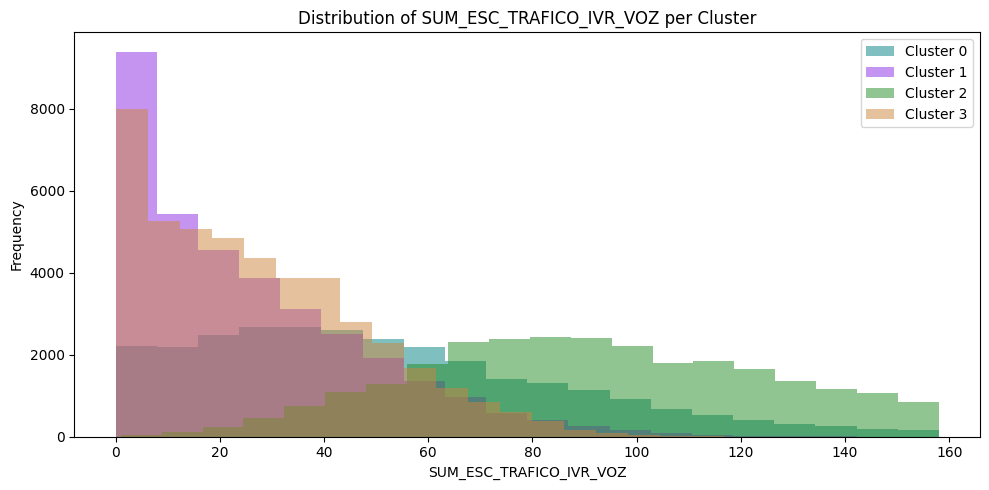

In [92]:
plot_clusters(df, value_column="SUM_ESC_TRAFICO_IVR_VOZ")

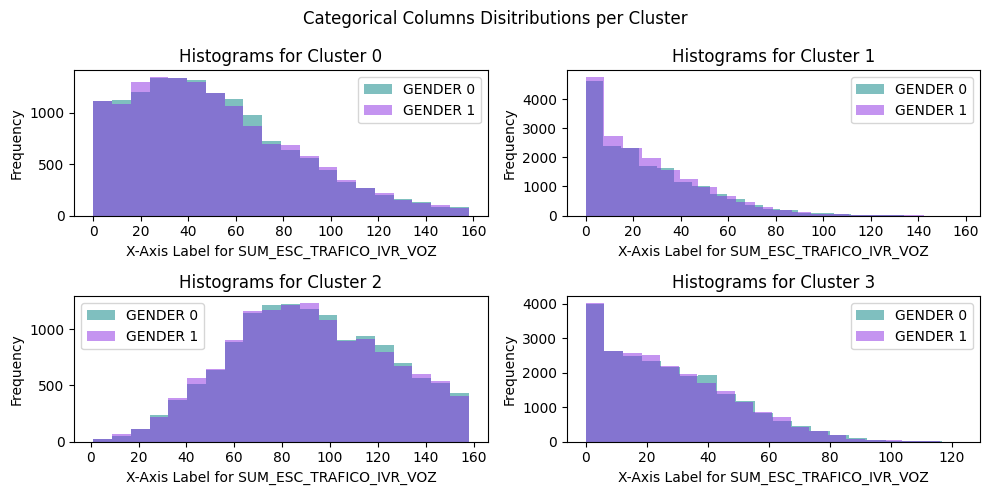

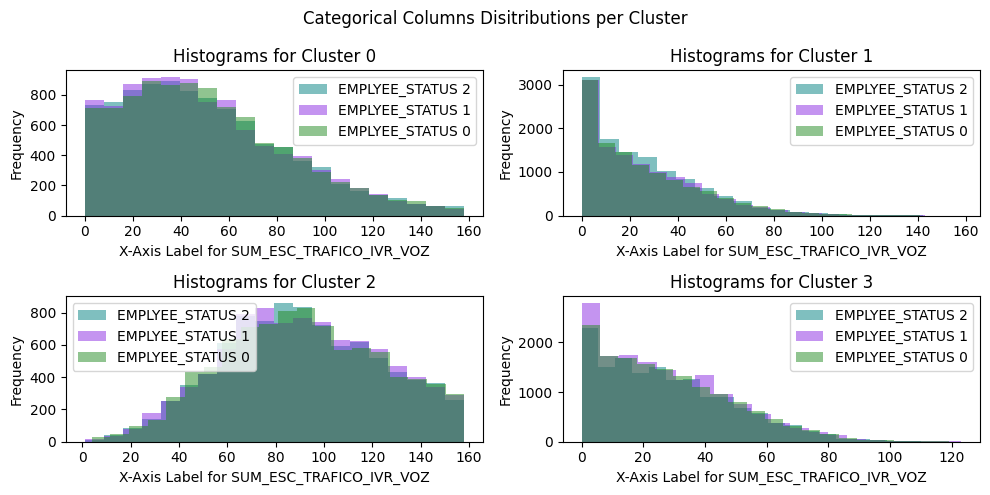

In [93]:
plot_clusters_categorical(df, value_column="SUM_ESC_TRAFICO_IVR_VOZ", categorical_col="GENDER")
plot_clusters_categorical(df, value_column="SUM_ESC_TRAFICO_IVR_VOZ", categorical_col="EMPLYEE_STATUS")

De igual manera, el atributo `SUM_SS_TRAFICO_IVR` vuelve a justificar el cluster 2, mostrando un patrón en este cluster.

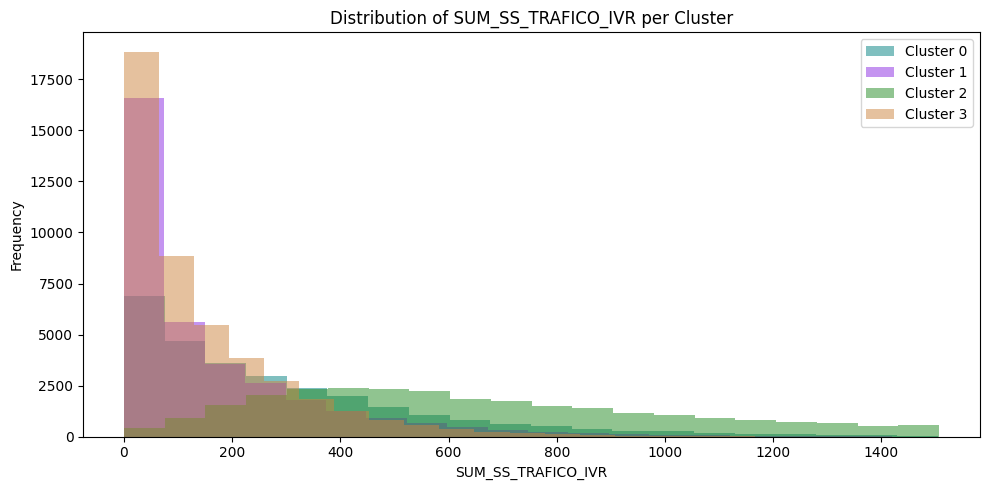

In [94]:
plot_clusters(df, value_column="SUM_SS_TRAFICO_IVR")

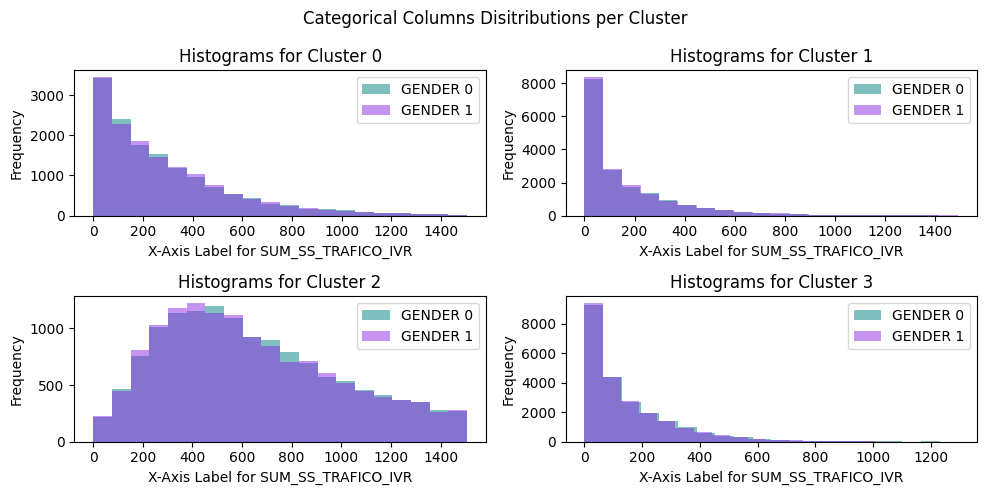

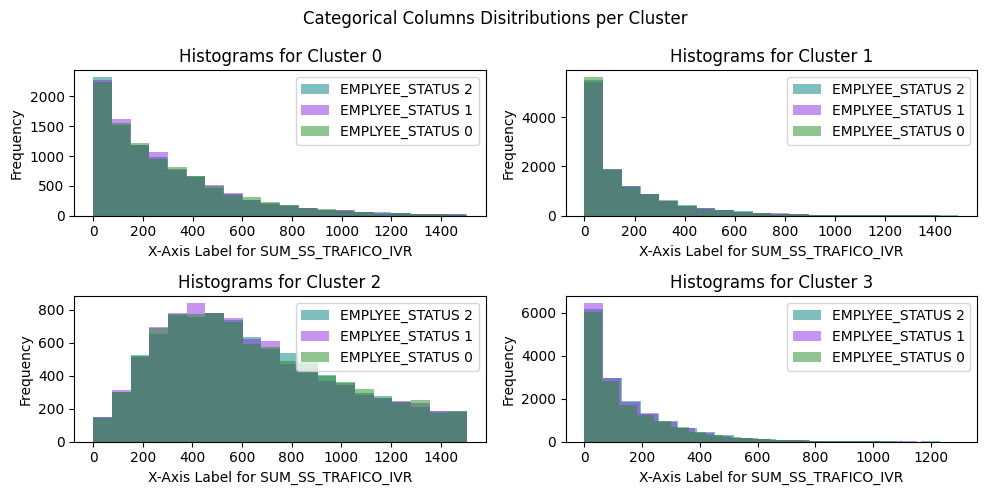

In [95]:
plot_clusters_categorical(df, value_column="SUM_SS_TRAFICO_IVR", categorical_col="GENDER")
plot_clusters_categorical(df, value_column="SUM_SS_TRAFICO_IVR", categorical_col="EMPLYEE_STATUS")

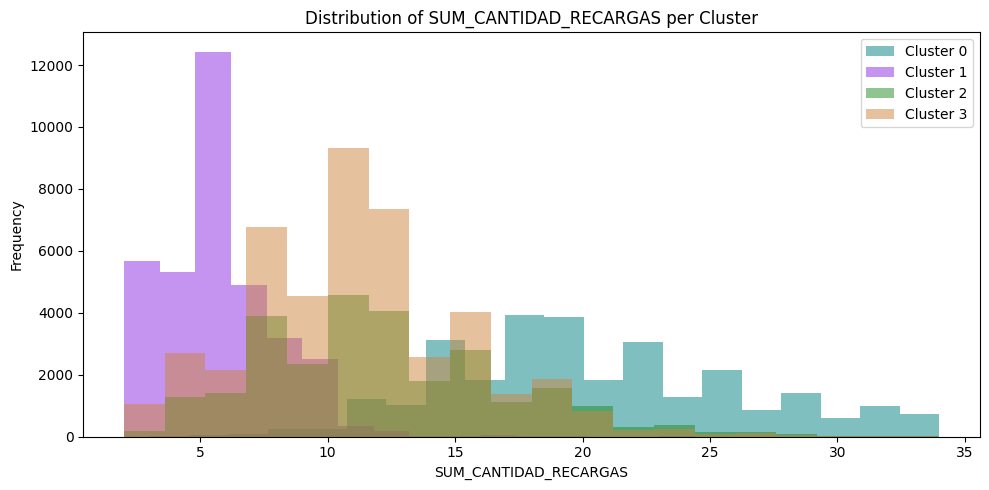

In [96]:
plot_clusters(df, value_column="SUM_CANTIDAD_RECARGAS")

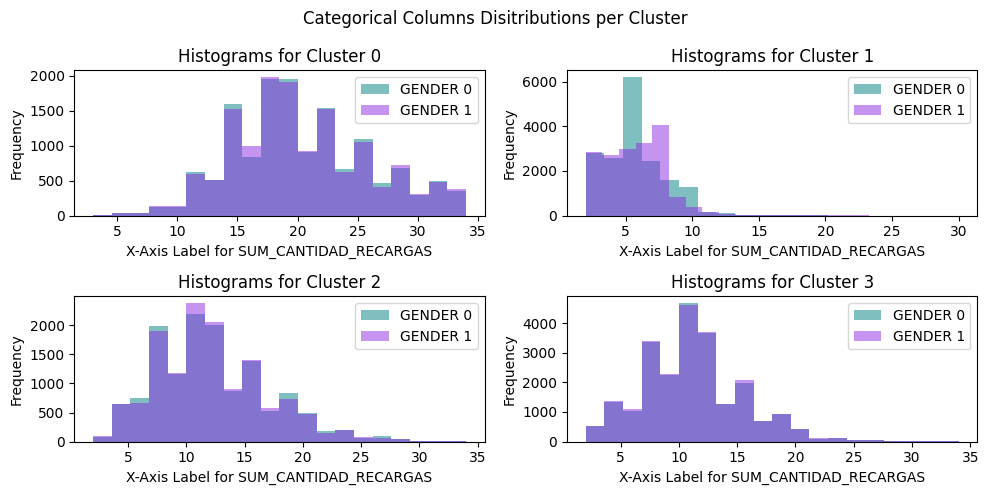

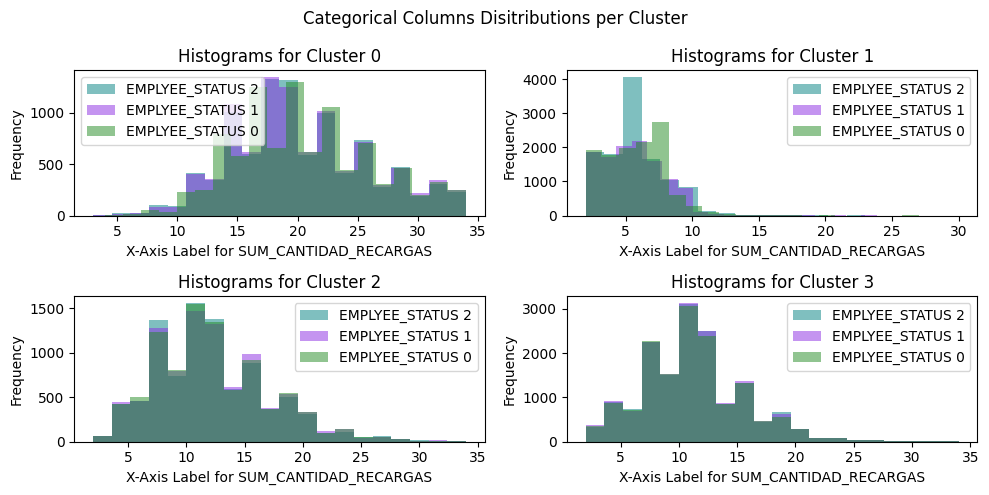

In [97]:
plot_clusters_categorical(df, value_column="SUM_CANTIDAD_RECARGAS", categorical_col="GENDER")
plot_clusters_categorical(df, value_column="SUM_CANTIDAD_RECARGAS", categorical_col="EMPLYEE_STATUS")

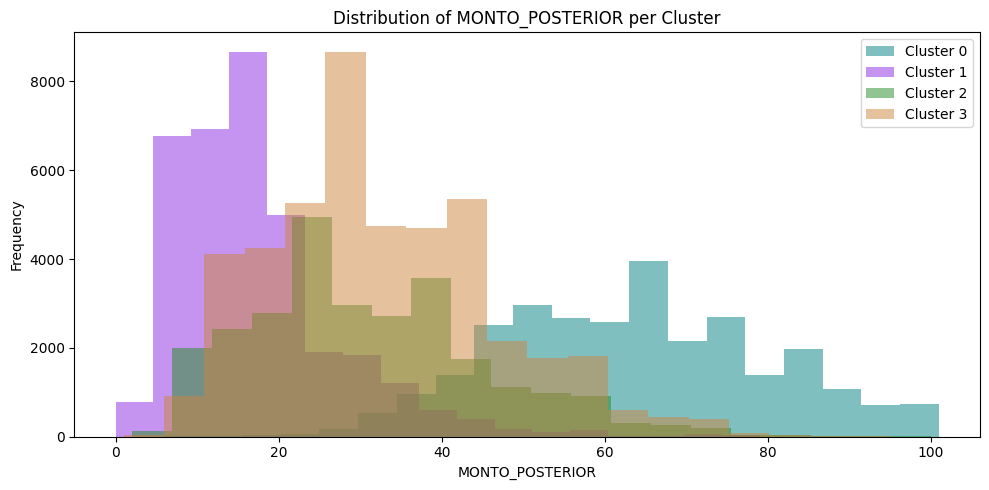

In [98]:
plot_clusters(df, value_column="MONTO_POSTERIOR")

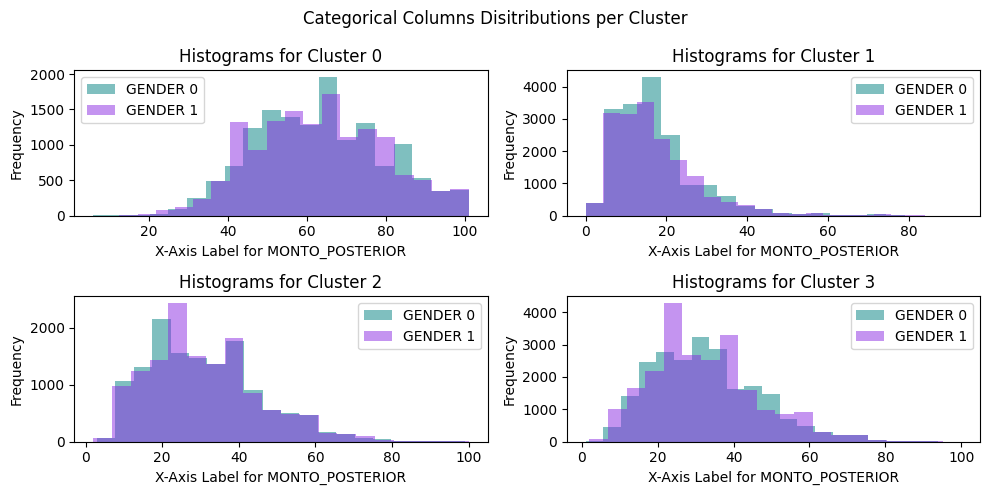

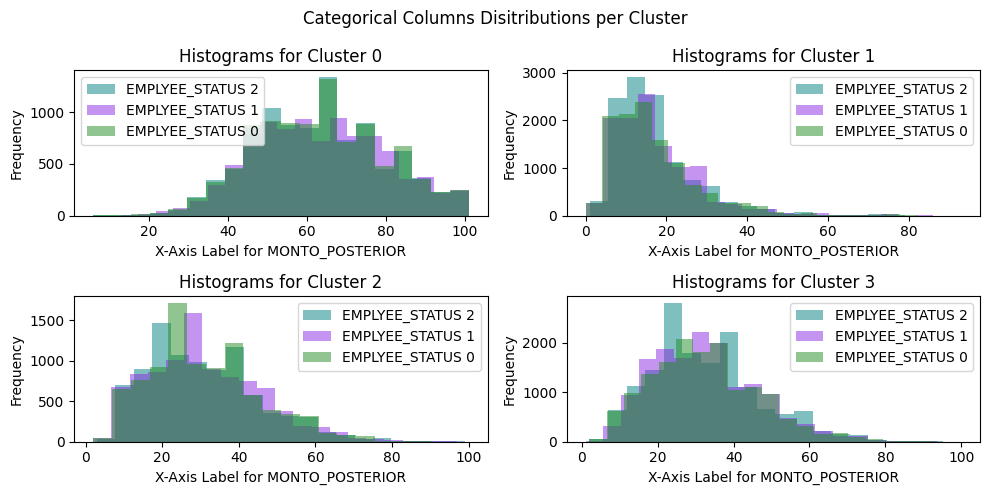

In [99]:
plot_clusters_categorical(df, value_column="MONTO_POSTERIOR", categorical_col="GENDER")
plot_clusters_categorical(df, value_column="MONTO_POSTERIOR", categorical_col="EMPLYEE_STATUS")

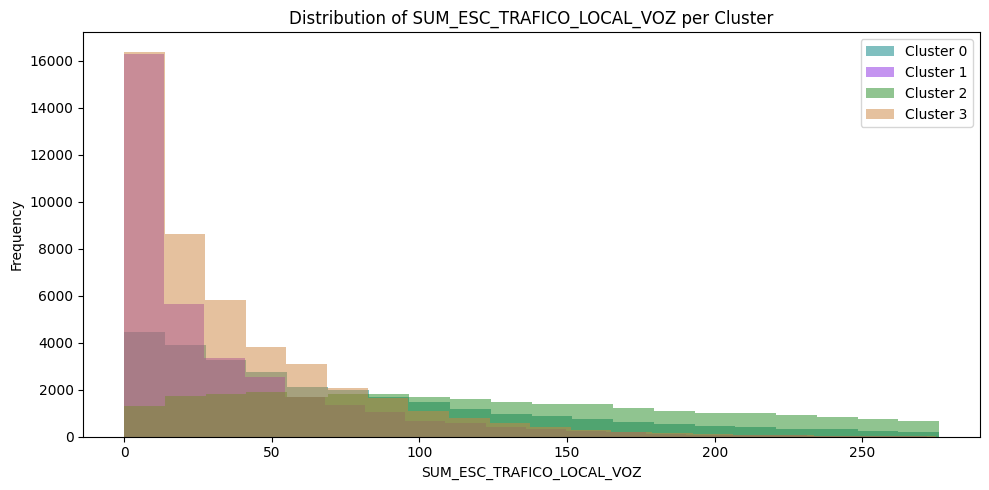

In [100]:
plot_clusters(df, value_column="SUM_ESC_TRAFICO_LOCAL_VOZ")

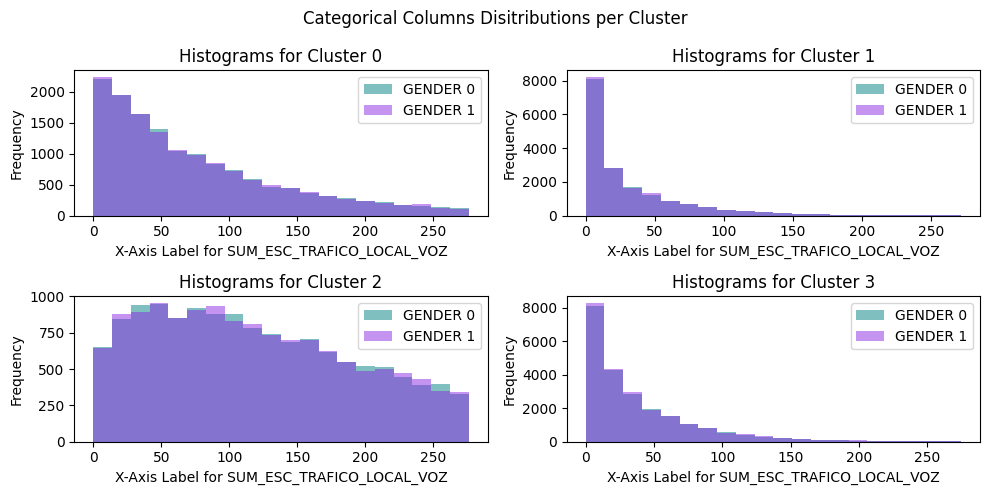

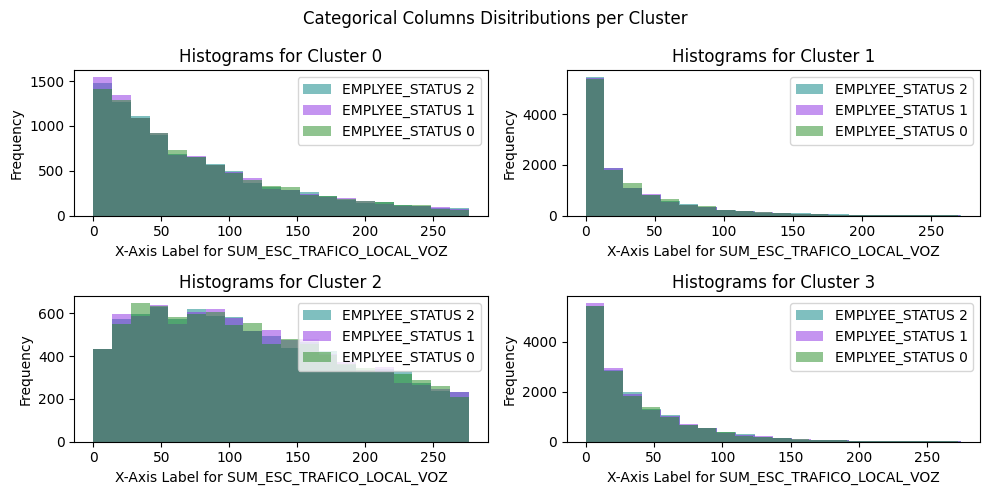

In [101]:
plot_clusters_categorical(df, value_column="SUM_ESC_TRAFICO_LOCAL_VOZ", categorical_col="GENDER")
plot_clusters_categorical(df, value_column="SUM_ESC_TRAFICO_LOCAL_VOZ", categorical_col="EMPLYEE_STATUS")

Tras visualizar los atributos en el contexto de cada cluster, pudimos entender qué era lo que separaba a cada cluster. Con esta información, fuimos capaces de etiquetar cada uno:
Cluster 0: Recargadores Prodigiosos
Usuarios que se caracterizan principalmente por hacer muchas recargas, y de montos grandes. De igual manera, existe muy poco tiempo entre sus recargas.
Cluster 1: Recargadores Cautelosos
Usuarios caracterizados por muy pocas recargas y de montos pequeños. Cuentan con un tiempo entre recargas muy amplio, en promedio de más de un mes (42 días).
Cluster 2: Comunicadores Globales
Se puede ver como un subconjunto del cluster 3. Se consideran usuarios "promedio" en cuanto a su uso de recargas. Sin embargo, este cluster se distingue por usar mensajes internacionales. Cuentan con una gran cantidad de mensajes internacionales. Sin embargo, en su mayoría tienen minutos de llamadas nacionales. De igual manera, cuentan con muchos mensajes de voz en su buzón.
Cluster 3: Usuarios Estándar
Los usuarios promedio. Recargan en promedio cada diez días, rmuy rara vez usan los servicios de mensajería internacional y buzón de voz. Hacen recargas cuando lo necesitam y no gastan más de lo que deben.

### PCA

Por motivos de interpretabilidad y dado que KMeans nos permitió encontrar una clusterización precisa, donde podemos entender correctamente los datos, no fue necesario implementar PCA. En general, se observa que el número de componentes necesarios para explicar la varianza es de aproximadamente 5 componentes. Este análisis ayuda a comprender cuántos componentes principales son necesarios para retener una cantidad significativa de la varianza en los datos.

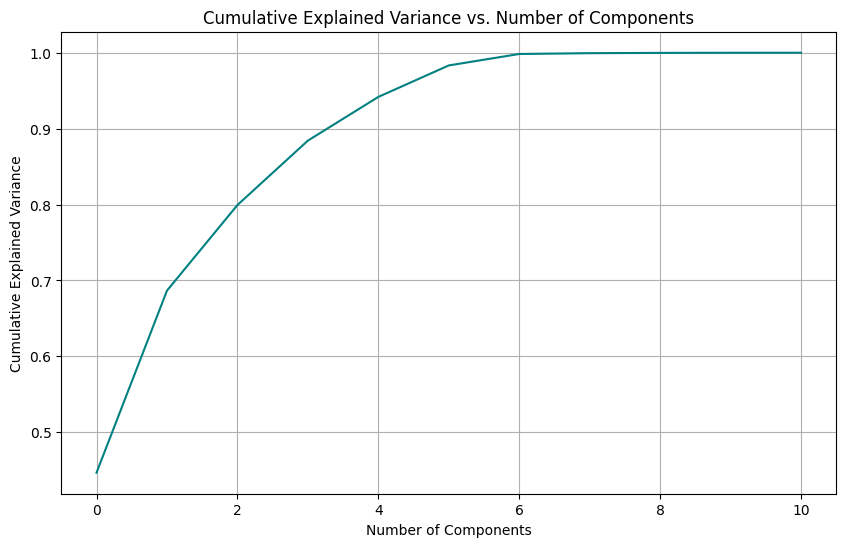

In [102]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

def plot_cumulative_variance(data, n_components=None):
    """
    Plot the cumulative explained variance for different numbers of PCA components.

    Parameters:
    - data: Input data for PCA.
    - n_components: A range of the number of components to consider.

    Returns:
    - None (plots the cumulative variance).
    """
    if n_components is None:
        n_components = min(data.shape)

    # Fit PCA to the data
    pca = PCA(n_components=n_components)
    pca.fit(data)

    # Plot the cumulative explained variance
    plt.figure(figsize=(10, 6))
    plt.plot(np.cumsum(pca.explained_variance_ratio_))
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Explained Variance')
    plt.title('Cumulative Explained Variance vs. Number of Components')
    plt.grid(True)
    plt.show()

# Example Usage:
# Assuming 'your_data' is your numeric feature matrix
plot_cumulative_variance(X.drop(["CLUSTER_KMEANS"], axis=1))

In [103]:
import plotly.express as px

En el siguiente gráfico, se puede observar que los primeros dos componentes principales muestran una separación más evidente entre los clusters. Estos componentes capturan la mayor parte de la varianza en los datos y permiten visualizar la distribución de los puntos en un espacio bidimensional.

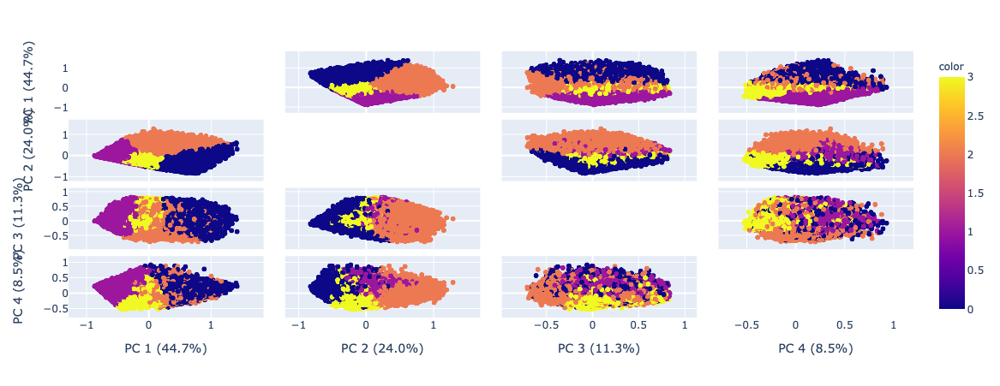

In [104]:
pca = PCA(n_components=5)
components = pca.fit_transform(X.drop(["CLUSTER_KMEANS"], axis=1))
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    components,
    labels=labels,
    dimensions=range(4),
    color=X["CLUSTER_KMEANS"]
)
fig.update_traces(diagonal_visible=False)
fig.show()

## Model

En esta sección, se han implementado modelos para calcular las probabilidades de Churn Rate. Primero, se ha definido la función `eval_predictions` que permite evaluar los resultados del modelo, generando una matriz de confusión y mostrando métricas como la precisión y exhaustividad para las clases de "Churned" y "Retained". Además, se presenta un mapa de calor que visualiza la matriz de confusión.


In [105]:
def eval_predictions(y_pred, y_test, title = "Confusion Matrix"):
    conf_matrix = confusion_matrix(y_test, y_pred)

    accuracy = accuracy_score(y_pred, y_test)
    survivors_precision = conf_matrix[0][0] / (conf_matrix[0][0] + conf_matrix[1][0])
    survivors_recall = conf_matrix[0][0] / np.sum(conf_matrix[0])
    deceased_precision = conf_matrix[1][1] / (conf_matrix[1][1] + conf_matrix[0][1])
    deceased_recall = conf_matrix[1][1] / np.sum(conf_matrix[1])

    print(f"Accuracy score: %.2f" %(accuracy))
    print(f"Churned precision: %.2f" %(survivors_precision))
    print(f"Churned recall: %.2f" %(survivors_recall))
    print(f"Retained precision: %.2f" %(deceased_precision))
    print(f"Retained recall: %.2f" %(deceased_recall))

    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=["Churned", "Retained"], yticklabels=["Churned", "Retained"])
    plt.xlabel("Predicted Labels")
    plt.ylabel("True Labels")
    plt.title(title)
    plt.show()

In [106]:
import lightgbm as lgb
import logging
import tempfile
import warnings
import ads

from ads.common.model_metadata import UseCaseType
from ads.model.framework.lightgbm_model import LightGBMModel
import os

logging.basicConfig(format="%(levelname)s:%(message)s", level=logging.ERROR)
warnings.filterwarnings("ignore")

In [107]:
ads.set_auth(auth="resource_principal")

A continuación, se utiliza el pipeline para la transformación de los datos.

In [108]:
df, X, y, k_means_df = pipeline.transform_lgbm(raw_df, kmeans)
X_lr = X

Started transform with 383099 samples
Finished transform with 281084 samples


In [109]:
X.describe()

,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,STORE,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,YEAR,MONTH,DAY,KMEANS_CLUSTERS
count,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000,281084.000000
mean,0.300972,0.208577,-0.057378,0.247982,0.203584,0.520276,0.558998,0.537615,2.465007,0.342471,0.773495,0.293660,0.003134,-0.026025,0.097280,-0.284396,-0.001358,-0.498897,-0.000151,0.023536,0.024644,-0.639405,0.050549,-0.011442,0.537765
std,0.864776,0.775296,0.232564,0.942310,0.792416,1.554111,1.807544,1.521538,12.702702,1.111678,10.658873,2.982256,0.412889,0.606327,0.543084,0.531982,0.585921,0.500000,0.407448,0.576751,0.576985,1.120276,0.544063,0.581539,1.028910
min,-0.500000,-0.702703,-1.000000,-0.666667,-0.737705,-0.735337,-0.372047,-0.377551,0.000000,-0.537313,0.000000,0.000000,0.000000,-1.052632,-1.254334,-2.023613,-1.000000,-1.000000,-0.500000,-0.950000,-0.950000,-5.500000,-0.714286,-1.000000,-1.000000
25%,-0.318182,-0.405405,0.000000,-0.416667,-0.393443,-0.304277,-0.293307,-0.285714,0.000000,-0.358209,0.000000,0.000000,0.000000,-0.526316,-0.359589,-0.806556,-0.500000,-1.000000,-0.500000,-0.500000,-0.500000,-1.000000,-0.428571,-0.533333,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.681818,0.594595,0.000000,0.583333,0.606557,0.695723,0.706693,0.714286,0.000000,0.641791,0.000000,0.000000,0.000000,0.473684,0.640411,0.193444,0.500000,0.000000,0.500000,0.500000,0.500000,0.000000,0.571429,0.466667,1.000000
max,9.181818,10.594595,0.000000,24.250000,7.524590,14.480193,290.047244,54.653061,1442.000000,68.611940,1072.000000,275.000000,120.000000,1.000000,1.054762,0.212037,1.000000,0.000000,0.500000,1.000000,1.000000,0.500000,0.857143,1.000000,2.000000


Se elimina la columna "Monto Anterior" debido a que se identificó que esta columna lograba predecir el Churn Rate en un 99%.

In [110]:
X = X.drop(["MONTO_ANTERIOR"], axis=1)

In [111]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=2)

Se entrena el modelo de LGBM a continuación.

In [112]:
clf = lgb.LGBMClassifier()
clf.fit(X_train, y_train)

LGBMClassifier()

In [113]:
y_pred=clf.predict(X_test)

Tras el entrenamiento y las predicciones, logramos obtener un 95% de precisión, lo cual consideramos un valor satisfactorio. Es importante destacar que eliminamos ciertos atributos para mejorar la generalización del modelo.

In [114]:
from sklearn.metrics import accuracy_score
accuracy=accuracy_score(y_pred, y_test)
print('LightGBM Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred)))

LightGBM Model accuracy score: 0.9534


In [115]:
clf.booster_.save_model('output_models/lgbm_model.txt')

Accuracy score: 0.95
Churned precision: 0.95
Churned recall: 0.83
Retained precision: 0.95
Retained recall: 0.99


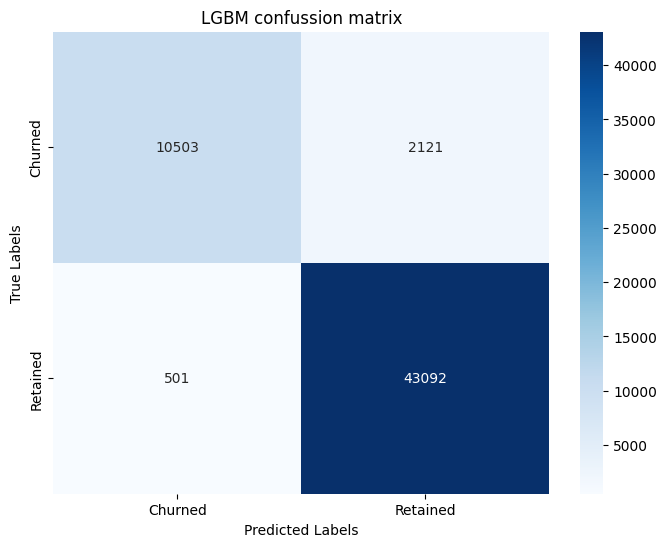

In [116]:
eval_predictions(y_pred, y_test, title="LGBM confussion matrix")

In [117]:
#single_sample = raw_df.iloc[[45128]]
rr_def = raw_df.loc[:,~raw_df.columns.duplicated()].copy()
single_sample = rr_def[(rr_def["DNI"] == "CP10809468")]
single_sample

,FECHA_ALTA,CANTIDAD_RECARGAS_MES,MONTO_RECARGADO_MES,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,SALDO_TOTAL,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,AVG_CANTIDAD_RECARGAS,AVG_MONTO_RECARGAS,MIN_CANTIDAD_RECARGAS,MIN_MONTO_RECARGAS,MAX_CANTIDAD_RECARGAS,MAX_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_LOCAL_ONNET,SUM_SS_TRAFICO_LOCAL_OFFNET,SUM_SS_TRAFICO_LOCAL,SUM_SS_TRAFICO_INTERNACIONAL,SUM_SS_TRAFICO_IVR,SUM_SE_ROAMING,SUM_SS_ROAMING,SUM_SS_TOTAL,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,DNI,STORE,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MARITAL_STATUS,IMEI,MANUFACTURER,MODEL
81764,2020-05-18 15:53:00,1,2,19,0,1,3,1,14,37,3.5,9,1,2,7,19,12.818182,79,1607,1686,0,267,0,0,1953,48,0,12,0,0,0,CP10809468,"1916 M St NW, Washington, DC 20036, United States",38.905456,-77.044235,36,FEMALE,employee,Widow,440216,Samsung,Telguard 5TG5


In [118]:
raw_dataframe_to_lgbm, X_dtl, y_dtl, kmeans_dtl = pipeline.transform_sample_lgbm(rr_def, kmeans)

import dill

serialized = dill.dumps(raw_dataframe_to_lgbm)
with open("output_models/df_raw_to_lgbm.pkl", "wb") as df_raw_to_lgbm_file:
    df_raw_to_lgbm_file.write(serialized)

Started transform with 383099 samples
        MONTO_POSTERIOR  SUM_CANTIDAD_RECARGAS  SUM_MONTO_RECARGAS  \
381591               24                     22                  90   
380797               11                      1                  11   
380428               11                      8                  75   
380068               11                      1                  11   
379545               11                      3                  11   
...                 ...                    ...                 ...   
4                     8                      9                  22   
3                     2                      3                   7   
2                     7                      3                  17   
1                   112                     33                 188   
0                    56                      4                  82   

        DIAS_FRECUENCIA_RECARGA  SUM_SS_TRAFICO_IVR  \
381591                 6.555556                 112   
380797     

In [119]:
sample_transform, Xx, Yy, kmeansdf = pipeline.transform_sample_lgbm(single_sample, kmeans)

Started transform with 1 samples
       MONTO_POSTERIOR  SUM_CANTIDAD_RECARGAS  SUM_MONTO_RECARGAS  \
81764               21                     14                  37   

       DIAS_FRECUENCIA_RECARGA  SUM_SS_TRAFICO_IVR  SUM_ESC_TRAFICO_LOCAL_VOZ  \
81764                12.818182                 267                         48   

       SUM_ESC_TRAFICO_INTERNACIONAL_VOZ  SUM_ESC_TRAFICO_IVR_VOZ  \
81764                                  0                       12   

       SUM_ESC_ROAMING_ENTRANTE_VOZ  SUM_ESC_ROAMING_SALIENTE_VOZ  \
81764                             0                             0   

       SUM_ESC_FAMILIA_Y_AMIGOS_VOZ  
81764                             0  
Finished transform with 1 samples


In [120]:
clf.predict(Xx.drop(["MONTO_ANTERIOR"], axis=1))

array([1])

In [121]:
# Export kmeans cluster
import pickle

with open("output_models/pipeline.pkl", "wb") as pipeline_file:
    pickle.dump(pipeline, pipeline_file)

In [122]:
import dill
serialized = dill.dumps(pipeline)

with open("output_models/pipeline.pkl", "wb") as pipeline_file:
    pipeline_file.write(serialized)

Aplicamos nuevamente los SHAP values para comprender mejor nuestro modelo y entender de qué manera tiende a tomar decisiones.


In [123]:
explainer = shap.Explainer(clf)
X_sample = X_train.sample(10000)
shap_values = explainer.shap_values(X_sample)

Se puede observar que los atributos que mejor explican si un cliente permanece en la empresa son "Monto Posterior" y "Sum Cantidad Recargas". Esto tiene sentido, ya que estas características, dependiendo de si tienen un valor o no, pueden indicar la actividad del cliente en el negocio.

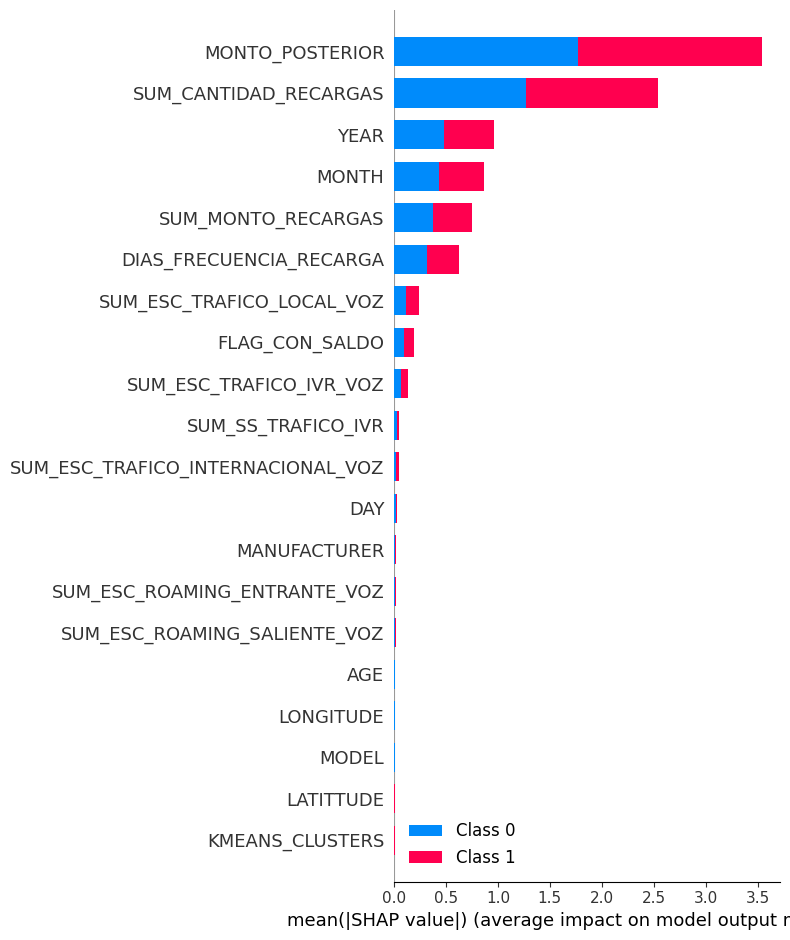

In [124]:
shap.summary_plot(shap_values, X_sample)

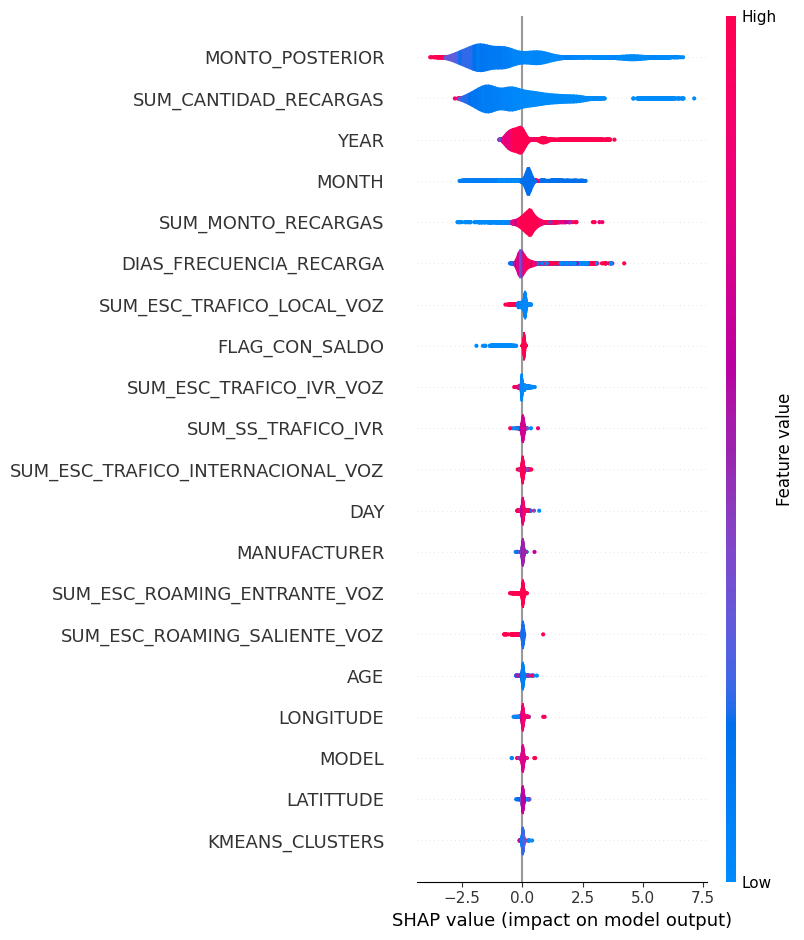

In [125]:
shap.summary_plot(shap_values[0], X_sample, plot_type="violin")

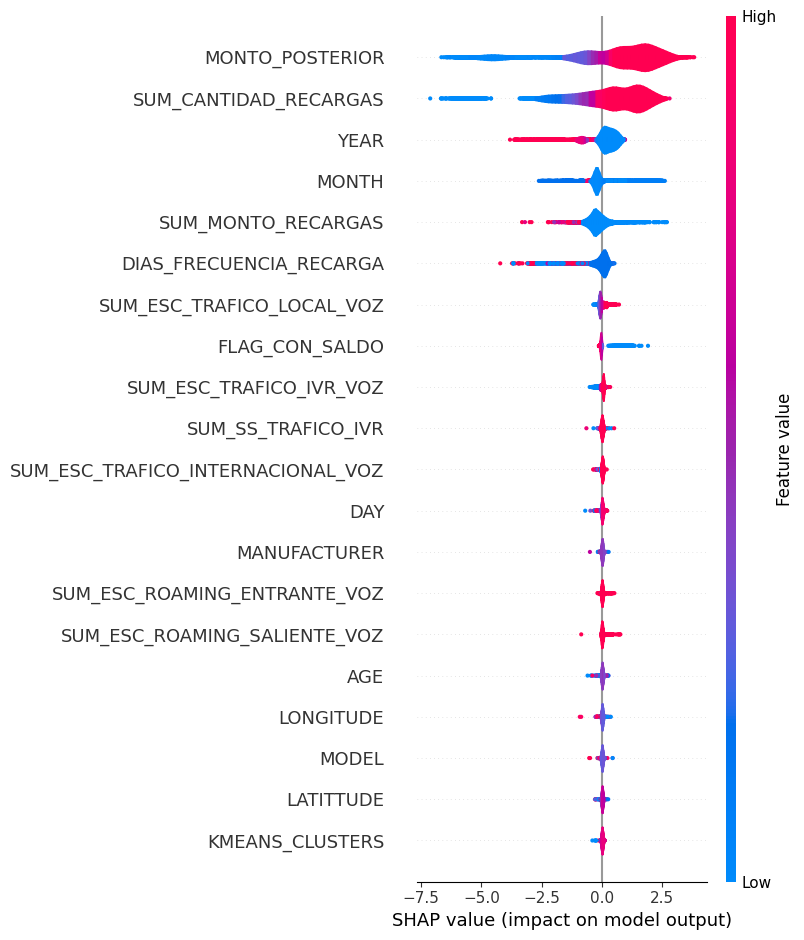

In [126]:
shap.summary_plot(shap_values[1], X_sample, plot_type="violin")

In [127]:
df['probability'] = clf.predict_proba(X)[:, 1]

In [128]:
df[(df["FLAG_CLIENTE_ACTIVO"] == 1)]["probability"]

381591    0.268138
377757    0.373992
376792    0.788656
362217    0.007352
362206    0.199127
            ...   
6         0.953643
5         0.961378
4         0.985381
1         0.998795
0         0.902302
Name: probability, Length: 217557, dtype: float64

In [129]:
df

,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,STORE,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,YEAR,MONTH,DAY,KMEANS_CLUSTERS,probability
381591,13,24,1,1,22,90,6.555556,112,217,1,8,0,0,0,26,38.896980,-77.028913,46,0,2,35,12,2023,3,31,0,0.268138
380797,0,11,0,1,1,11,110.000000,0,4,0,0,0,0,0,20,40.718514,-74.001168,79,1,0,35,12,2023,3,31,1,0.001188
380428,0,11,0,1,8,75,11.600000,2390,289,0,123,0,0,0,13,25.790295,-80.132077,36,1,0,30,3,2023,3,31,2,0.078866
380068,0,11,0,1,1,11,24.200000,20,27,0,11,0,0,0,0,44.981410,-73.459820,61,1,0,25,33,2023,3,31,1,0.000754
379545,0,11,0,1,3,11,1.000000,30,3,0,5,0,0,0,10,40.750831,-73.989096,28,0,0,21,8,2023,3,30,3,0.003256
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4,4,8,1,1,9,22,15.600000,0,110,0,24,0,0,0,22,40.750506,-73.990583,27,1,2,2,16,2011,11,7,1,0.985381
3,0,2,0,1,3,7,16.714286,36,46,0,21,0,0,0,28,32.820654,-117.178011,53,0,1,39,24,2011,11,7,1,0.008995
2,0,7,0,1,3,17,24.500000,0,6,0,6,0,0,0,35,40.727401,-73.812460,37,0,1,11,14,2011,11,5,1,0.013547
1,71,112,1,1,33,188,5.825000,61,51,0,38,0,0,0,16,40.759057,-111.897383,70,1,2,28,38,2011,10,17,0,0.998795


En el siguiente pairplot se demuestra que las características con una distribución más diferenciable son "Monto Posterior" y "Sum Cantidad Recargas". Estas variables muestran claramente la distinción entre clientes activos e inactivos.

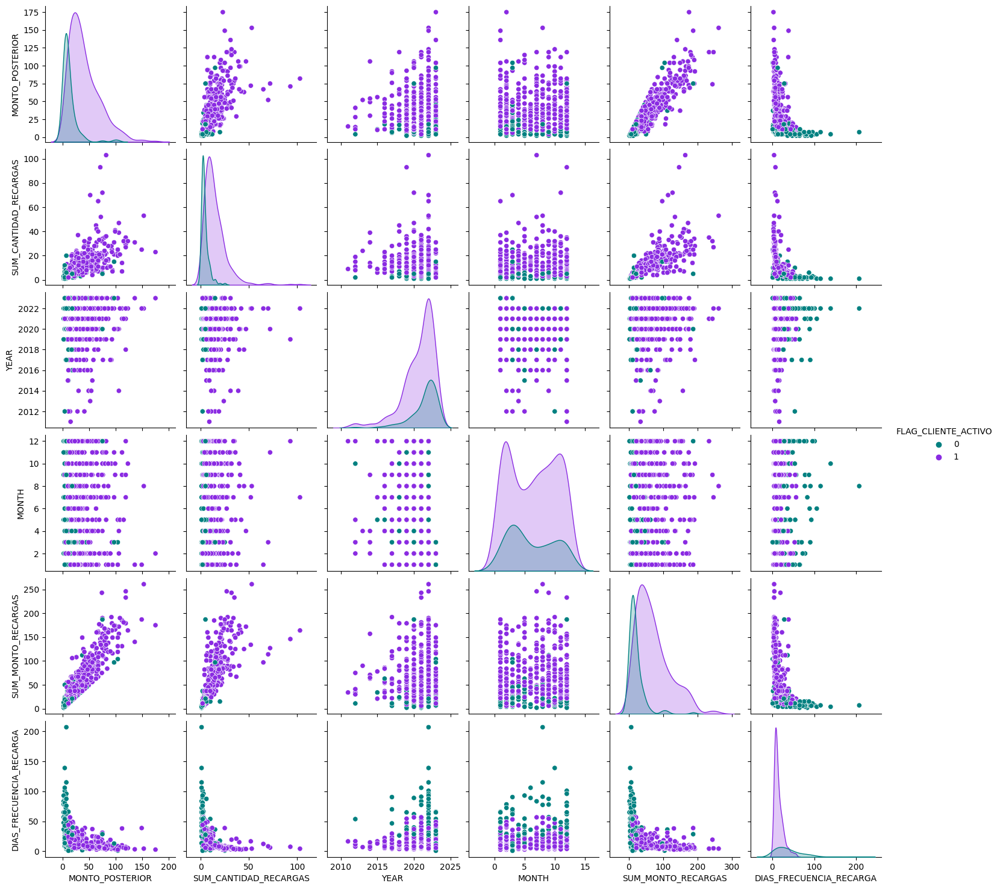

In [130]:
sns.pairplot(df[["MONTO_POSTERIOR", "SUM_CANTIDAD_RECARGAS", "YEAR", "MONTH", "SUM_MONTO_RECARGAS", "DIAS_FRECUENCIA_RECARGA", "FLAG_CLIENTE_ACTIVO"]].sample(500), hue="FLAG_CLIENTE_ACTIVO")

In [131]:
df[(df["probability"] < 0.9) & (df["FLAG_CLIENTE_ACTIVO"] == 1)]

,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,STORE,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,YEAR,MONTH,DAY,KMEANS_CLUSTERS,probability
381591,13,24,1,1,22,90,6.555556,112,217,1,8,0,0,0,26,38.896980,-77.028913,46,0,2,35,12,2023,3,31,0,0.268138
377757,7,14,1,1,3,22,41.600000,70,15,0,14,0,0,0,32,34.035270,-118.238206,80,0,1,14,27,2023,3,30,1,0.373992
376792,30,37,1,0,5,37,26.500000,20,4,0,12,2,0,0,38,28.423814,-81.461242,58,1,0,18,10,2023,3,30,1,0.788656
362217,4,15,1,1,5,60,16.222222,580,24,0,42,0,0,0,12,40.709375,-74.009979,62,0,1,36,32,2023,3,24,1,0.007352
362206,11,15,1,1,13,52,10.000000,246,18,0,77,0,0,0,1,34.056593,-118.426000,60,1,0,3,7,2023,3,24,3,0.199127
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33,2,4,1,1,4,11,53.500000,606,0,0,15,0,0,0,2,34.152507,-118.367904,48,0,2,28,38,2011,11,14,1,0.179069
20,7,11,1,1,7,49,19.181818,0,488,0,27,0,0,0,30,32.744596,-96.812286,33,1,0,37,25,2011,11,12,2,0.641142
14,11,13,1,1,6,32,33.600000,68,0,0,5,0,0,0,37,30.329135,-97.660629,77,1,1,35,12,2011,11,11,1,0.862486
13,4,13,1,1,5,17,27.625000,19,12,7,6,0,0,0,31,28.450387,-81.471414,32,0,2,36,32,2011,11,10,1,0.869246


Mostramos el siguiente histograma para identificar la cantidad de usuarios por un rango de probabilidades. El plot tiene sentido ya que, en general, no todos los usuarios se saldrán del negocio. La mayoría de los usuarios se encuentra en rangos de probabilidad más altos, lo que indica una mayor probabilidad de retención.

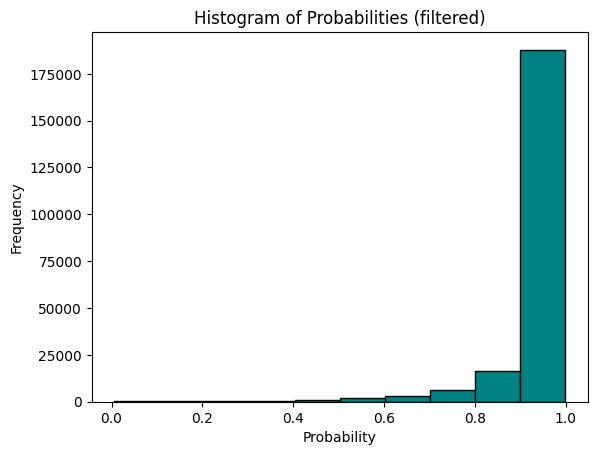

In [132]:
plt.hist(df[(df["FLAG_CLIENTE_ACTIVO"] == 1)]["probability"], bins=10, edgecolor='black')
plt.xlabel('Probability')
plt.ylabel('Frequency')
plt.title('Histogram of Probabilities (filtered)')
plt.show()

A partir del análisis anterior, seleccionamos ciertos rangos para categorizar a los clientes según su probabilidad de churn. Creamos una nueva columna llamada 'ChurnCategory' que clasifica a los clientes en las siguientes categorías: 'Low Risk' (Bajo Riesgo), 'Moderate Risk' (Riesgo Moderado), 'High Risk' (Alto Riesgo), 'Critical Risk' (Riesgo Crítico), y 'Undefined' (No Definido).


In [133]:
def categorize_churn_probability(probability):
    if probability > 0.85:
        return "Low Risk"
    elif 0.70 <= probability <= 0.85:
        return "Moderate Risk"
    elif 0.50 <= probability < 0.70:
        return "High Risk"
    elif probability < 0.50:
        return "Critical Risk"
    else:
        return "Undefined"
df['ChurnCategory'] = df['probability'].apply(categorize_churn_probability)

In [134]:
churn_category_counts = df.groupby(['KMEANS_CLUSTERS', 'ChurnCategory']).size().reset_index(name='Count')
print(churn_category_counts)

    KMEANS_CLUSTERS  ChurnCategory  Count
0                 0  Critical Risk    279
1                 0      High Risk     36
2                 0       Low Risk  49882
3                 0  Moderate Risk    105
4                 1  Critical Risk  39493
5                 1      High Risk   5856
6                 1       Low Risk  37701
7                 1  Moderate Risk   9821
8                 2  Critical Risk   3679
9                 2      High Risk   1232
10                2       Low Risk  66516
11                2  Moderate Risk   2936
12                3  Critical Risk  11921
13                3      High Risk   1069
14                3       Low Risk  47718
15                3  Moderate Risk   2840


A partir de la categorización de riesgos y los clusters, observamos los diferentes tipos de clientes junto con la cantidad de usuarios según la categorización de riesgos. Estos gráficos nos permiten focalizar nuestra atención en la distribución de marketing dirigido.


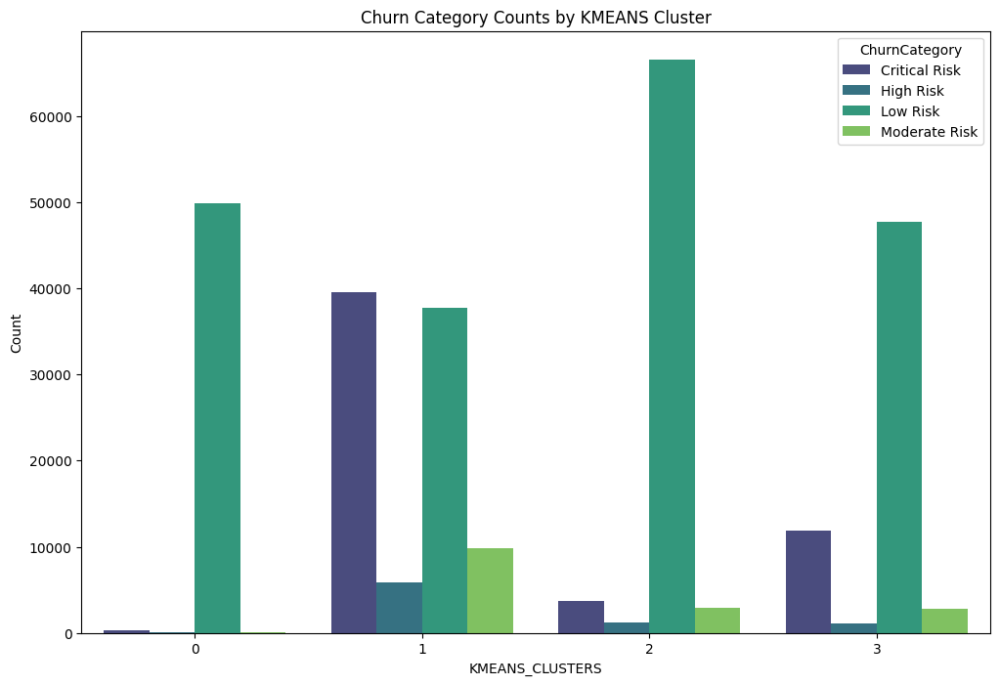

In [135]:
plt.figure(figsize=(12, 8))
sns.barplot(x='KMEANS_CLUSTERS', y='Count', hue='ChurnCategory', data=churn_category_counts, palette='viridis')

plt.title('Churn Category Counts by KMEANS Cluster')
plt.xlabel('KMEANS_CLUSTERS')
plt.ylabel('Count')
plt.show()

In [136]:
import dill

serialized = dill.dumps(churn_category_counts)
with open("output_models/df_churn_category_counts.pkl", "wb") as explainer_sample_file:
    explainer_sample_file.write(serialized)

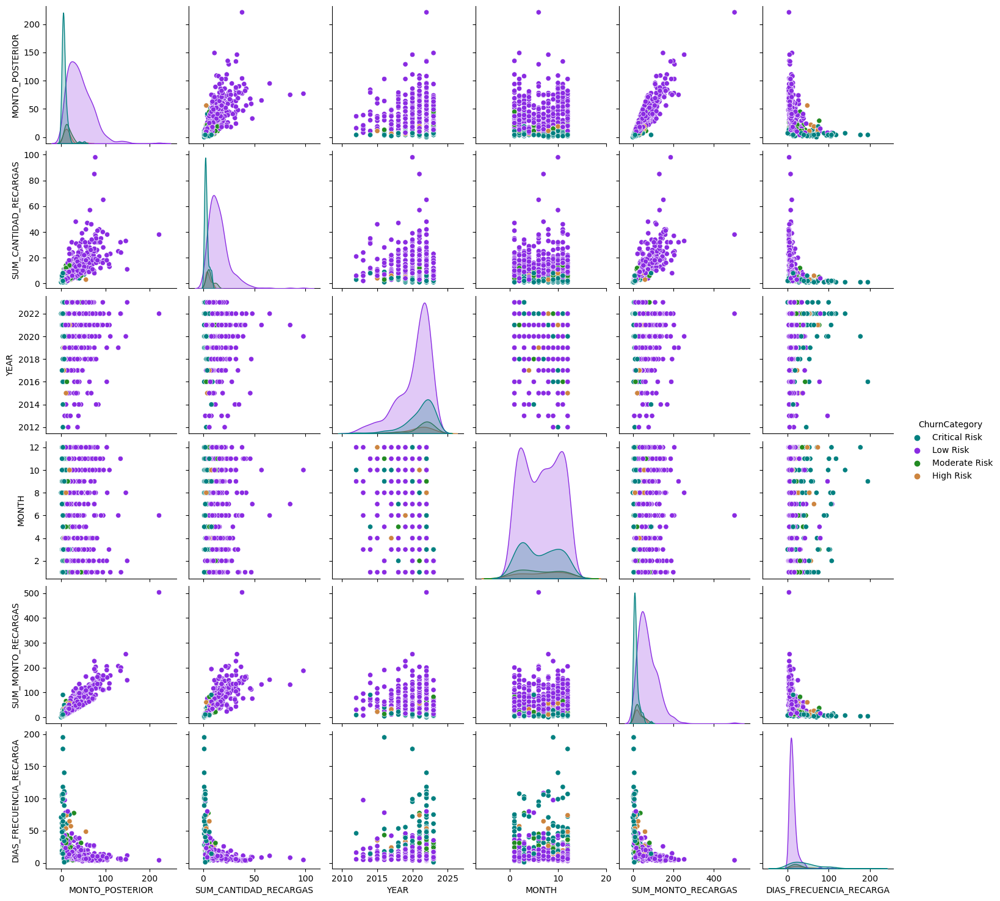

In [137]:
sns.pairplot(df[["MONTO_POSTERIOR", "SUM_CANTIDAD_RECARGAS", "YEAR", "MONTH", "SUM_MONTO_RECARGAS", "DIAS_FRECUENCIA_RECARGA", "ChurnCategory"]].sample(500), hue="ChurnCategory")

In [138]:
df[(df["STORE"]==26) & (df["FLAG_CLIENTE_ACTIVO"]==1)]["probability"].mean()

0.9531872646591729

In [139]:
df[(df["STORE"]==31) & (df["FLAG_CLIENTE_ACTIVO"]==1)]["probability"].mean()

0.9496285616220849

A continuación, se presenta la probabilidad de permanecer en la empresa para cada tienda.


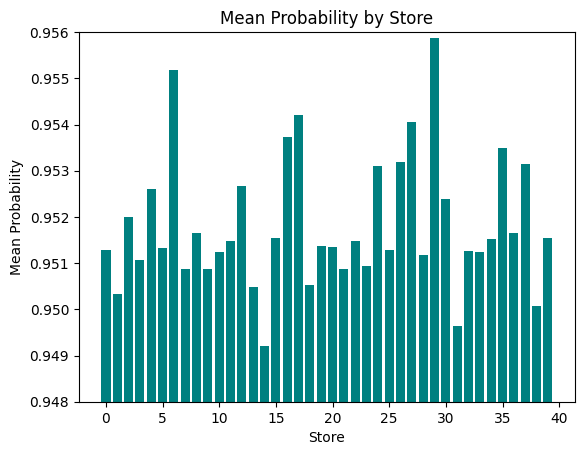

In [140]:
# Filter the DataFrame based on the condition
filtered_df = df[(df["FLAG_CLIENTE_ACTIVO"] == 1)]

# Group by "STORE" and calculate the mean of "probability" for each store
mean_probability_by_store = filtered_df.groupby("STORE")["probability"].mean()

# Generate a bar plot
plt.bar(mean_probability_by_store.index, mean_probability_by_store)
plt.xlabel('Store')
plt.ylabel('Mean Probability')
plt.title('Mean Probability by Store')
plt.ylim(0.948, 0.956)
plt.show()

In [141]:
filtered_df.head(2)

,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,STORE,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,YEAR,MONTH,DAY,KMEANS_CLUSTERS,probability,ChurnCategory
381591,13,24,1,1,22,90,6.555556,112,217,1,8,0,0,0,26,38.89698,-77.028913,46,0,2,35,12,2023,3,31,0,0.268138,Critical Risk
377757,7,14,1,1,3,22,41.600000,70,15,0,14,0,0,0,32,34.03527,-118.238206,80,0,1,14,27,2023,3,30,1,0.373992,Critical Risk


En el gráfico anterior, se presenta la probabilidad promedio de salir del negocio para cada tienda de manera visual. Cada punto en el mapa representa una tienda, donde el color y el tamaño del punto indican la probabilidad promedio, ofreciendo así una representación gráfica de la propensión a dejar la empresa en diferentes ubicaciones geográficas.


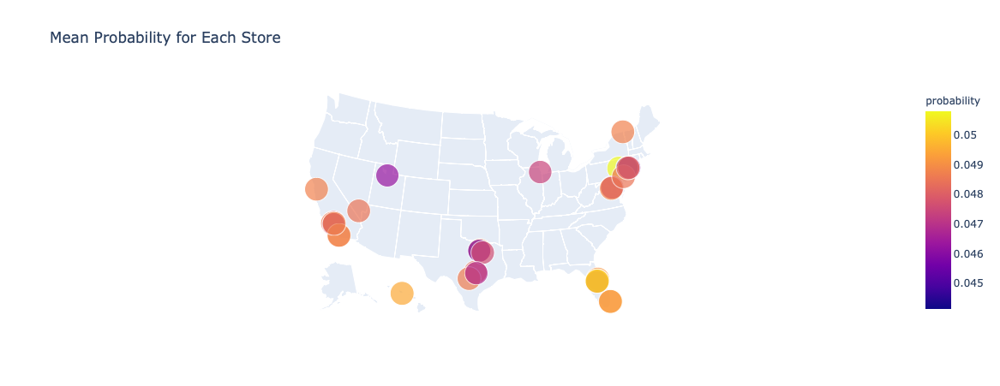

In [142]:
# Group by 'STORE' and calculate the mean probability for each store
mean_probabilities = filtered_df.groupby('STORE')['probability'].mean().reset_index()

# Merge with the original DataFrame to get the latitude and longitude
store_location_data = filtered_df[['STORE', 'LATITTUDE', 'LONGITUDE']].drop_duplicates()
mean_probabilities = pd.merge(mean_probabilities, store_location_data, on='STORE', how='left')
mean_probabilities["probability"] = 1 - mean_probabilities["probability"]
# Plot the mean probabilities on a scatter plot
fig = px.scatter_geo(
    mean_probabilities,
    lat="LATITTUDE",
    lon="LONGITUDE",
    size="probability",
    color="probability",
    hover_name="STORE",
    scope="usa",
    title="Mean Probability for Each Store"
)

fig.show()

In [143]:
import dill

serialized = dill.dumps(mean_probabilities)
with open("output_models/df_mean_probabilities_stores.pkl", "wb") as explainer_sample_file:
    explainer_sample_file.write(serialized)

Para realizar una agrupación geoespacial de las tiendas, implementamos un método de clustering basado en las coordenadas de latitud y longitud de cada tienda. Utilizamos el algoritmo de k-means para agrupar las tiendas en regiones geográficas. A continuación, se presenta el código utilizado:


In [144]:
wcss = []
k_range = range(1, 11)
for k in k_range:
    kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=10000, n_init=10, random_state=0)
    kmeans.fit(df[["LATITTUDE", "LONGITUDE"]])
    wcss.append(kmeans.inertia_)


Tras aplicar el método del codo, determinamos que la cantidad óptima de clusters para el clustering geoespacial de tiendas es 4. Esto nos permitirá clasificar las tiendas en regiones que podrían corresponder a divisiones geográficas como norte, sur, este y oeste. A continuación, se presenta el código actualizado:



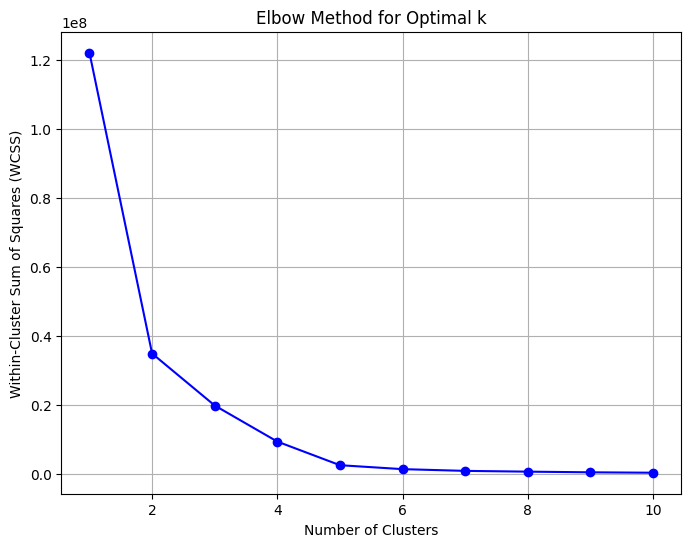

In [145]:
# Plot the WCSS values against the number of clusters
plt.figure(figsize=(8, 6))
plt.plot(k_range, wcss, marker='o', linestyle='-', color='b')
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of Clusters')
plt.ylabel('Within-Cluster Sum of Squares (WCSS)')
plt.grid(True)
plt.show()

In [146]:
kmeans = KMeans(n_clusters=5, random_state=42, n_init=10)
kmeans_clusters = kmeans.fit_predict(df[["LATITTUDE", "LONGITUDE"]])

In [147]:
df["location_cluster"] = kmeans_clusters

In [148]:
df

,MONTO_ANTERIOR,MONTO_POSTERIOR,FLAG_CLIENTE_ACTIVO,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_IVR,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,STORE,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MANUFACTURER,MODEL,YEAR,MONTH,DAY,KMEANS_CLUSTERS,probability,ChurnCategory,location_cluster
381591,13,24,1,1,22,90,6.555556,112,217,1,8,0,0,0,26,38.896980,-77.028913,46,0,2,35,12,2023,3,31,0,0.268138,Critical Risk,0
380797,0,11,0,1,1,11,110.000000,0,4,0,0,0,0,0,20,40.718514,-74.001168,79,1,0,35,12,2023,3,31,1,0.001188,Critical Risk,0
380428,0,11,0,1,8,75,11.600000,2390,289,0,123,0,0,0,13,25.790295,-80.132077,36,1,0,30,3,2023,3,31,2,0.078866,Critical Risk,4
380068,0,11,0,1,1,11,24.200000,20,27,0,11,0,0,0,0,44.981410,-73.459820,61,1,0,25,33,2023,3,31,1,0.000754,Critical Risk,0
379545,0,11,0,1,3,11,1.000000,30,3,0,5,0,0,0,10,40.750831,-73.989096,28,0,0,21,8,2023,3,30,3,0.003256,Critical Risk,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4,4,8,1,1,9,22,15.600000,0,110,0,24,0,0,0,22,40.750506,-73.990583,27,1,2,2,16,2011,11,7,1,0.985381,Low Risk,0
3,0,2,0,1,3,7,16.714286,36,46,0,21,0,0,0,28,32.820654,-117.178011,53,0,1,39,24,2011,11,7,1,0.008995,Critical Risk,1
2,0,7,0,1,3,17,24.500000,0,6,0,6,0,0,0,35,40.727401,-73.812460,37,0,1,11,14,2011,11,5,1,0.013547,Critical Risk,0
1,71,112,1,1,33,188,5.825000,61,51,0,38,0,0,0,16,40.759057,-111.897383,70,1,2,28,38,2011,10,17,0,0.998795,Low Risk,1


In [149]:
filtered_df = df[(df["FLAG_CLIENTE_ACTIVO"] == 1) & (df["probability"] < 0.9)]
filtered_df = filtered_df.groupby("location_cluster")["probability"].mean()
filtered_df

location_cluster
0    0.756524
1    0.758448
2    0.755729
3    0.764202
4    0.757287
Name: probability, dtype: float64

In [150]:
locations_ = pd.DataFrame(kmeans.cluster_centers_, columns=["LAT", "LONG"])

In [151]:
locations_["probs"] = filtered_df
locations_

,LAT,LONG,probs
0,40.668681,-75.557204,0.756524
1,35.004359,-117.546697,0.758448
2,31.527112,-97.574057,0.755729
3,21.274657,-157.824121,0.764202
4,27.691930,-81.073007,0.757287


In [152]:
locations_["probs"] = 1 - locations_["probs"]

In [153]:
locations_ = locations_.sort_values(by='probs', ascending=True)
size_values = [50, 100, 150, 200, 250]
locations_['scaled_probs'] = size_values

En el siguiente gráfico, se presenta una visualización que combina las regiones identificadas por el clustering geoespacial de tiendas con la probabilidad de churn rate en cada región. Aquí, cada punto representa una tienda y su color y tamaño indican la probabilidad de churn rate.

Esta visualización proporciona una representación geográfica de las tiendas con sus respectivas probabilidades de churn rate. Como se observa, la región identificada como "Sur" muestra una concentración de puntos más grandes y más oscuros, lo que indica una mayor probabilidad de churn rate en esa área. Este análisis puede ser crucial para la toma de decisiones estratégicas y la implementación de medidas específicas en cada región geográfica.

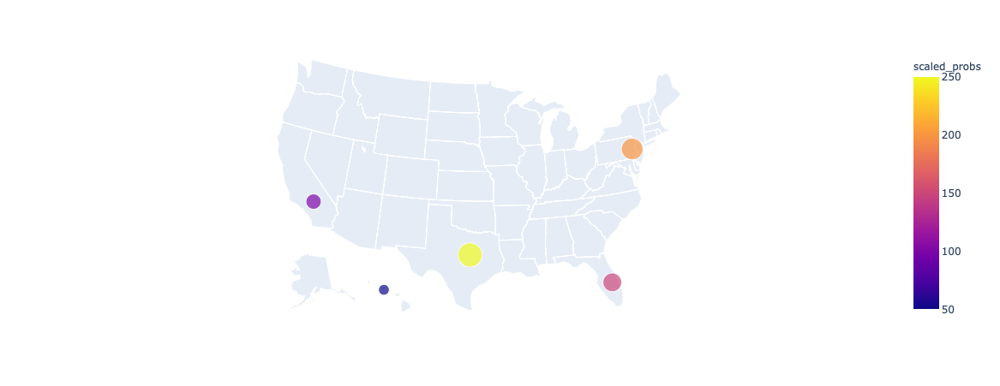

In [154]:
import plotly.express as px
fig = px.scatter_geo(locations_,
                     lat="LAT",
                     lon="LONG",
                     size="scaled_probs",
                     color="scaled_probs",
                     scope="usa"
                    )
fig.show()

In [155]:
import dill

serialized = dill.dumps(locations_)
with open("output_models/df_locations_kmeans.pkl", "wb") as explainer_sample_file:
    explainer_sample_file.write(serialized)

import dill

serialized = dill.dumps(df)
with open("output_models/df_pairplots_probabilities.pkl", "wb") as explainer_sample_file:
    explainer_sample_file.write(serialized)


Para implementar un modelo de Deep Learning utilizando PyTorch, se construyó una red neuronal básica con una única capa oculta de 10 neuronas. El modelo se entrenó durante 16 épocas, utilizando lotes (batches) de 32 muestras. Sorprendentemente, este modelo alcanzó un impresionante 91% de precisión en la tarea de clasificación.

In [156]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader,TensorDataset

A continuación, se presentan las funciones clave para el entrenamiento y la evaluación de nuestro modelo de clasificación implementado en PyTorch. La función `train_classifier` se encarga de entrenar el modelo utilizando un conjunto de datos de entrenamiento, mientras que la función `evaluate_classifier` evalúa el rendimiento del modelo en un conjunto de datos de prueba. Además, se incluye la función `predictTorch`, que utiliza el modelo entrenado para realizar predicciones en nuevos datos de prueba. Estas funciones son esenciales para el ciclo de vida del modelo, proporcionando la capacidad de entrenar, evaluar y realizar predicciones en un entorno de aprendizaje profundo con PyTorch.

In [157]:
def train_classifier(model, X_train, y_train, criterion, optimizer, train_loader):
    model.train()
    curr_loss = 0.0
    for X, y in train_loader:
        optimizer.zero_grad()
        outputs = model(X)
        loss = criterion(outputs, y)

        loss.backward()
        optimizer.step()

        curr_loss += loss.item()

    average_loss = curr_loss / len(X_train)
    return average_loss

def evaluate_classifier(model, X_test, y_test, criterion):
    model.eval()

    correct = 0
    total = 0
    curr_loss = 0.0
    predicted_labels = []
    predicted_probabilities = []

    with torch.no_grad():
        for X, y in zip(X_test, y_test):
            outputs = model(X)
            loss = criterion(outputs, y)

            probability_class_1 = torch.sigmoid(outputs).item()
            probability_class_0 = 1 - probability_class_1
            predicted_probabilities.append([probability_class_0, probability_class_1])

            predicted = round(outputs.item())
            predicted_labels.append(predicted)

            #_, predicted = torch.max(outputs.data, 1)
            predicted = round(outputs.item())

            total += y.size(0)
            correct += (predicted == y).sum().item()
            curr_loss += loss.item()
    accuracy = 100 * correct / total
    average_loss = curr_loss / len(X_test)
    return accuracy, average_loss, predicted_labels, predicted_probabilities
def predictTorch(model, X_test_t):
    outputs = []
    with torch.no_grad():
        for X in X_test_t:
            output = model(X)
            print(round(output.item()))
            outputs.append(round(output.item()))
    return outputs

In [158]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

Como se mencionó, nuestro modelo es bastante simple, con unicamente una hidden layer. 

In [159]:
class FeedFowardNetwork(nn.Module):
  def __init__(self, input_dim,output_dim, hidden_dim):
    super(FeedFowardNetwork,self).__init__()
    self.input_layer = nn.Linear(input_dim, hidden_dim)
    self.hidden_layer_1 = nn.Linear(hidden_dim, hidden_dim)
    self.output_layer = nn.Linear(hidden_dim, output_dim)
  def forward(self,x):
    x = torch.relu(self.input_layer(x))
    x = torch.relu(self.hidden_layer_1(x))
    x = torch.sigmoid(self.output_layer(x))
    return x

In [160]:
X_train_model = torch.tensor(X_train.to_numpy(), dtype=torch.float32)
X_test_model  = torch.tensor(X_test.to_numpy(), dtype=torch.float32)
y_train_model = torch.tensor(y_train.to_numpy(), dtype=torch.float32).reshape(-1, 1)
y_test_model  = torch.tensor(y_test.to_numpy(), dtype=torch.float32).reshape(-1, 1)

In [161]:
model = FeedFowardNetwork(input_dim=X.shape[1],output_dim=1,hidden_dim=10)
model.to(device)

FeedFowardNetwork(
  (input_layer): Linear(in_features=24, out_features=10, bias=True)
  (hidden_layer_1): Linear(in_features=10, out_features=10, bias=True)
  (output_layer): Linear(in_features=10, out_features=1, bias=True)
)

En la configuración del entrenamiento de nuestro modelo, hemos elegido la función de pérdida "Binary Cross Entropy Loss" (BCELoss) adecuada para un problema de clasificación binaria. Se implementó un tamaño de lote (batch size) de 32 muestras y se realizaron 16 épocas de entrenamiento. Se optó por el optimizador Adam con una tasa de aprendizaje de 0.0001. Estos parámetros se han ajustado cuidadosamente para lograr un equilibrio entre la eficiencia del entrenamiento y la precisión del modelo. Durante el entrenamiento, se monitorea y muestra el valor de la pérdida en cada época para evaluar el progreso del modelo.

In [162]:
criterion = nn.BCELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
train_dataset = TensorDataset(X_train_model, y_train_model)
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

In [163]:
num_epochs = 16
for epoch in range(num_epochs):
    train_loss = train_classifier(model, X_train_model, y_train_model, criterion, optimizer, train_loader)
    print(f"Epoch {epoch + 1}/{num_epochs} - Train Loss: {train_loss:.4f}")

Epoch 1/16 - Train Loss: 0.0132
Epoch 2/16 - Train Loss: 0.0094
Epoch 3/16 - Train Loss: 0.0089
Epoch 4/16 - Train Loss: 0.0085
Epoch 5/16 - Train Loss: 0.0082
Epoch 6/16 - Train Loss: 0.0079
Epoch 7/16 - Train Loss: 0.0078
Epoch 8/16 - Train Loss: 0.0076
Epoch 9/16 - Train Loss: 0.0075
Epoch 10/16 - Train Loss: 0.0074
Epoch 11/16 - Train Loss: 0.0074
Epoch 12/16 - Train Loss: 0.0073
Epoch 13/16 - Train Loss: 0.0072
Epoch 14/16 - Train Loss: 0.0072
Epoch 15/16 - Train Loss: 0.0071
Epoch 16/16 - Train Loss: 0.0071


In [164]:
accuracy, test_loss, predicted_labels, predicted_probabilities = evaluate_classifier(model, X_test_model, y_test_model, criterion)
print(f"Test Accuracy: {accuracy:.2f}% - Test Loss: {test_loss:.4f}")

Test Accuracy: 91.20% - Test Loss: 0.2293


Se ha obtenido un 91% de score. El modelo tiende a predecir clientes fuear, como clientes retenidos; esto se puede deber a un desbalanceo entre las clases.

Accuracy score: 0.91
Churned precision: 0.86
Churned recall: 0.73
Retained precision: 0.92
Retained recall: 0.96


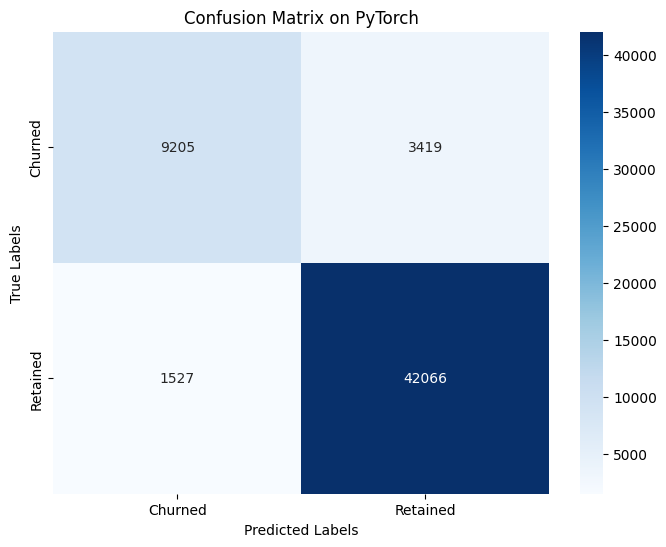

In [165]:
eval_predictions(predicted_labels, y_test_model, title="Confusion Matrix on PyTorch")

## Logistic Regression

Al momento de entrenar nuestro modelo, pudimos observar que un atributo, `MONTO_ANTERIOR`, explicaba casi por completo nuestro target. Es por eso que decidimos aplicar un modelo de regresión logística utilizando sólamente esta variable. 

In [166]:
from sklearn.linear_model import LogisticRegression

In [167]:
X_train, X_test, y_train, y_test = train_test_split(X_lr["MONTO_ANTERIOR"], y, test_size=0.2, random_state=2)

In [168]:
logistic_regression = LogisticRegression(random_state=0)
logistic_regression.fit(X_train.values.reshape(-1, 1), y_train)
y_pred=logistic_regression.predict(X_test.values.reshape(-1, 1))

In [169]:
from sklearn.metrics import accuracy_score
accuracy=accuracy_score(y_pred, y_test)
print('Logistic Regression Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred)))

Logistic Regression Model accuracy score: 0.9992


In [170]:
np.unique(y_test, return_counts=True)

(array([0, 1]), array([12624, 43593]))

Accuracy score: 1.00
Churned precision: 1.00
Churned recall: 1.00
Retained precision: 1.00
Retained recall: 1.00


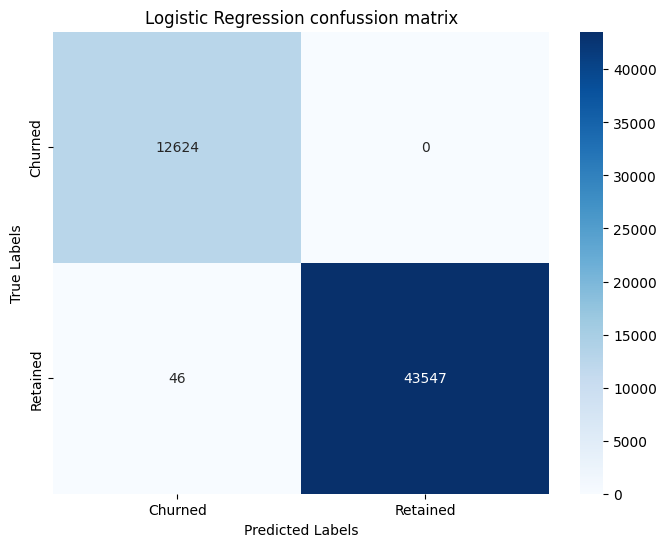

In [171]:
eval_predictions(y_pred, y_test, title="Logistic Regression confussion matrix")

Podemos observar que, aunque no son perfectos, los resultados son bastante positivos. Esto nos indica que sólamente este atributo es capaz de predecir con una precisón considerable nuestro target. Sin embargo, no consideramos qu eeste atributo sea del todo fiable: su comportamiento nos podría indicar de algun tipo de erro en nuestro dataset, algo que pudimos observar anteriormente. Es por eso que, para entrenar el modelo de predicción final, decidimos eliminar este atributo.

## AutoML

In [174]:
df = raw_df.loc[:,~raw_df.columns.duplicated()].copy()
X_train, X_test, y_train, y_test = train_test_split(df.drop(["FLAG_CLIENTE_ACTIVO"], axis=1), df["FLAG_CLIENTE_ACTIVO"], test_size=0.2, random_state=2)

In [175]:
est1 = automl.Pipeline(task='classification')
est1.fit(X_train, y_train)

[2023-11-27 19:55:21,412] [automl.pipeline] Random state (7) is used for model builds
[2023-11-27 19:55:23,082] [automl.pipeline] Dataset shape: (306479, 41)
[2023-11-27 19:55:23,113] [automl.pipeline] Running Auto-Preprocessing
[2023-11-27 19:55:28,237] [automl.pipeline] Preprocessing completed. Updated Dataset shape: (306479, 57), cv: 5
[2023-11-27 19:55:28,598] [automl.pipeline] SVC, KNeighborsClassifier are disabled for datasets with > 10K samples or > 1K features
[2023-11-27 19:55:28,599] [automl.pipeline] Running Model Selection
[2023-11-27 19:56:37,212] [automl.pipeline] Model Selection completed. Selected model: ['RandomForestClassifier']
[2023-11-27 19:56:37,216] [automl.pipeline] Running Adaptive Sampling. Dataset Shape: (306479, 57), Valid Shape: None, CV: 5, Class counts: [116221 190258]
[2023-11-27 19:58:56,883] [automl.pipeline] Adaptive Sampling Completed. Updated Dataset Shape: (306479, 57), Valid Shape: None, CV: [(122966, 61296), (122966, 61296), (122966, 61296), (122

Pipeline(model_list=['DecisionTreeClassifier', 'ExtraTreesClassifier',
                     'GaussianNB', 'LGBMClassifier', 'LogisticRegression',
                     'RandomForestClassifier', 'SVC', 'XGBClassifier',
                     'TorchMLPClassifier', 'CatBoostClassifier'])

In [176]:
y_proba = est1.predict_proba(X_test)
score_default = roc_auc_score(y_test, y_proba[:, 1])

print(f'Score on test data : {score_default}')

Score on test data : 0.9999998853480392


In [177]:
X_train

,FECHA_ALTA,CANTIDAD_RECARGAS_MES,MONTO_RECARGADO_MES,MONTO_ANTERIOR,MONTO_POSTERIOR,SALDO_TOTAL,FLAG_CON_SALDO,SUM_CANTIDAD_RECARGAS,SUM_MONTO_RECARGAS,AVG_CANTIDAD_RECARGAS,AVG_MONTO_RECARGAS,MIN_CANTIDAD_RECARGAS,MIN_MONTO_RECARGAS,MAX_CANTIDAD_RECARGAS,MAX_MONTO_RECARGAS,DIAS_FRECUENCIA_RECARGA,SUM_SS_TRAFICO_LOCAL_ONNET,SUM_SS_TRAFICO_LOCAL_OFFNET,SUM_SS_TRAFICO_LOCAL,SUM_SS_TRAFICO_INTERNACIONAL,SUM_SS_TRAFICO_IVR,SUM_SE_ROAMING,SUM_SS_ROAMING,SUM_SS_TOTAL,SUM_ESC_TRAFICO_LOCAL_VOZ,SUM_ESC_TRAFICO_INTERNACIONAL_VOZ,SUM_ESC_TRAFICO_IVR_VOZ,SUM_ESC_ROAMING_ENTRANTE_VOZ,SUM_ESC_ROAMING_SALIENTE_VOZ,SUM_ESC_FAMILIA_Y_AMIGOS_VOZ,DNI,STORE,LATITTUDE,LONGITUDE,AGE,GENDER,EMPLYEE_STATUS,MARITAL_STATUS,IMEI,MANUFACTURER,MODEL
16739,2016-07-27 14:15:00,6,26,26,0,0,1,22,93,5.50,23,4,19,7,26,5.948718,2722,85,2807,0,128,0,0,2935,21,0,85,0,0,0,XJ82419613,"550 Lawrence Expy, Sunnyvale, CA 94086, United States",37.385495,-121.995421,45,FEMALE,Unemployment,Single,114988200,Research In Motion,MX
278776,2023-02-08 09:46:00,1,11,41,0,0,1,5,52,2.50,26,1,11,4,41,7.333333,0,115,115,0,1258,0,0,1373,2,0,33,0,0,0,QS43652015,"621 Broadway, Newark, NJ 07104, United States",40.771910,-74.161475,26,FEMALE,self-employed,Married,102775000,Motorola,M930 NA DB
47031,2019-01-22 16:15:00,2,7,22,0,4,1,12,43,3.00,11,1,4,6,22,13.647059,1167,2225,3392,0,1618,0,0,5010,56,0,98,0,0,0,BH91070098,2476 Kalï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½ï¿½,NaN,NaN,71,FEMALE,employee,Widow,35068269,Mitsubishi,G410
373199,2023-03-29 09:02:00,1,17,0,0,2,1,1,17,1.00,17,1,17,1,17,9999.000000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,CF85900627,"5920 Balboa Ave, San Diego, CA 92111, United States",32.820654,-117.178011,74,MALE,self-employed,Married,108591100,Mitsubishi,G410
106888,2021-01-22 15:13:00,4,15,34,0,1,1,21,82,5.25,21,4,15,8,34,6.555556,36958,11084,48042,0,2920,0,0,50962,429,0,211,0,0,0,EN71972772,"550 Lawrence Expy, Sunnyvale, CA 94086, United States",37.385495,-121.995421,39,FEMALE,self-employed,Married,115649300,Compal Com Inc,Artema Mobile Secure GPRS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84434,2020-06-16 17:21:00,1,19,0,0,11,1,3,30,1.50,15,1,11,2,19,30.142857,295,2298,2593,0,0,0,0,2593,46,0,9,0,0,0,RW29929602,"702-2 Haddonfield-Berlin Rd, Voorhees Township, NJ 08043, United States",39.852059,-74.981099,61,FEMALE,employee,Widow,35348005,Nortel,ALCATEL OT
95816,2020-10-19 17:29:00,7,52,93,0,7,1,41,269,10.25,67,7,49,14,93,4.068966,119,6944,7063,0,407,0,0,7470,76,0,19,0,0,0,VS62909295,"210 5th S, Salt Lake City, UT 84106, United States",40.759057,-111.897383,24,MALE,self-employed,Married,52012400,Sony,LMU
203245,2022-08-23 16:38:00,5,17,56,0,0,1,8,73,4.00,36,3,17,5,56,105.500000,3984,1831,5815,0,46,0,0,5861,33,0,18,0,0,0,EY70519586,"621 Broadway, Newark, NJ 07104, United States",40.771910,-74.161475,75,MALE,Unemployment,Single,106052700,Sanyo,AGM 1100
100879,2020-12-04 19:14:00,4,15,22,0,0,1,18,67,4.50,17,4,15,6,22,8.642857,6612,5433,12045,0,440,0,0,12485,260,0,90,0,0,0,FB17810931,"8500 US-290, Austin, TX 78724, United States",30.329135,-97.660629,45,FEMALE,Unemployment,Single,104433600,Mitsubishi,G410


In [178]:
est1.print_summary()

Training Dataset size,"(306479, 41)"
Validation Dataset size,None
CV,5
Optimization Metric,neg_log_loss
Selected Features,"Index(['FECHA_ALTA__year', 'FECHA_ALTA__month', 'FECHA_ALTA__midnight', 'FECHA_ALTA', 'CANTIDAD_RECARGAS_MES', 'MONTO_RECARGADO_MES', 'MONTO_ANTERIOR', 'FLAG_CON_SALDO', 'SUM_CANTIDAD_RECARGAS', 'SUM_MONTO_RECARGAS', 'AVG_CANTIDAD_RECARGAS', 'AVG_MONTO_RECARGAS', 'MIN_CANTIDAD_RECARGAS', 'MIN_MONTO_RECARGAS', 'MAX_CANTIDAD_RECARGAS', 'MAX_MONTO_RECARGAS', 'DIAS_FRECUENCIA_RECARGA', 'SUM_SS_TRAFICO_LOCAL_ONNET', 'SUM_SS_TRAFICO_LOCAL_OFFNET', 'SUM_SS_TRAFICO_LOCAL', 'SUM_SS_TRAFICO_INTERNACIONAL', 'SUM_SS_TRAFICO_IVR', 'SUM_SS_ROAMING', 'SUM_SS_TOTAL', 'SUM_ESC_TRAFICO_LOCAL_VOZ', 'SUM_ESC_TRAFICO_INTERNACIONAL_VOZ', 'SUM_ESC_TRAFICO_IVR_VOZ', 'SUM_ESC_ROAMING_SALIENTE_VOZ'], dtype='object')"
Selected Algorithm,RandomForestClassifier
Time taken,2465.478
Selected Hyperparameters,"{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': 'balanced_subsample', 'criterion': 'gini', 'max_depth': None, 'max_features': 0.777777778, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 0.00012959530225978096, 'min_samples_split': 0.00125, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 101, 'n_jobs': 1, 'oob_score': False, 'random_state': 7, 'verbose': 0, 'warm_start': False}"
AutoML version,23.2.2
Python version,"3.8.18 | packaged by conda-forge | (default, Oct 10 2023, 15:44:36) \n[GCC 12.3.0]"


Algorithm,#Samples,#Features,Mean Validation Score,Hyperparameters,CPU Time,Memory Usage (GB)
RandomForestClassifier_HT,306479,28,-0.0003,"{'class_weight': 'balanced_subsample', 'max_features': 0.777777778, 'min_samples_leaf': 0.00012959530225978096, 'min_samples_split': 0.00125, 'n_estimators': 101}",83.0087,"(0.044586181640625, None)"
RandomForestClassifier_HT,306479,28,-0.0003,"{'class_weight': 'balanced_subsample', 'max_features': 0.777777778, 'min_samples_leaf': 0.00012959530225978096, 'min_samples_split': 0.00125, 'n_estimators': 100}",82.2638,"(0.044586181640625, None)"
RandomForestClassifier_HT,306479,28,-0.0003,"{'max_features': 0.777777778, 'min_samples_leaf': 0.00012959530225978096, 'min_samples_split': 0.00125, 'n_estimators': 101, 'class_weight': 'balanced'}",64.6128,"(0.044586181640625, None)"
RandomForestClassifier_HT,306479,28,-0.0003,"{'class_weight': 'balanced', 'max_features': 0.777777778, 'min_samples_leaf': 0.00012959530225978096, 'min_samples_split': 0.001248112077741688, 'n_estimators': 100}",64.3230,"(0.044586181640625, None)"
RandomForestClassifier_HT,306479,28,-0.0003,"{'class_weight': None, 'max_features': 0.777777778, 'min_samples_leaf': 0.00012959530225978096, 'min_samples_split': 0.00125, 'n_estimators': 100}",63.9872,"(0.044586181640625, None)"
...,...,...,...,...,...,...
RandomForestClassifier_HT,306479,28,-0.2613,"{'class_weight': None, 'max_features': 0.03571428571428571, 'min_samples_leaf': 3.2628662975277263e-06, 'min_samples_split': 0.06376874369152977, 'n_estimators': 5}",1.5604,"(0.0, None)"
RandomForestClassifier_ANOVAF_FS,306479,1,-0.2948,"{'n_estimators': 100, 'class_weight': 'balanced', 'max_features': 0.777777778, 'min_samples_leaf': 0.000625, 'min_samples_split': 0.00125}",47.9471,0.0
LogisticRegression_AS,15324,57,-0.6930,"{'C': 1.0, 'class_weight': 'balanced', 'solver': 'liblinear'}",0.4535,0.0
GaussianNB_AS,15324,57,-0.6934,{},0.3856,0.0


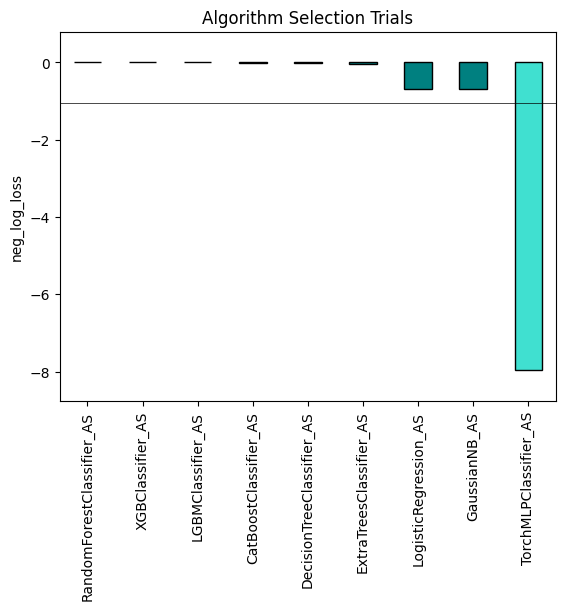

In [179]:
trials = est1.model_selection_trials_
colors = []
scores = [x[3] for x in trials]
models = [x[0] for x in trials]
y_margin = 0.10 * (max(scores) - min(scores))
s = pd.Series(scores, index=models).sort_values(ascending=False)

for f in s.keys():
    if f == '{}_AS'.format(est1.selected_model_):
        colors.append('orange')
    elif s[f] >= s.mean():
        colors.append('teal')
    else:
        colors.append('turquoise')
        

fig, ax = plt.subplots(1)
ax.set_title("Algorithm Selection Trials")
ax.set_ylim(min(scores) - y_margin, max(scores) + y_margin)
ax.set_ylabel(est1.inferred_score_metric[0])
s.plot.bar(ax=ax, color=colors, edgecolor='black')
ax.axhline(y=s.mean(), color='black', linewidth=0.5)
plt.show()

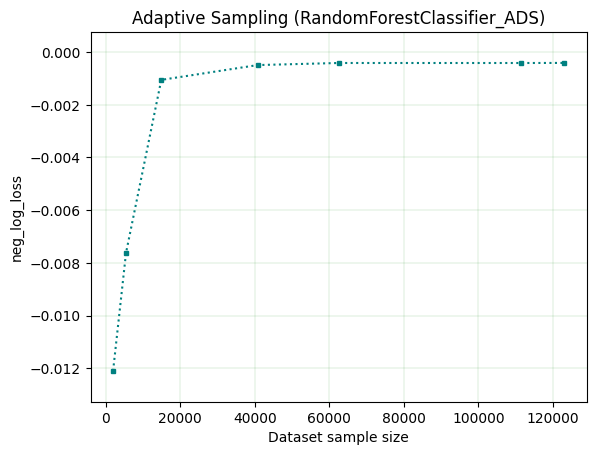

In [180]:
trials = est1.adaptive_sampling_trials_
scores = [x[3] for x in trials]
n_samples = [x[1] for x in trials]
y_margin = 0.10 * (max(scores) - min(scores))

fig, ax = plt.subplots(1)
ax.set_title("Adaptive Sampling ({})".format(trials[0][0]))
ax.set_xlabel('Dataset sample size')
ax.set_ylabel(est1.inferred_score_metric[0])
ax.grid(color='g', linestyle='-', linewidth=0.1)
ax.set_ylim(min(scores) - y_margin, max(scores) + y_margin)
ax.plot(n_samples, scores, 'k:', marker="s", color='teal', markersize=3)
plt.show()

Features selected: ['FECHA_ALTA__year', 'FECHA_ALTA__month', 'FECHA_ALTA__midnight', 'FECHA_ALTA', 'CANTIDAD_RECARGAS_MES', 'MONTO_RECARGADO_MES', 'MONTO_ANTERIOR', 'FLAG_CON_SALDO', 'SUM_CANTIDAD_RECARGAS', 'SUM_MONTO_RECARGAS', 'AVG_CANTIDAD_RECARGAS', 'AVG_MONTO_RECARGAS', 'MIN_CANTIDAD_RECARGAS', 'MIN_MONTO_RECARGAS', 'MAX_CANTIDAD_RECARGAS', 'MAX_MONTO_RECARGAS', 'DIAS_FRECUENCIA_RECARGA', 'SUM_SS_TRAFICO_LOCAL_ONNET', 'SUM_SS_TRAFICO_LOCAL_OFFNET', 'SUM_SS_TRAFICO_LOCAL', 'SUM_SS_TRAFICO_INTERNACIONAL', 'SUM_SS_TRAFICO_IVR', 'SUM_SS_ROAMING', 'SUM_SS_TOTAL', 'SUM_ESC_TRAFICO_LOCAL_VOZ', 'SUM_ESC_TRAFICO_INTERNACIONAL_VOZ', 'SUM_ESC_TRAFICO_IVR_VOZ', 'SUM_ESC_ROAMING_SALIENTE_VOZ']
Features dropped: ['FECHA_ALTA__day', 'FECHA_ALTA__weekday', 'FECHA_ALTA__holiday', 'FECHA_ALTA__hour', 'FECHA_ALTA__minute', 'FECHA_ALTA__second', 'FECHA_ALTA__microsecond', 'FECHA_ALTA__morning', 'FECHA_ALTA__evening', 'FECHA_ALTA__night', 'SALDO_TOTAL', 'SUM_SE_ROAMING', 'SUM_ESC_ROAMING_ENTRANTE_VOZ

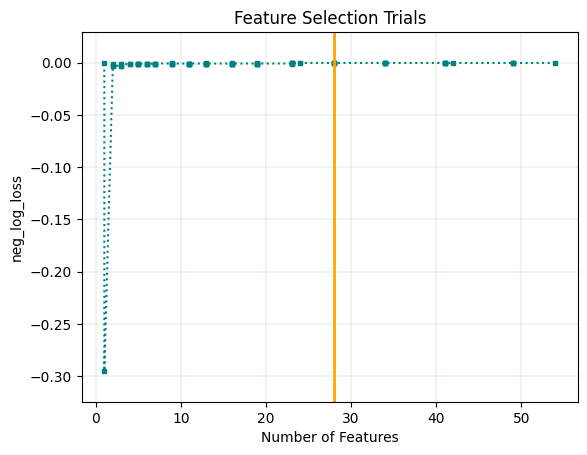

In [181]:
print(f"Features selected: {est1.selected_features_names_.to_list()}")
dropped_features = est1.pipeline.preprocessor.transformed_col_names.drop(est1.selected_features_names_)
print(f"Features dropped: {dropped_features.to_list()}")

# Each trial is a tuple of
# (algorithm, no. samples, no. features, mean CV score, hyperparameters, 
# all CV scores, total CV time (s), memory usage (Gb))
trials = est1.feature_selection_trials_
scores = [x[3] for x in trials]
n_features = [x[2] for x in trials]
y_margin = 0.10 * (max(scores) - min(scores))


fig, ax = plt.subplots(1)
ax.set_title("Feature Selection Trials")
ax.set_xlabel("Number of Features")
ax.set_ylabel(est1.inferred_score_metric[0])
ax.grid(color='g', linestyle='-', linewidth=0.1)
ax.set_ylim(min(scores) - y_margin, max(scores) + y_margin)
ax.plot(n_features, scores, 'k:', marker="s", color='teal', markersize=3)
ax.axvline(x=len(est1.selected_features_names_), color='orange', linewidth=2.0)
plt.show()

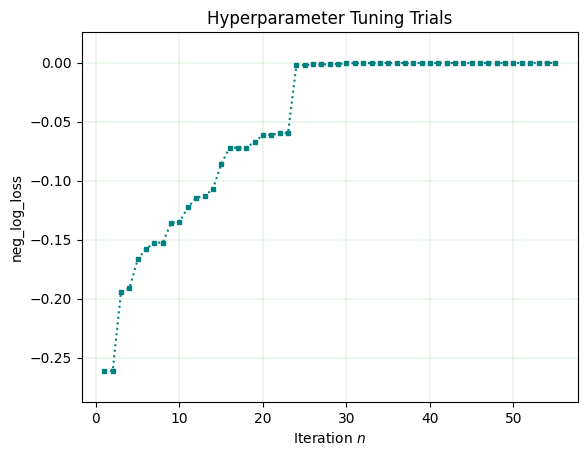

In [182]:
trials = est1.tuning_trials_
scores = [x[3] for x in reversed(trials)]
y_margin = 0.10 * (max(scores) - min(scores))


fig, ax = plt.subplots(1)
ax.set_title("Hyperparameter Tuning Trials")
ax.set_xlabel("Iteration $n$")
ax.set_ylabel(est1.inferred_score_metric[0])
ax.grid(color='g', linestyle='-', linewidth=0.1)
ax.set_ylim(min(scores) - y_margin, max(scores) + y_margin)
ax.plot(range(1, len(trials) + 1), scores, 'k:', marker="s", color='teal', markersize=3)
plt.show()

Text(50.722222222222214, 0.5, 'Actual')

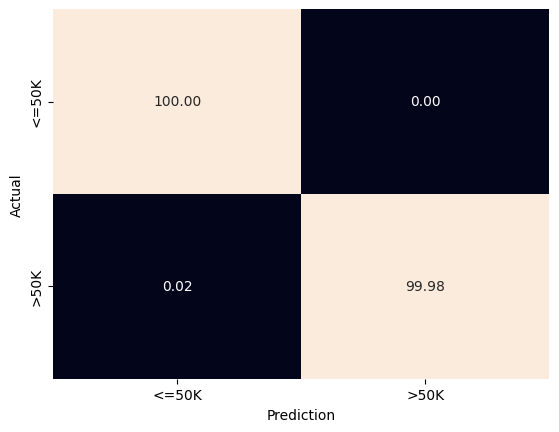

In [183]:
y_pred = est1.predict(X_test)
cm = confusion_matrix(y_test.astype(int), y_pred, labels=[False, True])
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

df_cm = pd.DataFrame(cm)
df_cm = df_cm * 100

ax = sns.heatmap(df_cm, annot=True, fmt='.2f', cbar=False, 
                 xticklabels=['<=50K', '>50K'], yticklabels=['<=50K', '>50K'])
ax.set_xlabel('Prediction')
ax.set_ylabel('Actual')

In [184]:
joblib.dump(est1, 'est1_19_oct_1_35_am.pkl')

['est1_19_oct_1_35_am.pkl']